In [491]:
import pandas as pd
import numpy as np
import pickle
import warnings
import operator
from mapping import mapping
warnings.filterwarnings('ignore')

# 2012 Data

In [674]:
f = open("./final_data2011.p", "rb")
data = pickle.load(f)

X = data.ix[:, 14:]

del X["Population"]
del X['Total Born In State education']
del X['Born in Other State Education']
del X['Total Reporting Income']
del X['Total In Poverty Pool']
del X['Total Moving']
del X['Total Means of Transportation Work']

X = X.apply(lambda x: x / data["Population"] * 100)
y = [1 if x else 0 for x in data["dem_2012"] > data["gop_2012"]]


In [385]:
f = open("./final_data.p", "rb")
data2014 = pickle.load(f)

X_2014 = data2014.ix[:, 14:]

del X_2014["Population"]
del X_2014['Total Born In State education']
del X_2014['Born in Other State Education']
del X_2014['Total Reporting Income']
del X_2014['Total In Poverty Pool']
del X_2014['Total Moving']
del X_2014['Total Means of Transportation Work']

X_2014 = X_2014.apply(lambda x: x / data2014["Population"] * 100)
y_2014 = [1 if x else 0 for x in data2014["dem_2016"] > data2014["gop_2016"]]

### Fitting Clustering Techniques

In [386]:
from helper import *
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn import metrics
from sklearn.linear_model import ElasticNetCV
from sklearn.linear_model import LogisticRegressionCV

In [387]:
random_state = 100

Basis expansion 2, then run kmeans 2 cluster

In [388]:
X_test = basis_expansion(X, 2)
y_pred = KMeans(n_clusters=2, random_state=random_state).fit_predict(X_test)
hit = 0
for control, predicted in zip (y, y_pred):
    if control == predicted:
        hit+=1
accuracy = hit / len(y)
print('accuracy', accuracy)

accuracy 0.7728571428571429


In [389]:
y_pred = KMeans(n_clusters=2, random_state=random_state).fit_predict(X)

hit = 0
for control, predicted in zip (y, y_pred):
    if control == predicted:
        hit+=1
accuracy = hit / len(y)
print('accuracy', accuracy)

accuracy 0.22892857142857143


Elastic net to get features

In [390]:
elasticNet = ElasticNetCV(cv=3)
elasticNet.fit(X, y)

ElasticNetCV(alphas=None, copy_X=True, cv=3, eps=0.001, fit_intercept=True,
       l1_ratio=0.5, max_iter=1000, n_alphas=100, n_jobs=1,
       normalize=False, positive=False, precompute='auto',
       random_state=None, selection='cyclic', tol=0.0001, verbose=0)

Using ElasticNet variables

In [391]:
selectedVariables = [i for i, e in enumerate(elasticNet.coef_) if e != 0]
X_lasso = X[selectedVariables]
y_pred = KMeans(n_clusters=2, random_state=random_state).fit_predict(X_lasso)

hit = 0
for control, predicted in zip (y, y_pred):
    if control == predicted:
        hit+=1
accuracy = hit / len(y)
print('accuracy', accuracy)

accuracy 0.22892857142857143


In [392]:
y_dbscan = DBSCAN(eps=2,min_samples=1000).fit(X_lasso)
core_samples_mask = np.zeros_like(y_dbscan.labels_, dtype=bool)
core_samples_mask[y_dbscan.core_sample_indices_] = True
labels = y_dbscan.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of clusters: %d' % n_clusters_)
print("Homogeneity: %0.3f" % metrics.homogeneity_score(y, labels))
print("Completeness: %0.3f" % metrics.completeness_score(y, labels))
print("V-measure: %0.3f" % metrics.v_measure_score(y, labels))
print("Adjusted Rand Index: %0.3f"
      % metrics.adjusted_rand_score(y, labels))
print("Adjusted Mutual Information: %0.3f"
      % metrics.adjusted_mutual_info_score(y, labels))

Estimated number of clusters: 0
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000


In [524]:
logistic = LogisticRegressionCV(cv=10)
y_pred = logistic.fit_transform(X_lasso, y)

avg = []
for group in logistic.scores_[1]:
    avg.append(np.average(group))
print("Average Accuracy for Logistic Regression:", np.average(avg))

Average Accuracy for Logistic Regression: 0.879305475835


In [526]:
vals2 = dict()
for col, coef in zip(X_lasso.columns, logistic.coef_[0]) :
    vals2[col] = coef
sorted_vals2 = sorted(vals2.items(), key=operator.itemgetter(1))
for item in sorted_vals2:
    print('%-50s %f' % (item[0], item[1]))

Currently Married                                  -0.317283
Moved Within Same State                            -0.280607
Other State-HS or equal                            -0.252629
Less Than HS                                       -0.234204
Graduate                                           -0.164781
Total Reporing 0 Income                            -0.137280
# White Not Hispanic                               -0.097915
2 vehicles                                         -0.087223
Same house 1 year ago                              -0.070133
Median Income                                      -0.004497
Median Income Born Outside US: Native              -0.001337
Median Income Born Other State                     0.000057
Median Income Foreign Born                         0.000827
Median Income Born In State                        0.001208
Same house 1 year ago White                        0.037653
100% below povery line                             0.069505
Work outside County          

2014 Data

In [792]:
elasticNet = ElasticNetCV(cv=3)
elasticNet.fit(X_2014, y_2014)

ElasticNetCV(alphas=None, copy_X=True, cv=3, eps=0.001, fit_intercept=True,
       l1_ratio=0.5, max_iter=1000, n_alphas=100, n_jobs=1,
       normalize=False, positive=False, precompute='auto',
       random_state=None, selection='cyclic', tol=0.0001, verbose=0)

In [793]:
selectedVariables = [i for i, e in enumerate(elasticNet.coef_) if e != 0]
X_elastic = X_2012[selectedVariables]

In [795]:
logistic = LogisticRegressionCV(cv=10)
y_pred = logistic.fit(X_elastic, y_2012)

avg = []
for group in logistic.scores_[1]:
    avg.append(np.average(group))
print("Average Accuracy for Logistic Regression:", np.average(avg))

Average Accuracy for Logistic Regression: 0.879492595569


In [797]:
y_pred_2014 = logistic.predict(X_2014[selectedVariables])
logistic.score(X_2014[selectedVariables], y_2014)

0.908675799086758

In [821]:
logistic_prediction = pd.DataFrame()

In [822]:
logistic_prediction['Predicted 2014'] = y_pred_2014

In [823]:
logistic_prediction['Actual 2014'] = y_2014

In [824]:
logistic_prediction['fips_code'] = data['fips_code']

In [825]:
logistic_prediction = logistic_prediction[logistic_prediction['Predicted 2014'] != logistic_prediction['Actual 2014']]

In [868]:
logistic_prediction = pd.merge(logistic_prediction, fips, on='fips_code')

In [841]:
fips_state = pd.read_csv("./data401-project4/state.txt", delimiter="|")

In [870]:
fips_state.columns = ['ST', 'ABBR', 'NAME', 'ENS']

In [878]:
fips_state['ST'] = fips_state['ST'].astype('str')

In [879]:
logistic_pd.merge(logistic_prediction, fips_state, on='ST')

,Predicted 2014,Actual 2014,fips_code,ST,COUNTY,ABBR,NAME,ENS
0,0,1,48389,48,389,TX,Texas,1779801
1,1,0,48417,48,417,TX,Texas,1779801
2,0,1,48165,48,165,TX,Texas,1779801
3,1,0,48225,48,225,TX,Texas,1779801
4,1,0,48493,48,493,TX,Texas,1779801
5,1,0,48163,48,163,TX,Texas,1779801
6,0,1,48289,48,289,TX,Texas,1779801
7,1,0,48385,48,385,TX,Texas,1779801
8,1,0,48293,48,293,TX,Texas,1779801
9,1,0,48259,48,259,TX,Texas,1779801


In [ ]:
sns.countplot(y=states['NAME'])
plt.title("Counties Misclassified in Given State")
plt.show()

In [531]:
vals = dict()
for col, coef in zip(X_elastic.columns, logistic.coef_[0]) :
    vals[col] = coef
sorted_vals = sorted(vals.items(), key=operator.itemgetter(1))
for item in sorted_vals:
    print('%-50s %f' % (item[0], item[1]))

Less Than HS                                       -0.265917
# White Not Hispanis Female                        -0.262218
Moved Within Same State                            -0.246613
Moved From Different State                         -0.219069
Born Other State at/above 1.5X poverty line        -0.208518
Total Reporing 0 Income                            -0.191759
Income > 75K                                       -0.181936
Currently Married                                  -0.168618
No Vehicle Owned                                   -0.156645
Same house 1 year ago                              -0.090056
Graduate                                           -0.063102
Work in County                                     -0.043940
Bachelor                                           -0.039522
In State-HS or equal                               -0.029615
# Hispanic                                         -0.010952
# White Not Hispanic                               -0.008495
Median Income           

In [561]:
temp = pd.DataFrame(sorted_vals)
temp.columns = ["Field", "2016_coef"]

In [562]:
temp2 = pd.DataFrame(sorted_vals2)
temp2.columns = ["Field", "2012_coef"]

In [564]:
merged = pd.merge(temp, temp2, on="Field", how='outer')

In [596]:
merged = merged.fillna(0)
merged['diff'] = merged['2016_coef'] - merged['2012_coef']

In [598]:
changedList=[]
for name, val in zip(merged['Field'], np.sign(merged['2012_coef']) != np.sign(merged['2016_coef'])):
    if val:
        changedList.append(name)

In [607]:
merged[merged['Field'].isin(changedList)]

,Field,2016_coef,2012_coef,diff
1,# White Not Hispanis Female,-0.262218,0.000000,-0.262218
3,Moved From Different State,-0.219069,0.000000,-0.219069
4,Born Other State at/above 1.5X poverty line,-0.208518,0.000000,-0.208518
6,Income > 75K,-0.181936,0.000000,-0.181936
8,No Vehicle Owned,-0.156645,0.000000,-0.156645
11,Work in County,-0.043940,0.000000,-0.043940
12,Bachelor,-0.039522,0.000000,-0.039522
13,In State-HS or equal,-0.029615,0.000000,-0.029615
14,# Hispanic,-0.010952,0.000000,-0.010952
17,1-1.5X of poverty line,-0.005140,0.000000,-0.005140


Plotting each variables for clustering

In [396]:
import matplotlib.pyplot as plt
import itertools

In [397]:
selected = list(itertools.combinations(list(X[selectedVariables].columns), 2))

('# of Housing Units', '# White Not Hispanic')


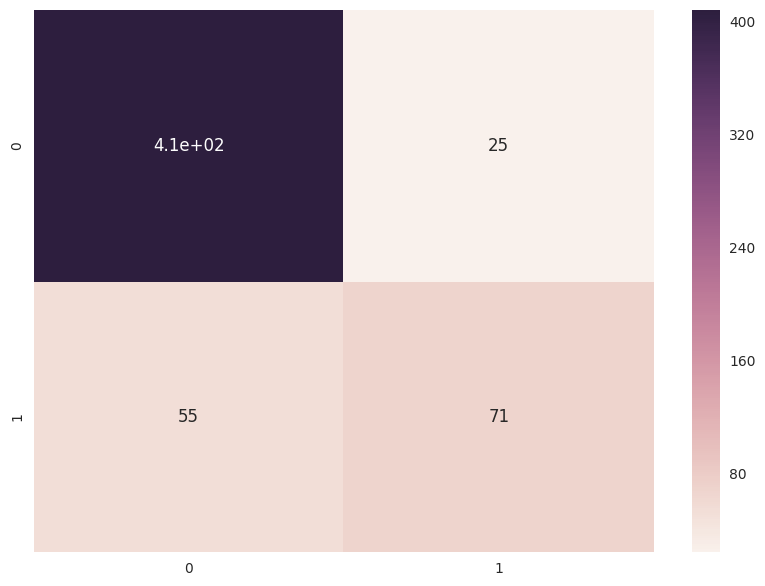

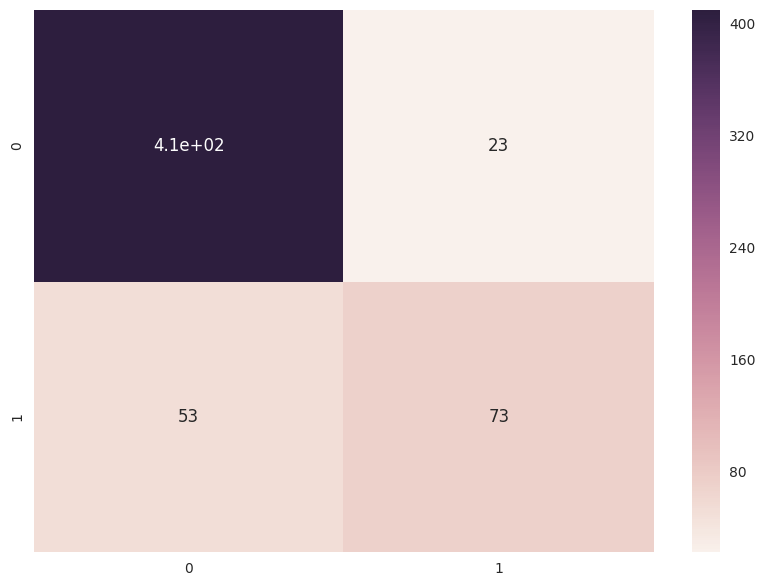

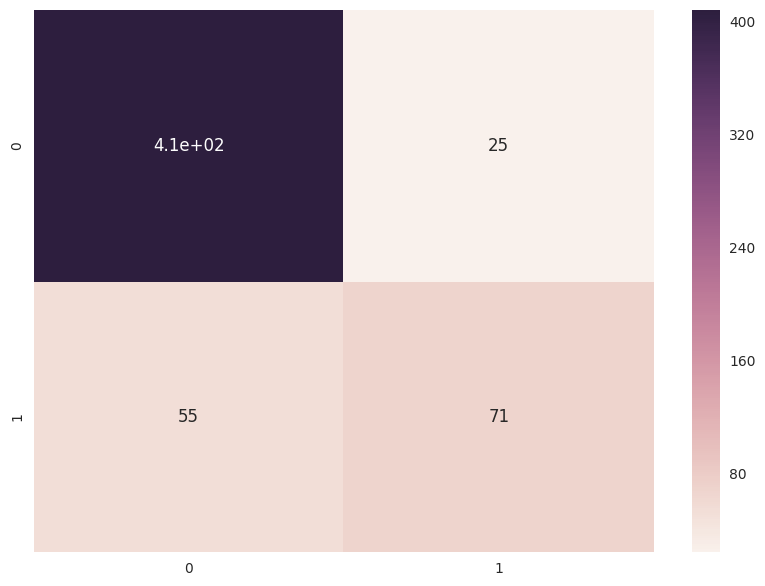

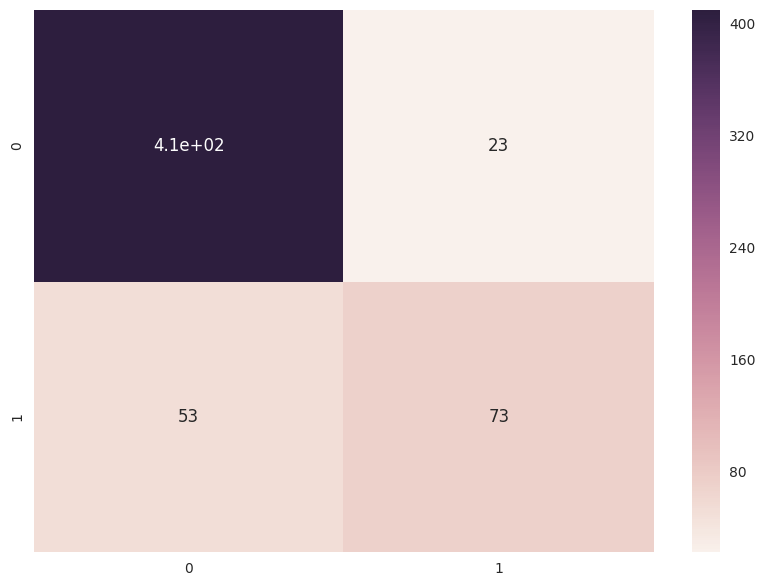

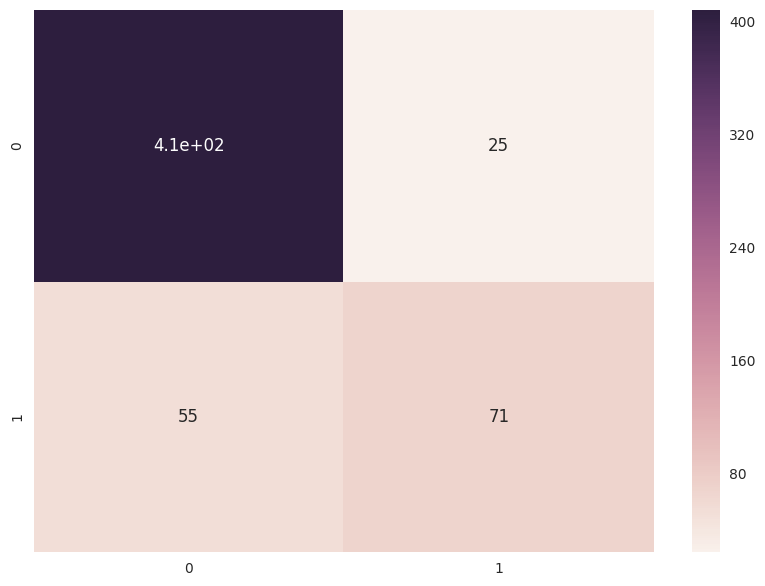

...

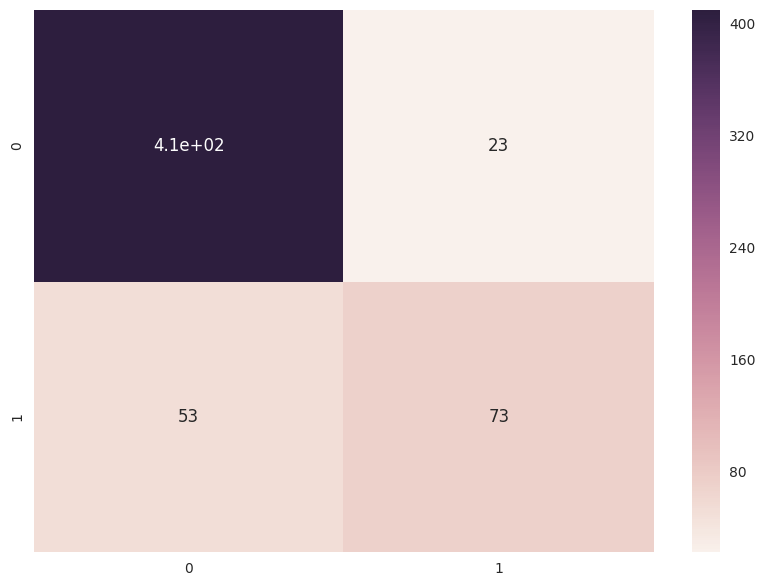

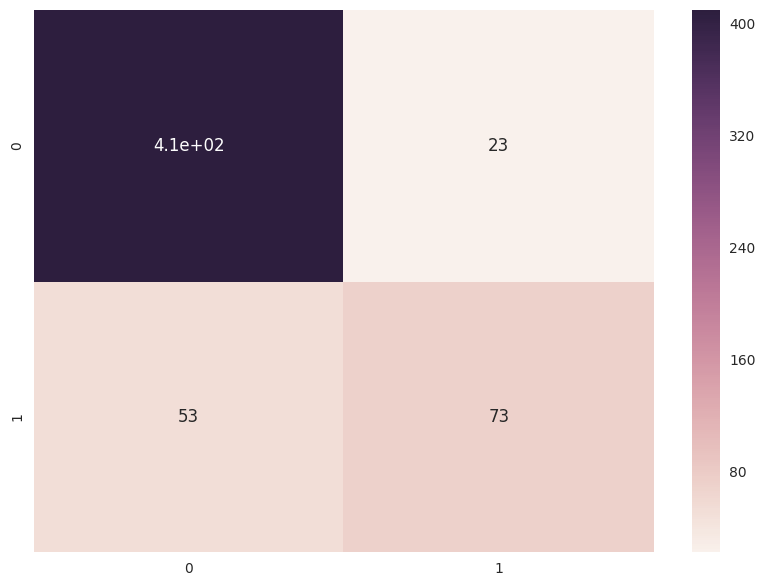

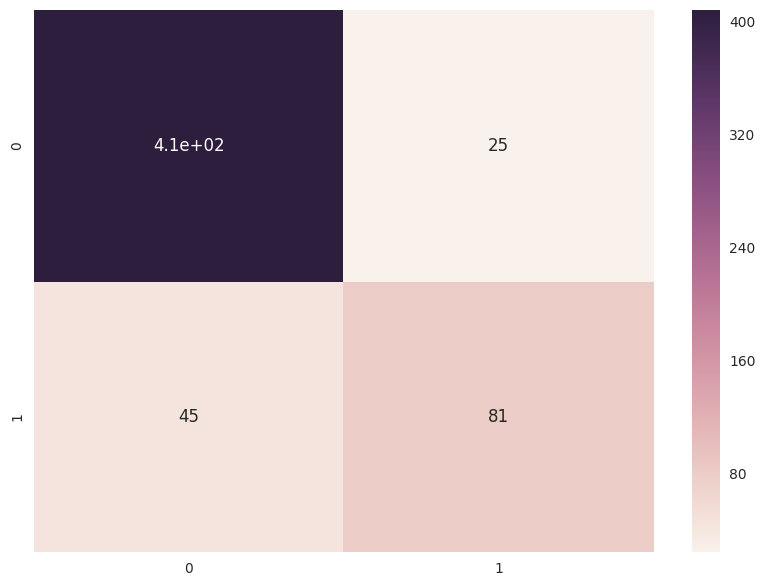

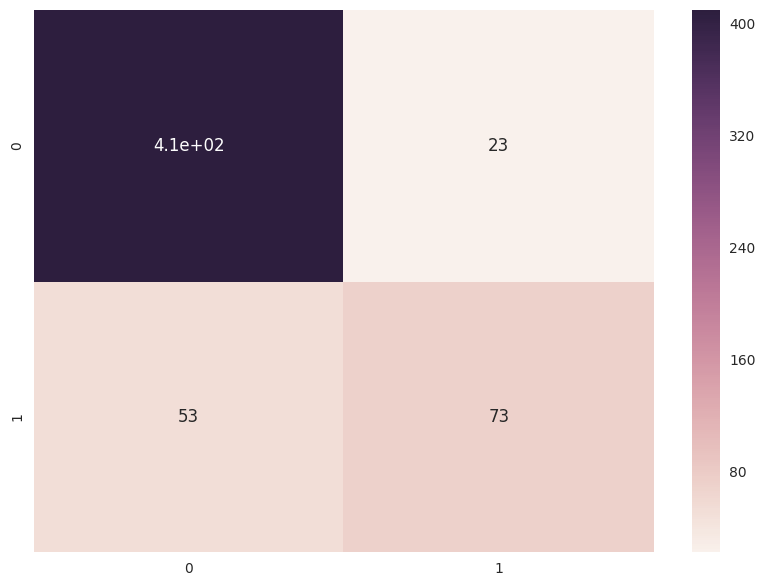

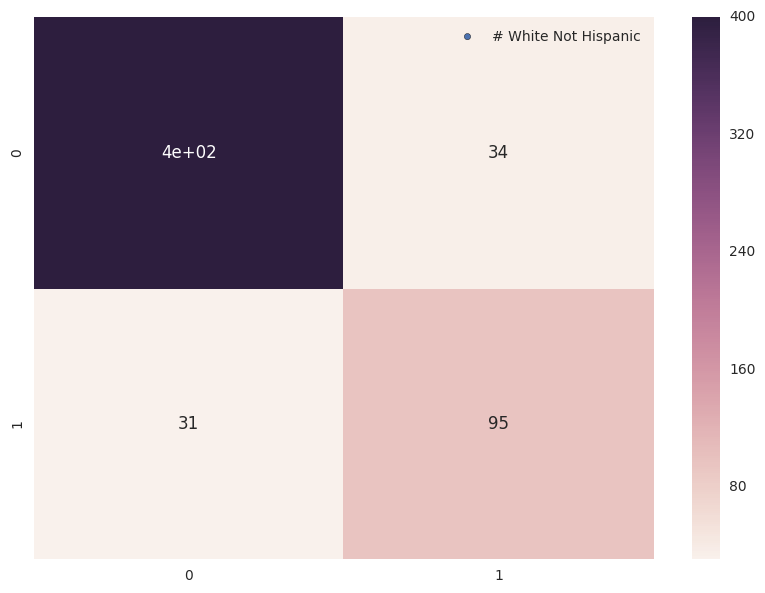

('# of Housing Units', 'Citizen by Naturalization')


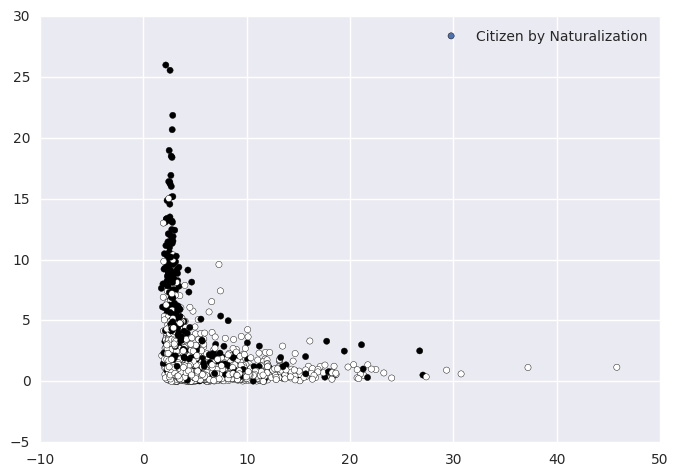

('# of Housing Units', 'Foreign born naturalized')


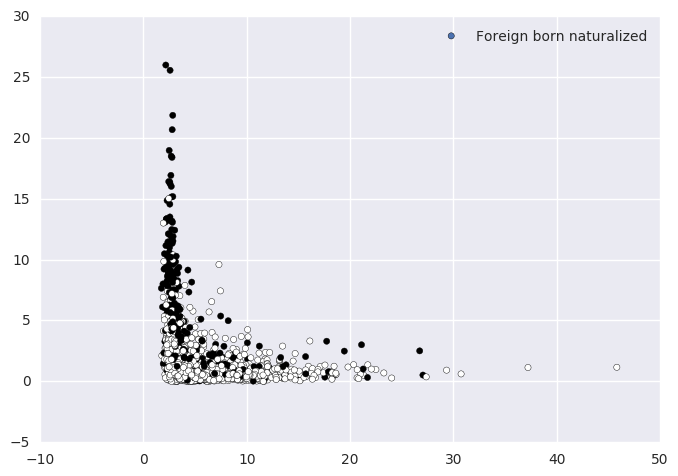

('# of Housing Units', 'Never Married')


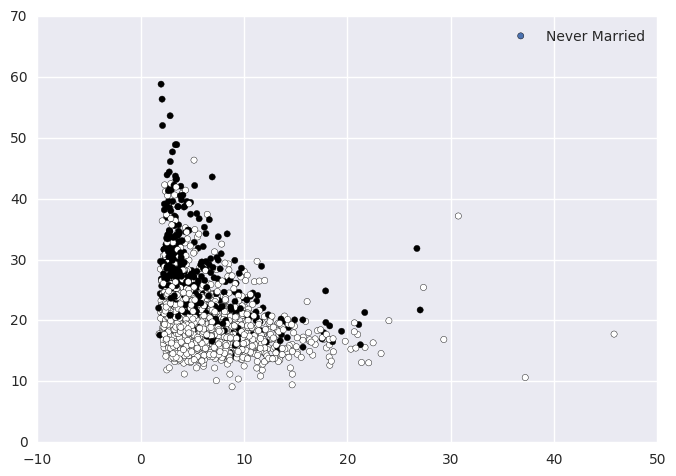

('# of Housing Units', 'Currently Married')


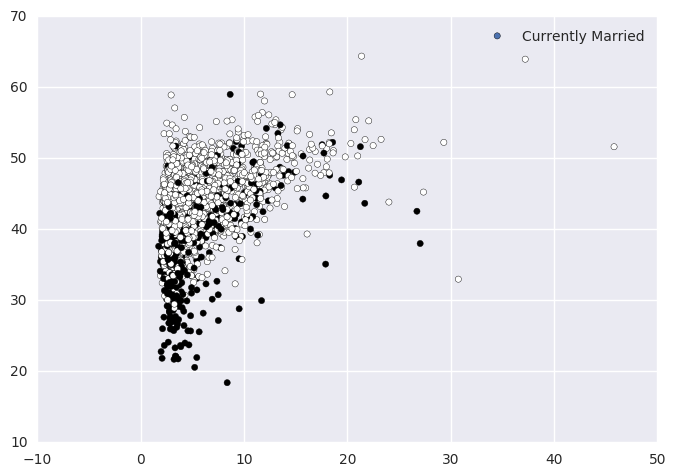

('# of Housing Units', 'Education Count')


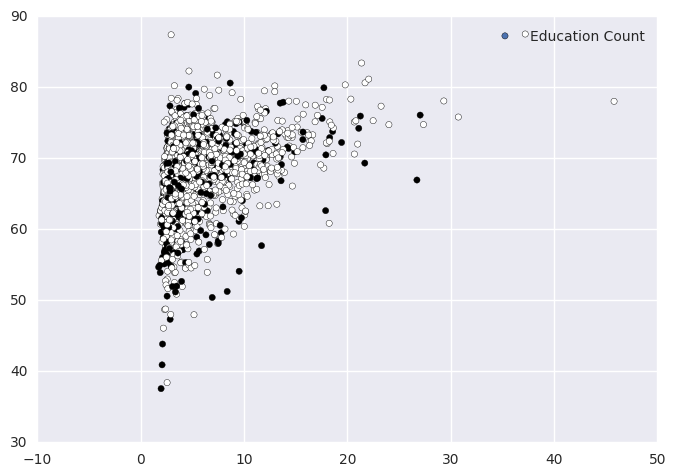

('# of Housing Units', 'Less Than HS')


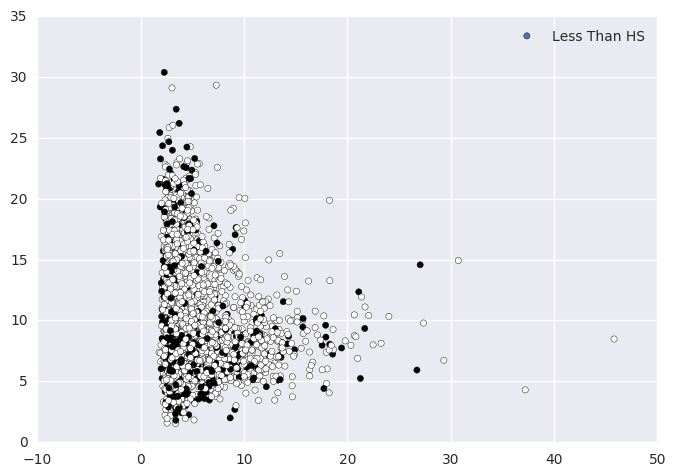

('# of Housing Units', 'Graduate')


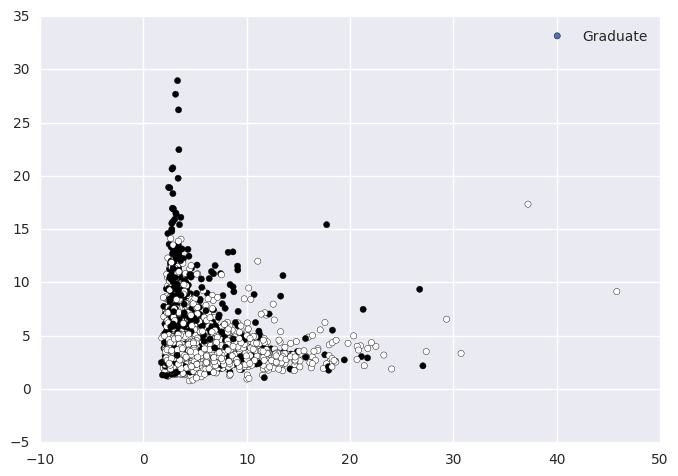

('# of Housing Units', 'Other State-HS or equal')


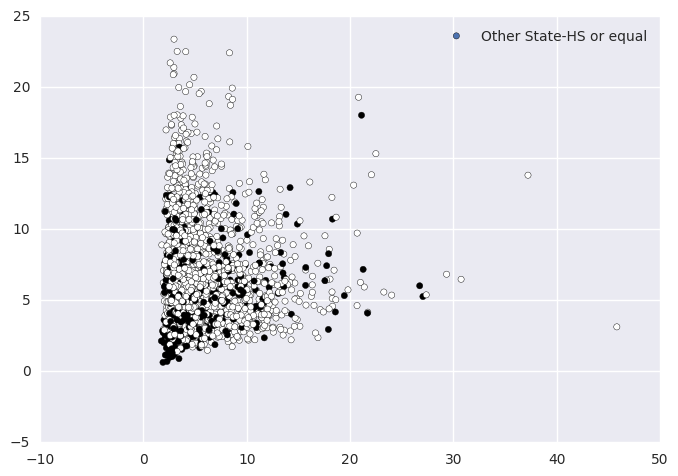

('# of Housing Units', 'Other State-Graduate')


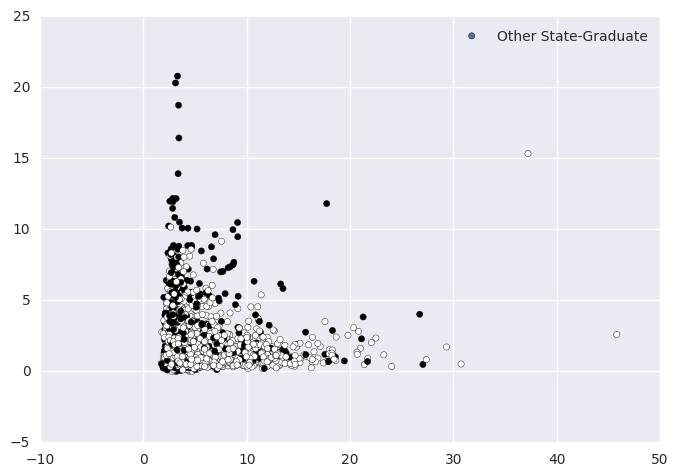

('# of Housing Units', 'Total Reporing 0 Income')


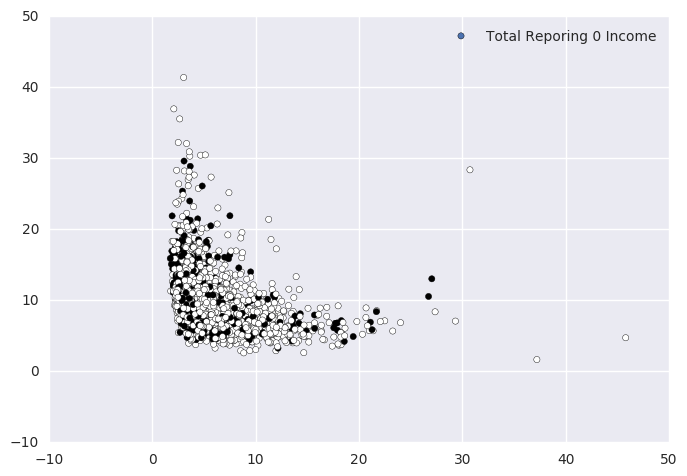

('# of Housing Units', 'Income 35-50K')


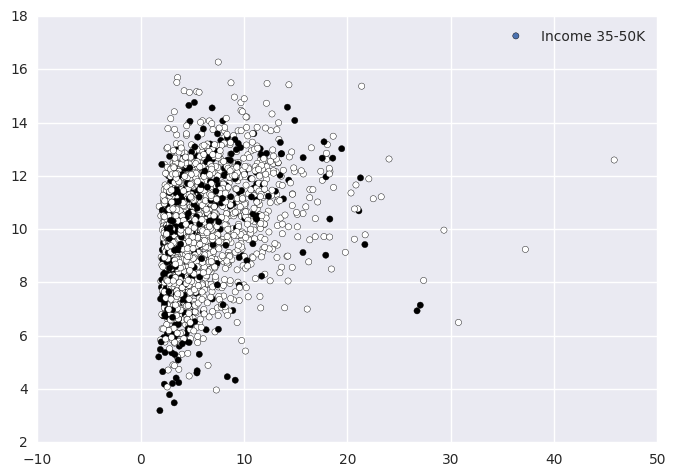

('# of Housing Units', 'Income 50-65K')


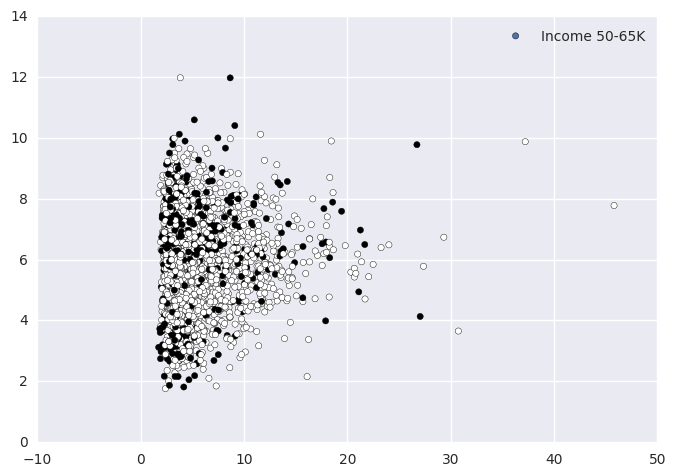

('# of Housing Units', 'Median Income')


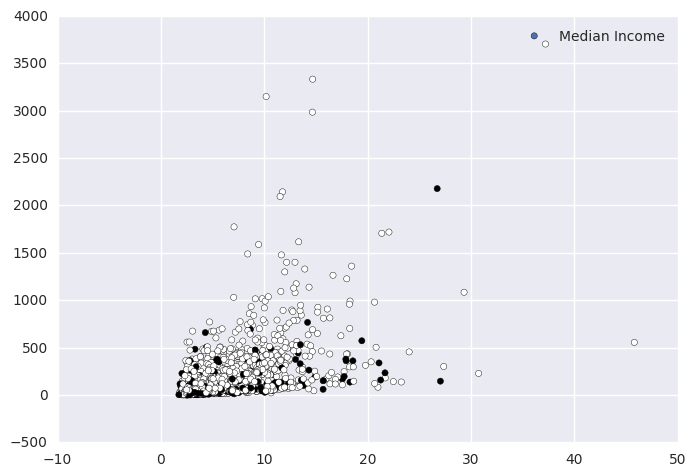

('# of Housing Units', 'Median Income Born In State')


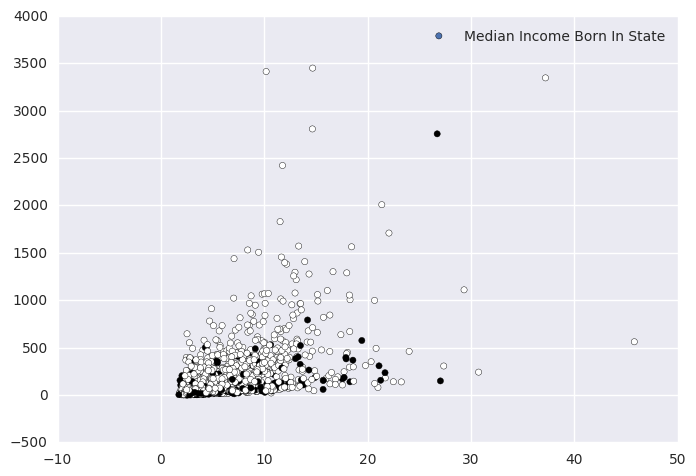

('# of Housing Units', 'Median Income Born Other State')


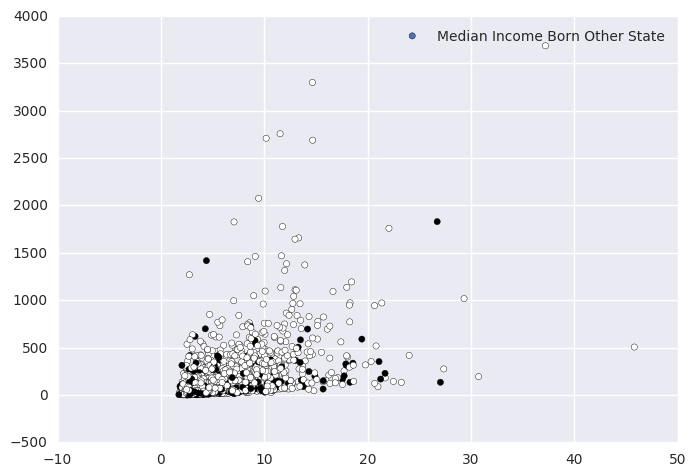

('# of Housing Units', 'Median Income Born Outside US: Native')


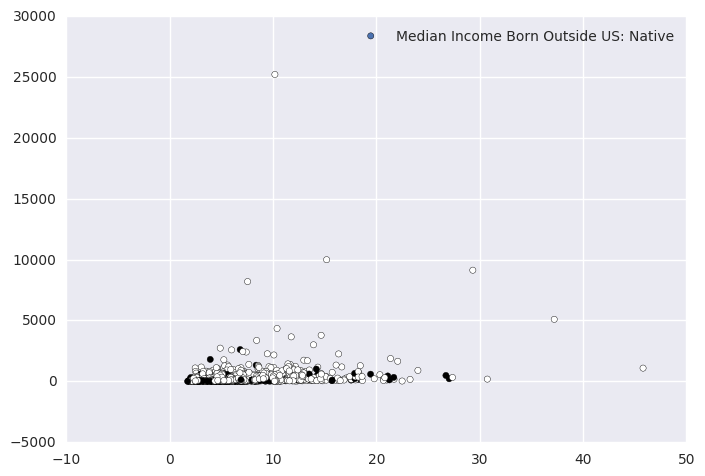

('# of Housing Units', 'Median Income Foreign Born')


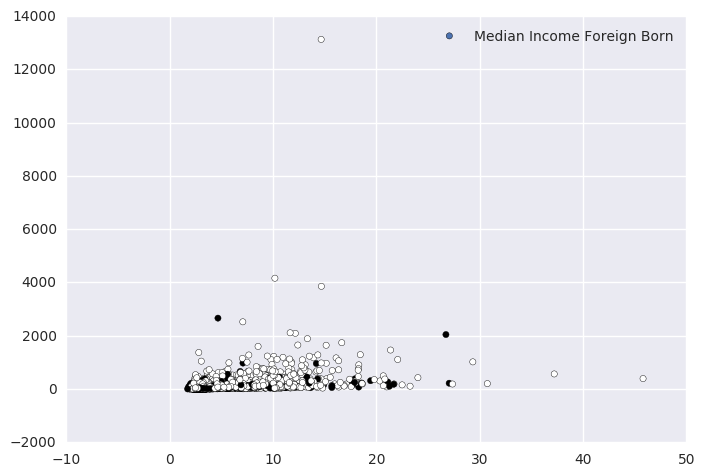

('# of Housing Units', '100% below povery line')


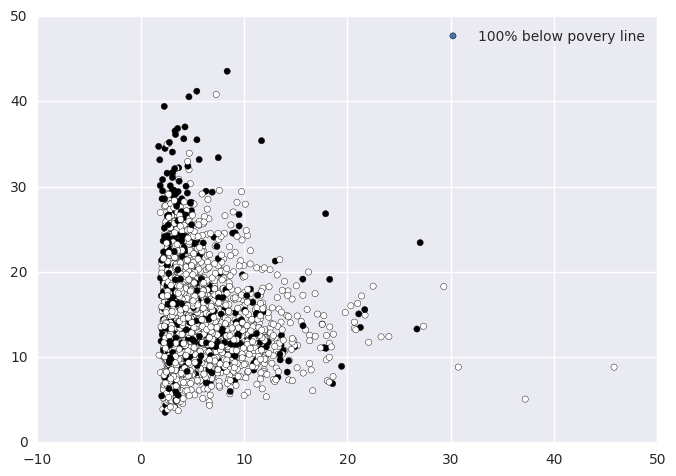

('# of Housing Units', 'Same house 1 year ago')


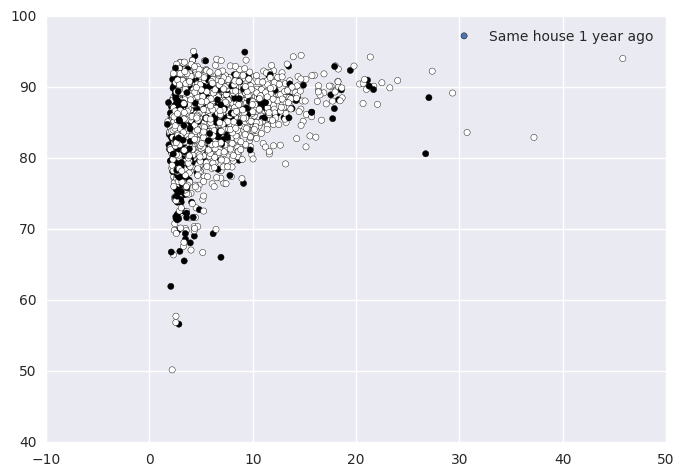

('# of Housing Units', 'Moved Within Same State')


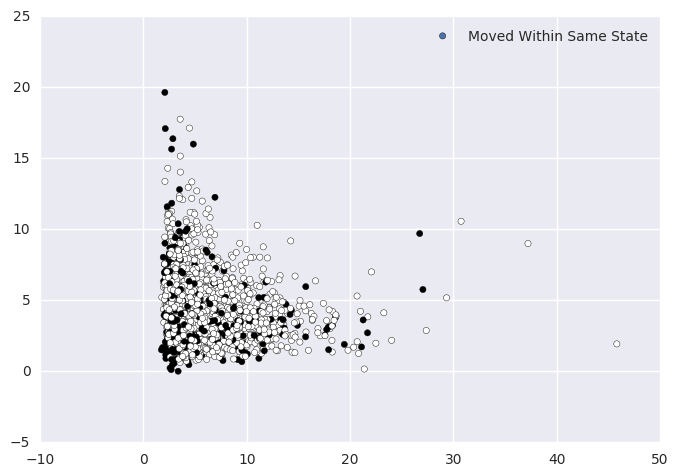

('# of Housing Units', 'Same house 1 year ago White')


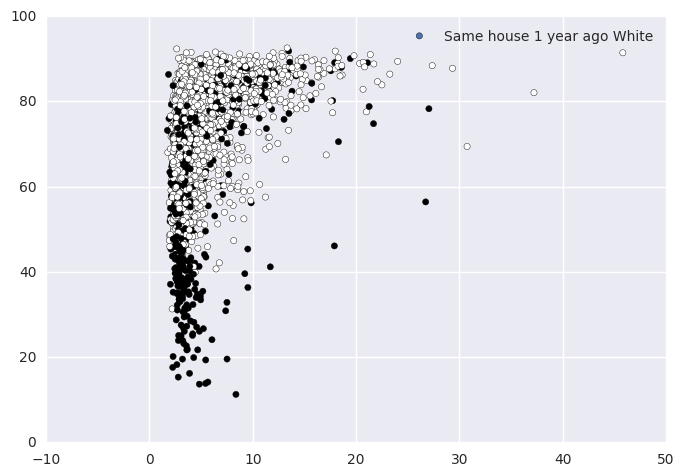

('# of Housing Units', 'Walked')


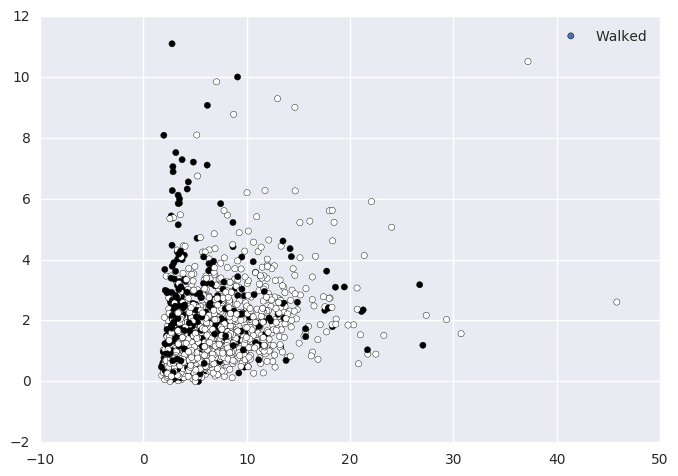

('# of Housing Units', 'Work outside County')


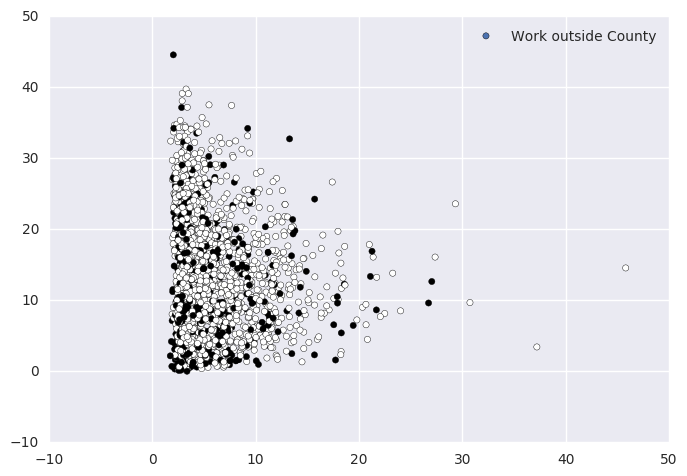

('# of Housing Units', 'Work outside State')


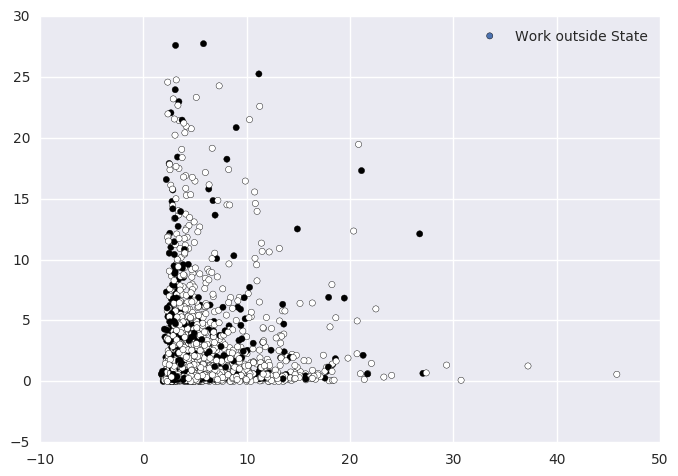

('# of Housing Units', '2 vehicles')


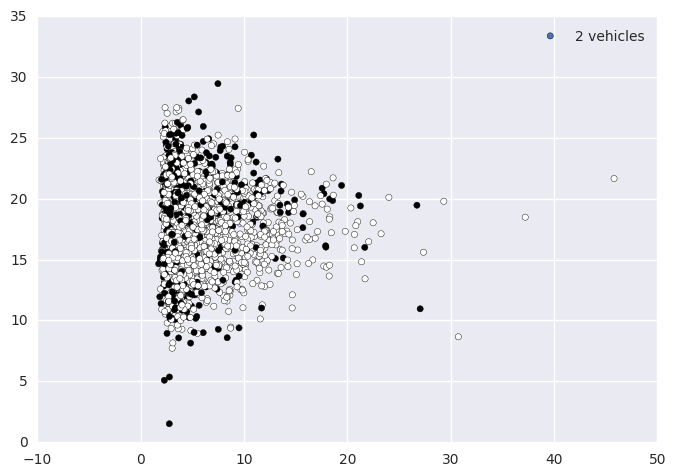

('# White Not Hispanic', 'Citizen by Naturalization')


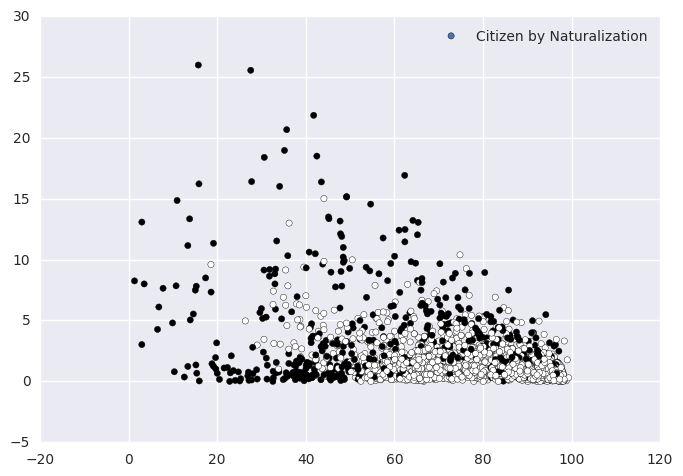

('# White Not Hispanic', 'Foreign born naturalized')


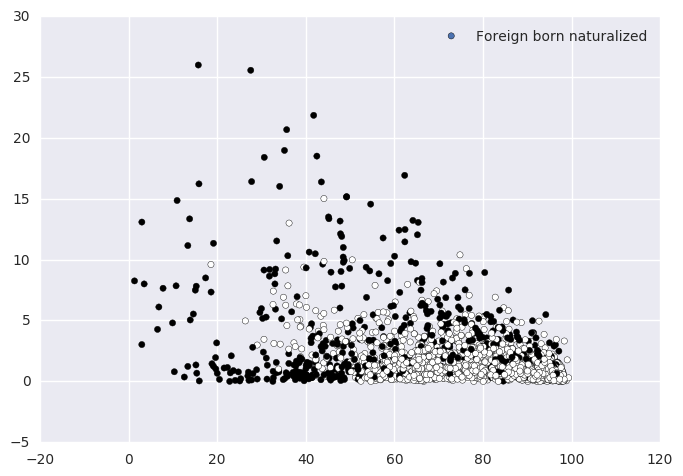

('# White Not Hispanic', 'Never Married')


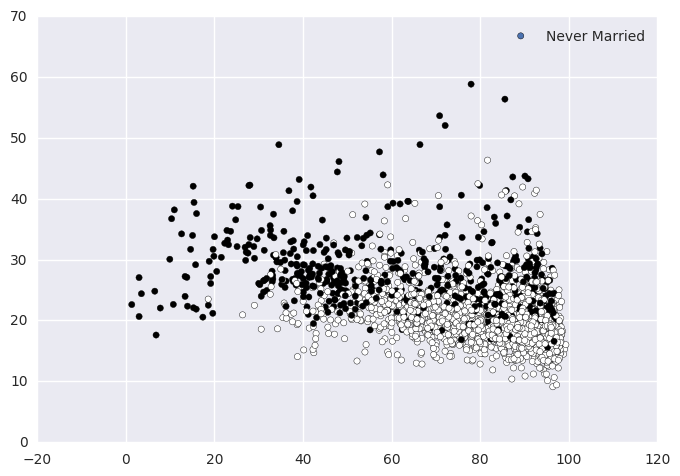

('# White Not Hispanic', 'Currently Married')


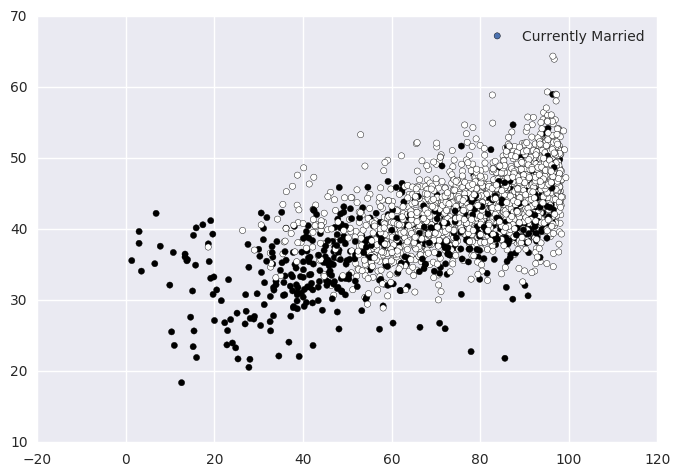

('# White Not Hispanic', 'Education Count')


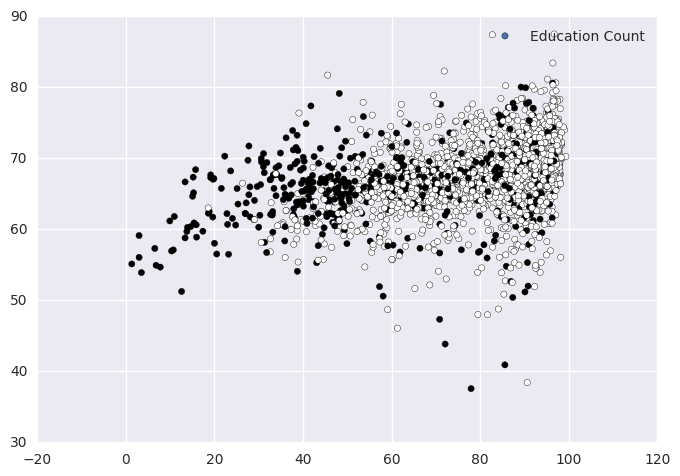

('# White Not Hispanic', 'Less Than HS')


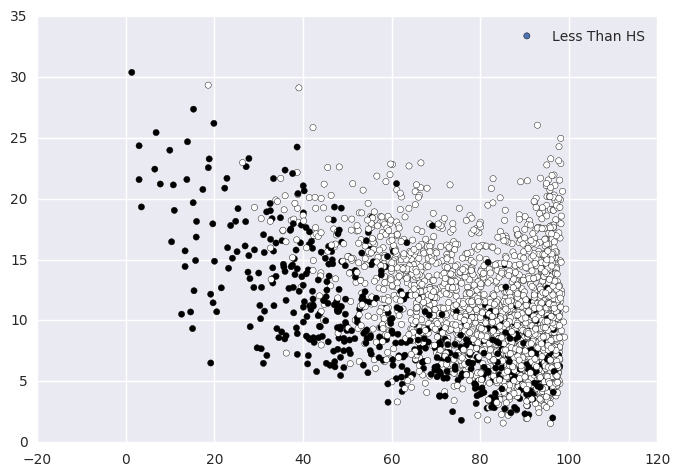

('# White Not Hispanic', 'Graduate')


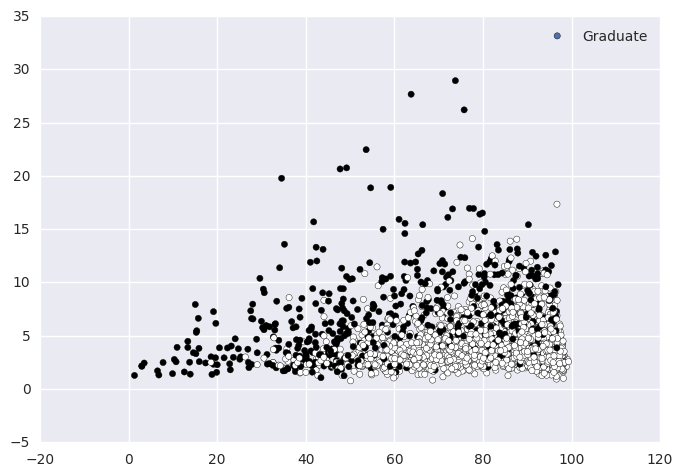

('# White Not Hispanic', 'Other State-HS or equal')


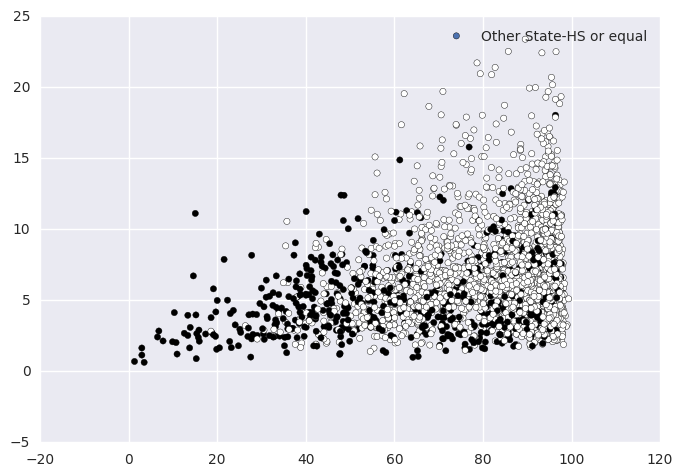

('# White Not Hispanic', 'Other State-Graduate')


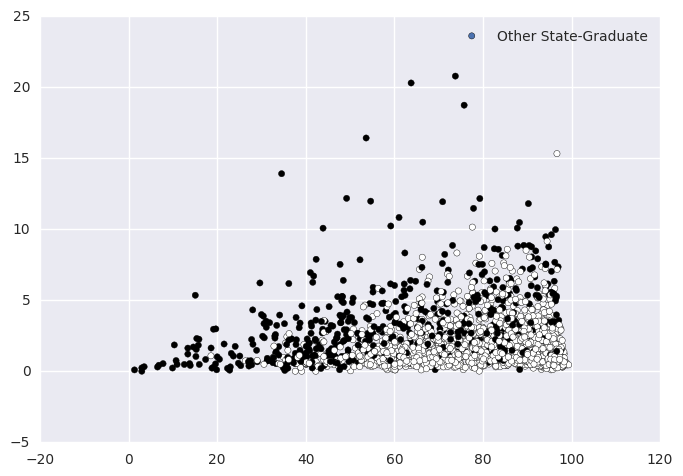

('# White Not Hispanic', 'Total Reporing 0 Income')


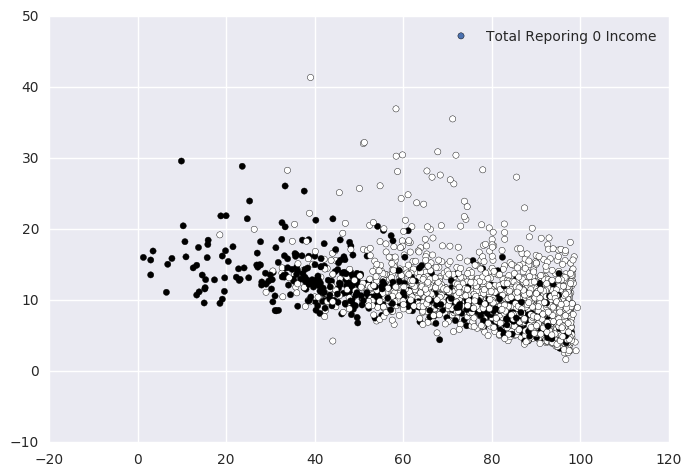

('# White Not Hispanic', 'Income 35-50K')


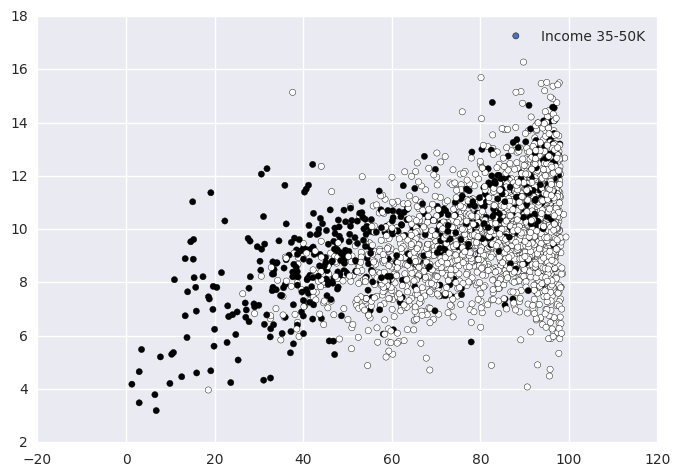

('# White Not Hispanic', 'Income 50-65K')


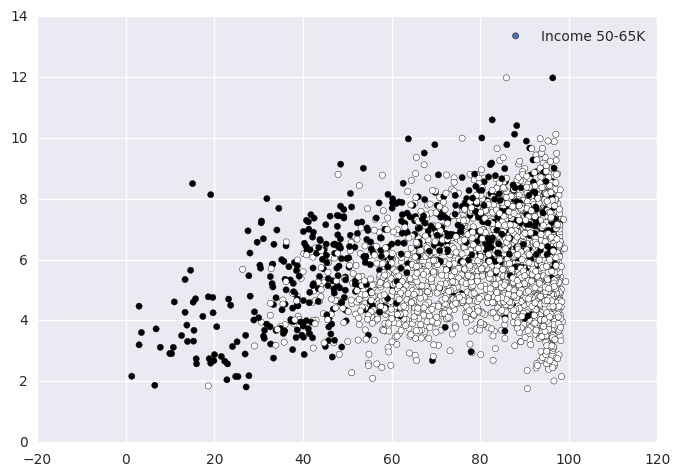

('# White Not Hispanic', 'Median Income')


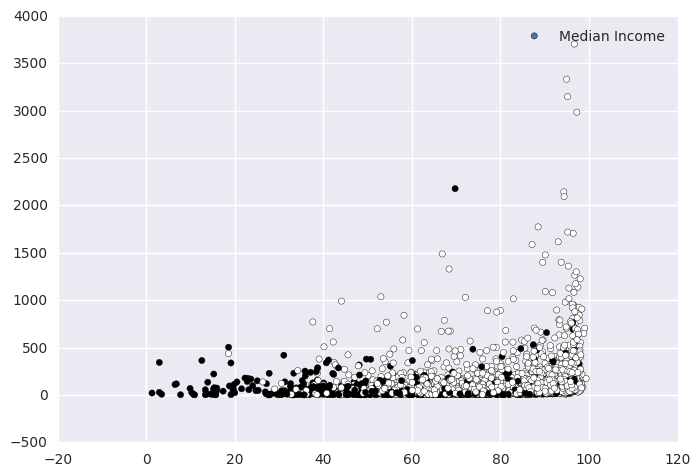

('# White Not Hispanic', 'Median Income Born In State')


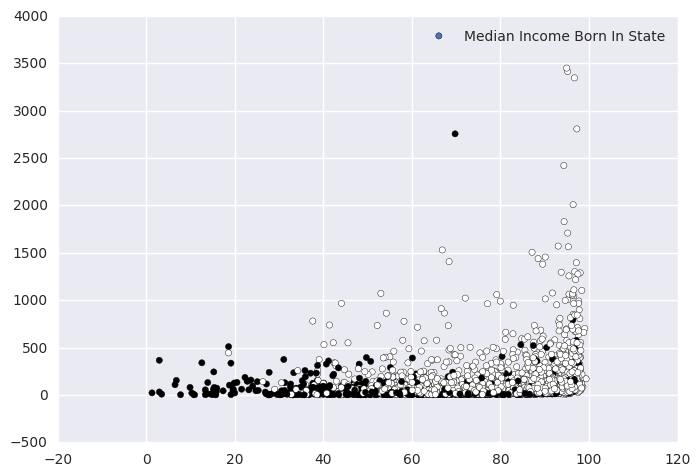

('# White Not Hispanic', 'Median Income Born Other State')


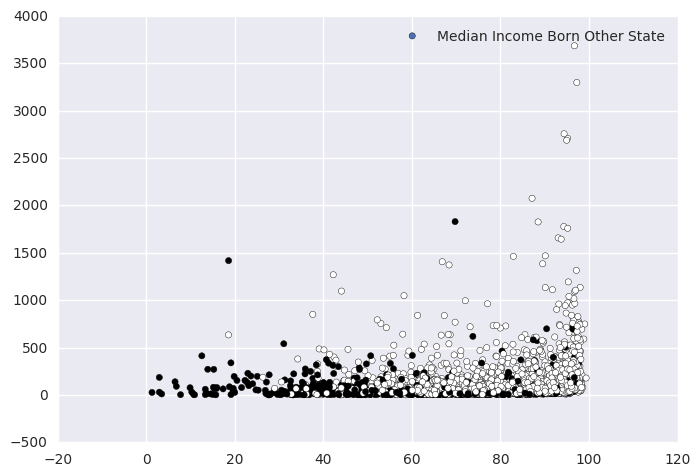

('# White Not Hispanic', 'Median Income Born Outside US: Native')


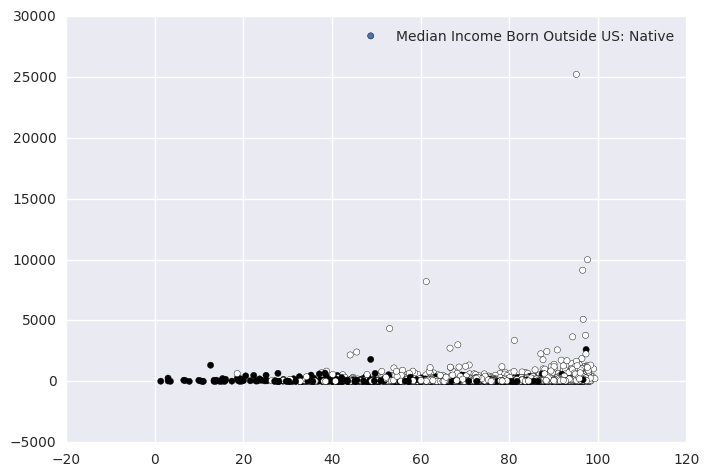

('# White Not Hispanic', 'Median Income Foreign Born')


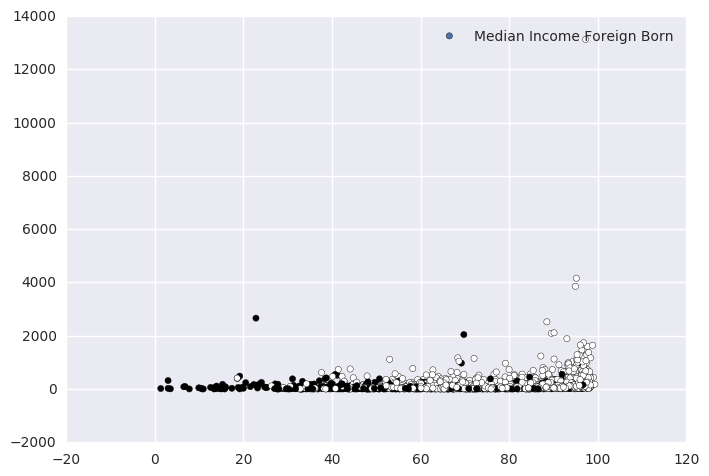

('# White Not Hispanic', '100% below povery line')


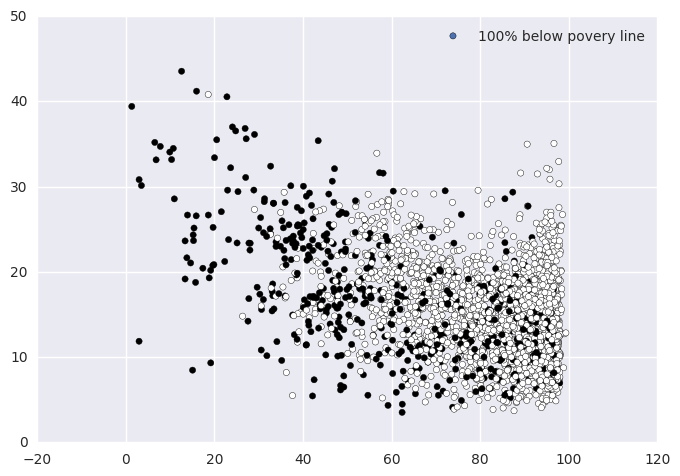

('# White Not Hispanic', 'Same house 1 year ago')


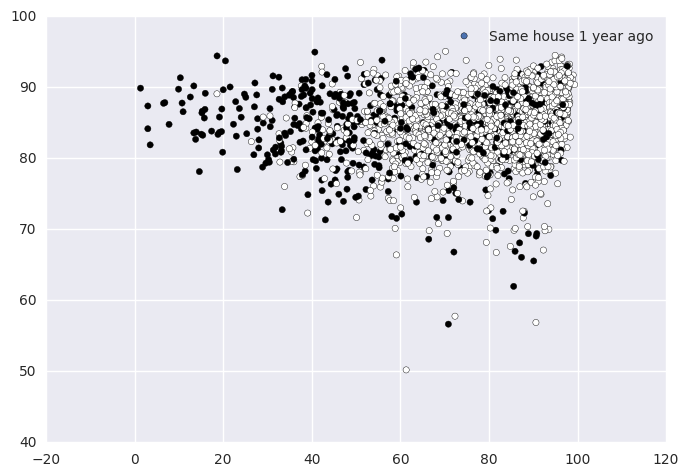

('# White Not Hispanic', 'Moved Within Same State')


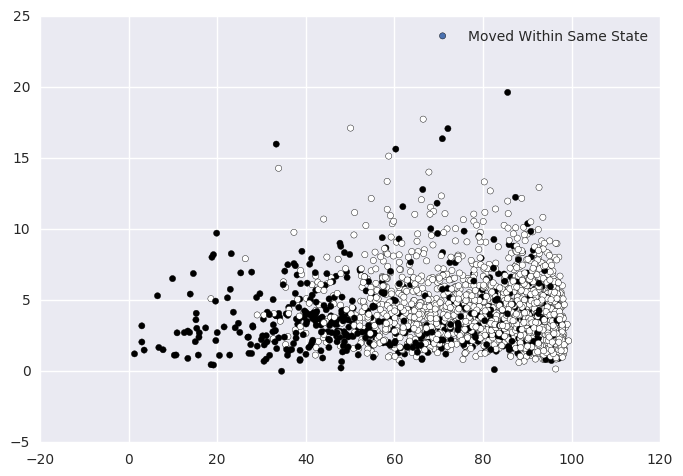

('# White Not Hispanic', 'Same house 1 year ago White')


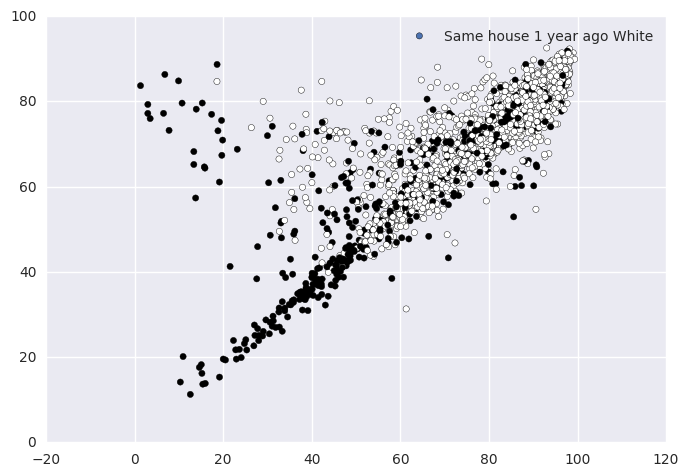

('# White Not Hispanic', 'Walked')


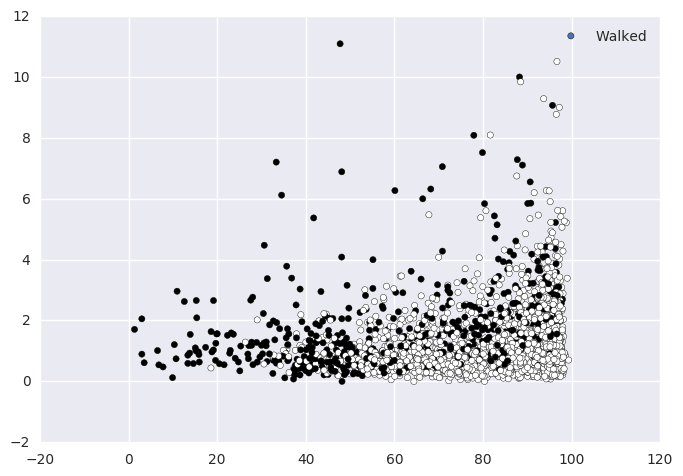

('# White Not Hispanic', 'Work outside County')


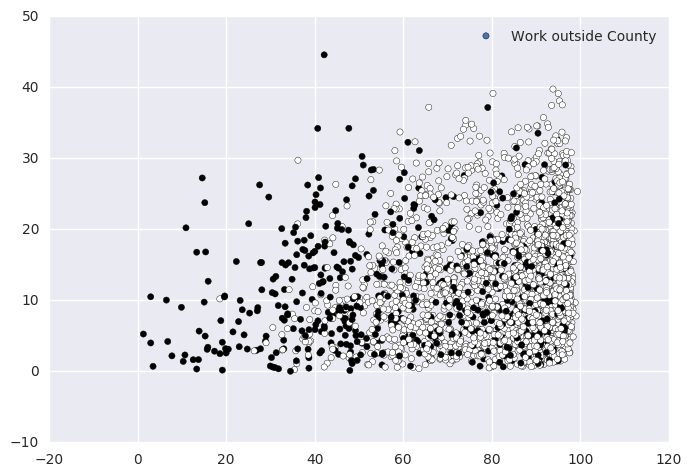

('# White Not Hispanic', 'Work outside State')


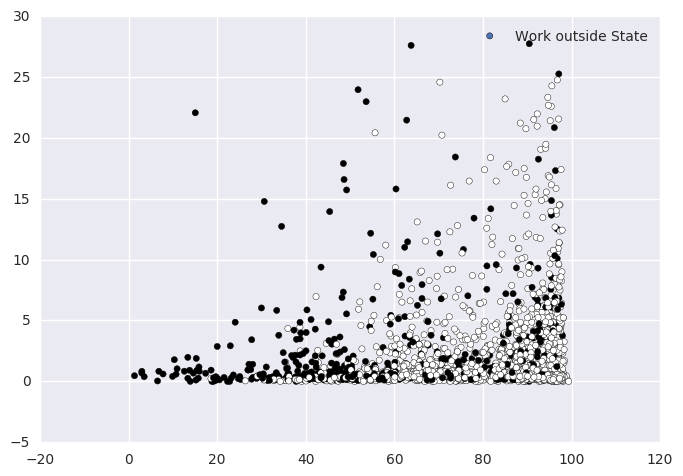

('# White Not Hispanic', '2 vehicles')


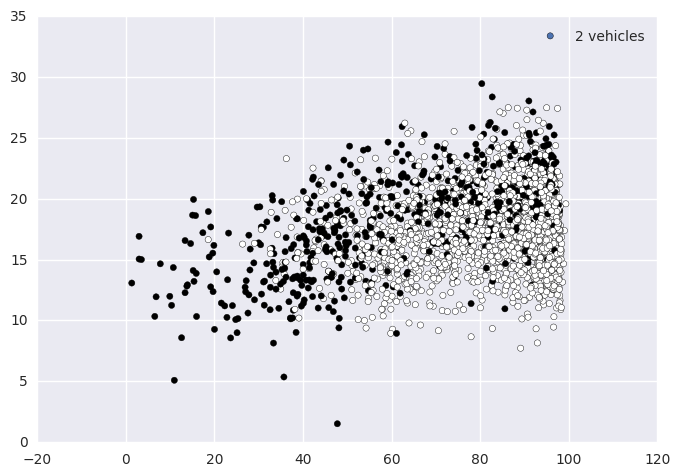

('Citizen by Naturalization', 'Foreign born naturalized')


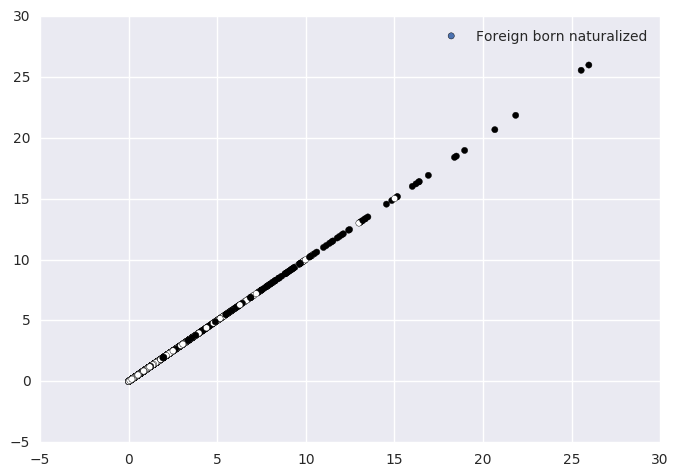

('Citizen by Naturalization', 'Never Married')


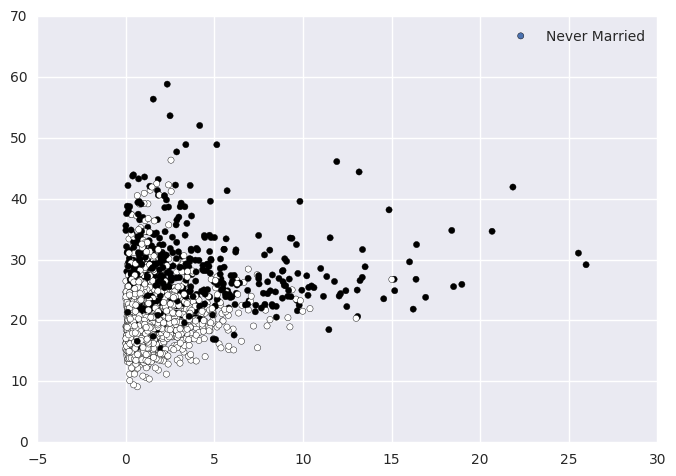

('Citizen by Naturalization', 'Currently Married')


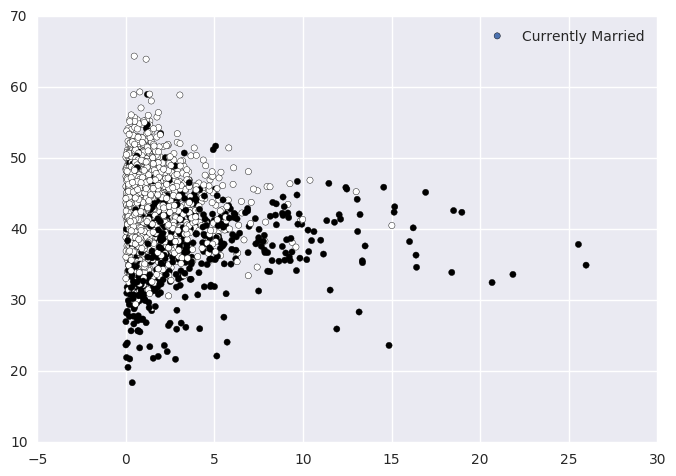

('Citizen by Naturalization', 'Education Count')


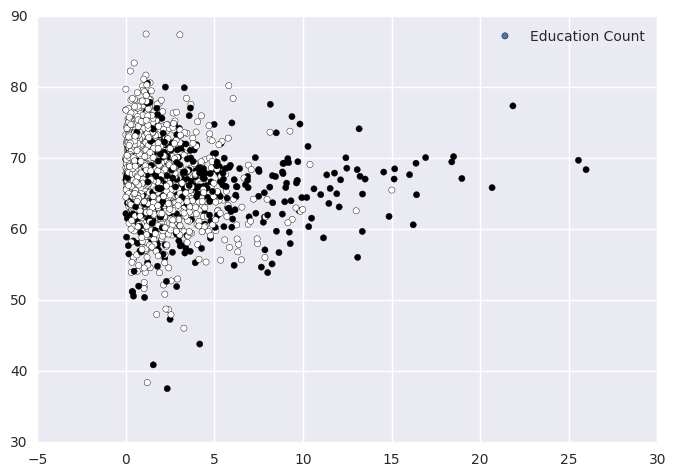

('Citizen by Naturalization', 'Less Than HS')


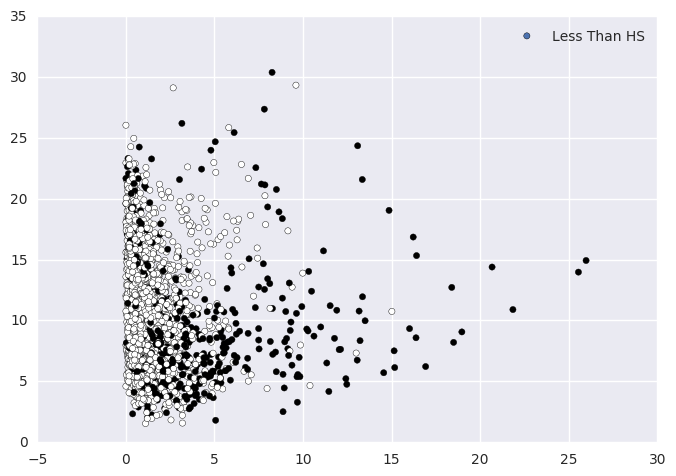

('Citizen by Naturalization', 'Graduate')


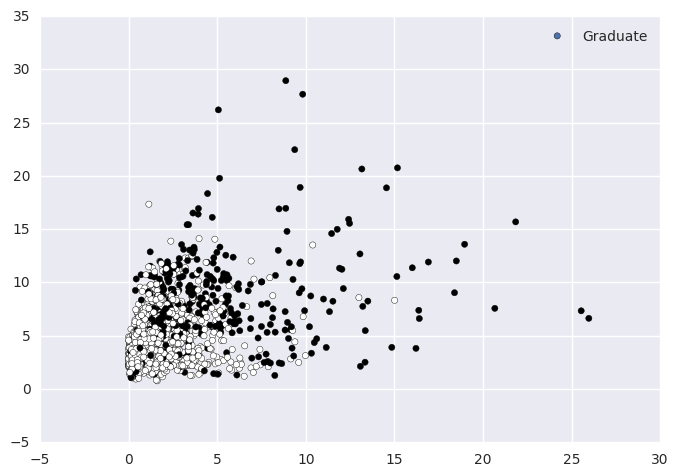

('Citizen by Naturalization', 'Other State-HS or equal')


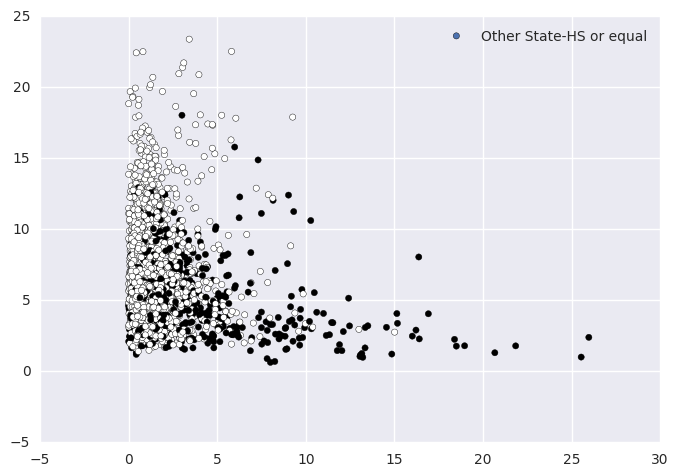

('Citizen by Naturalization', 'Other State-Graduate')


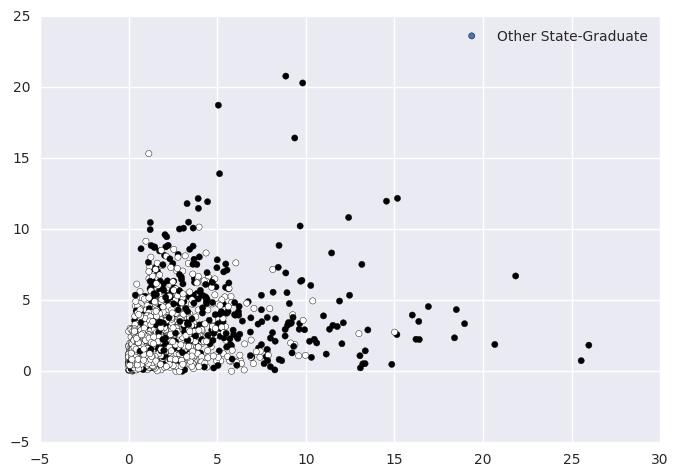

('Citizen by Naturalization', 'Total Reporing 0 Income')


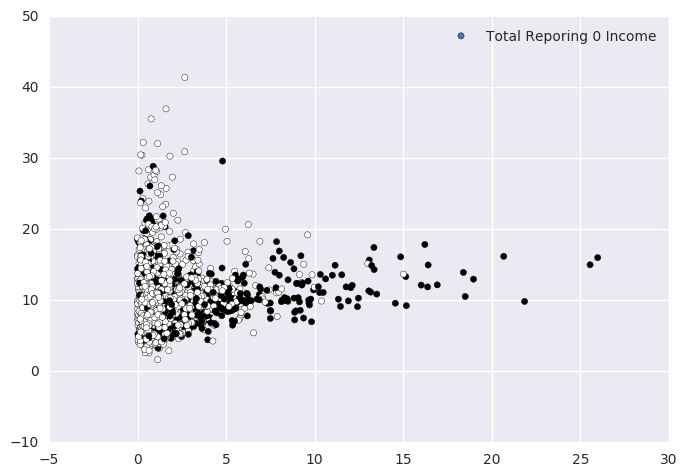

('Citizen by Naturalization', 'Income 35-50K')


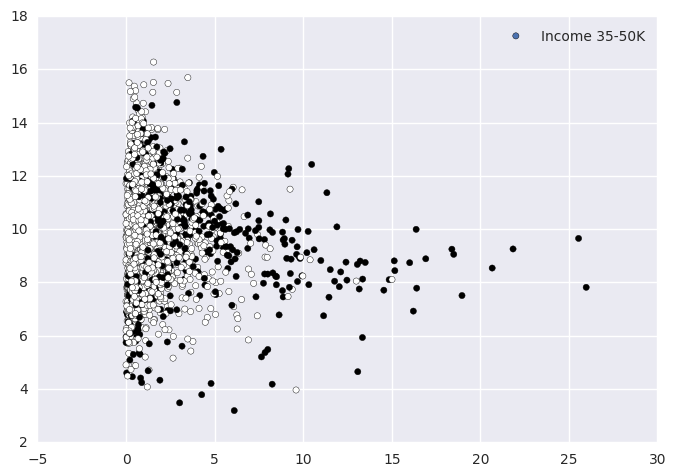

('Citizen by Naturalization', 'Income 50-65K')


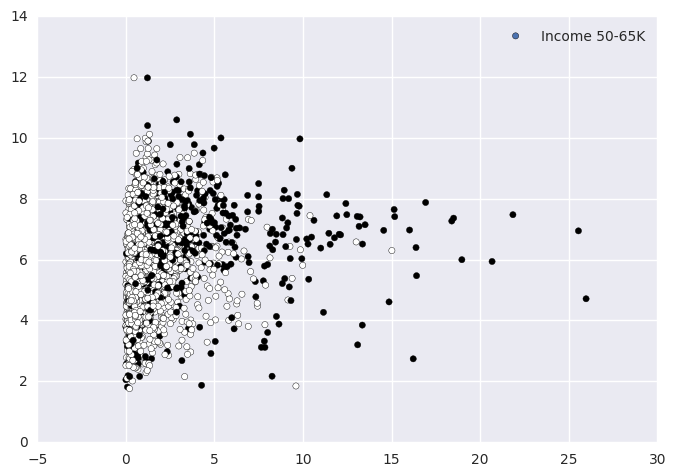

('Citizen by Naturalization', 'Median Income')


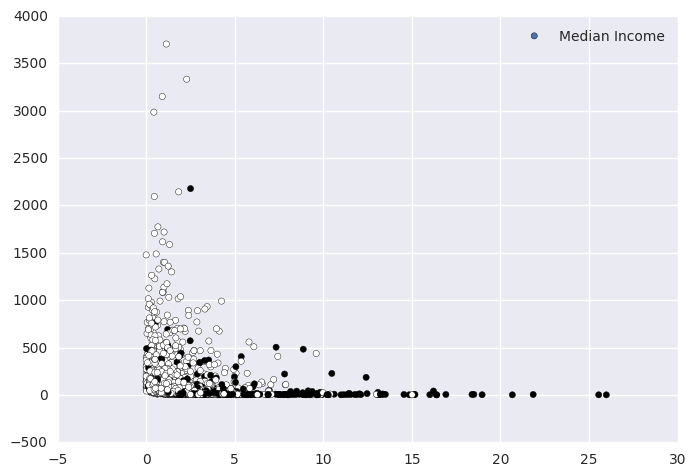

('Citizen by Naturalization', 'Median Income Born In State')


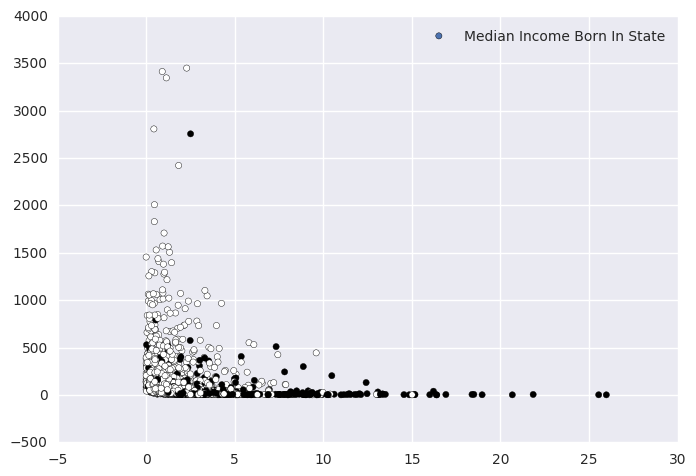

('Citizen by Naturalization', 'Median Income Born Other State')


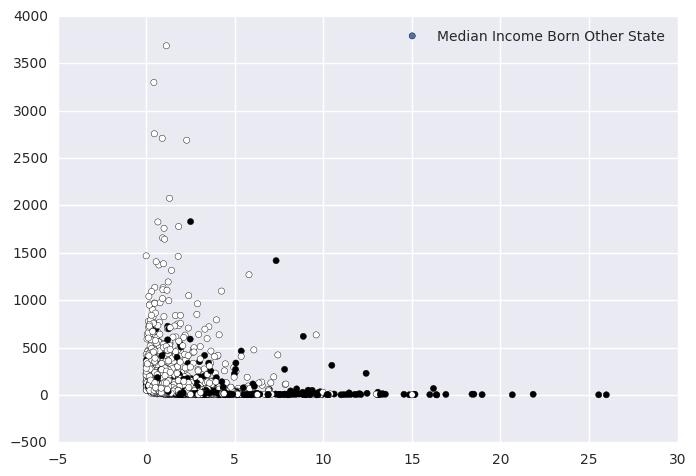

('Citizen by Naturalization', 'Median Income Born Outside US: Native')


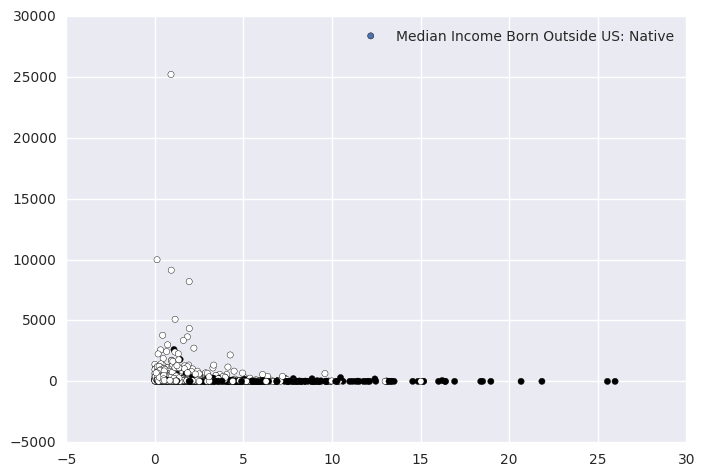

('Citizen by Naturalization', 'Median Income Foreign Born')


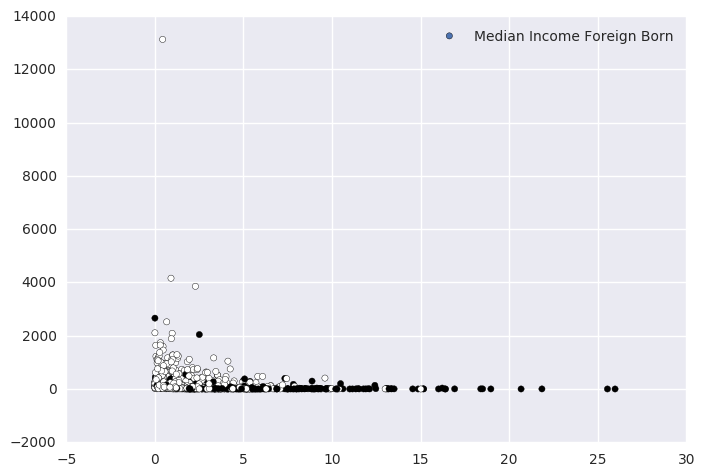

('Citizen by Naturalization', '100% below povery line')


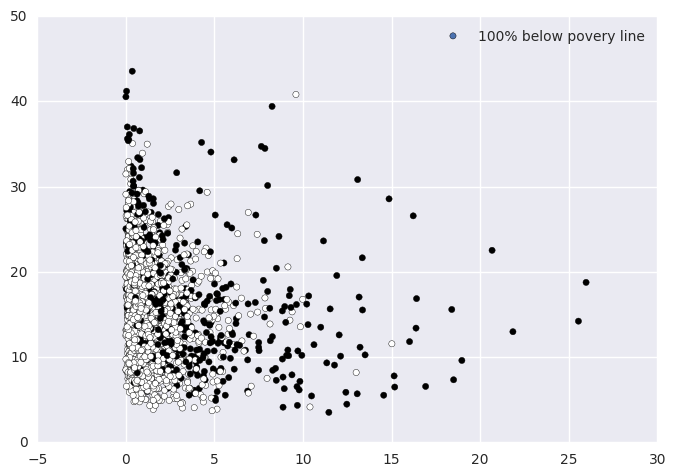

('Citizen by Naturalization', 'Same house 1 year ago')


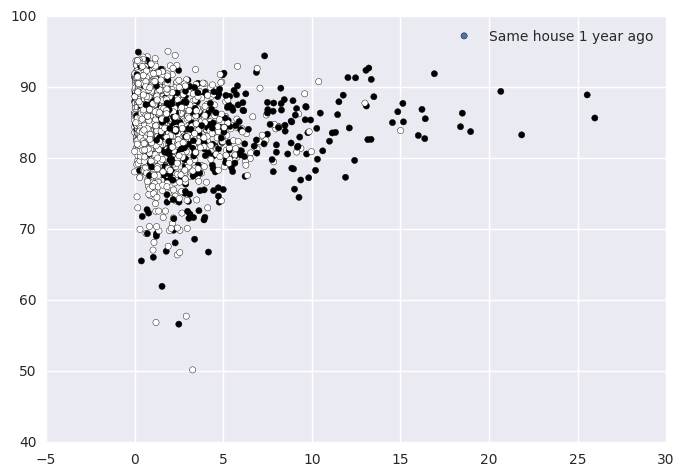

('Citizen by Naturalization', 'Moved Within Same State')


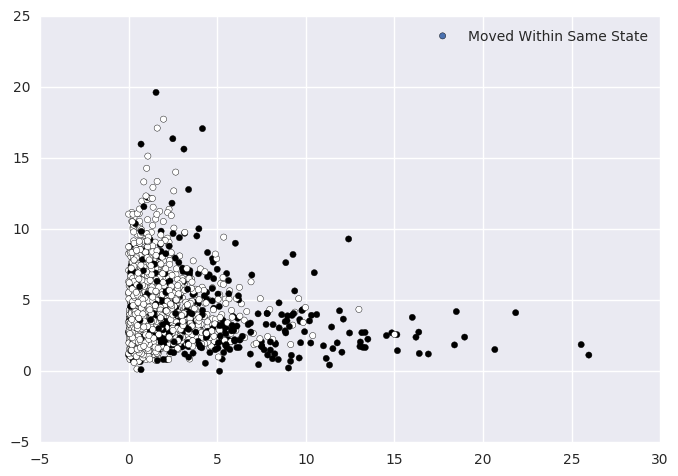

('Citizen by Naturalization', 'Same house 1 year ago White')


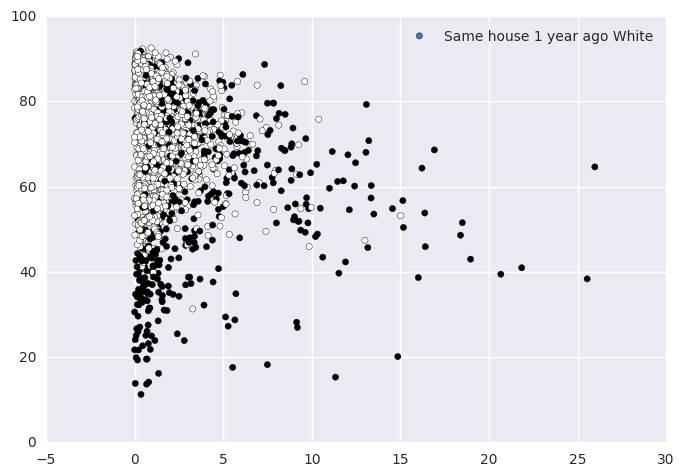

('Citizen by Naturalization', 'Walked')


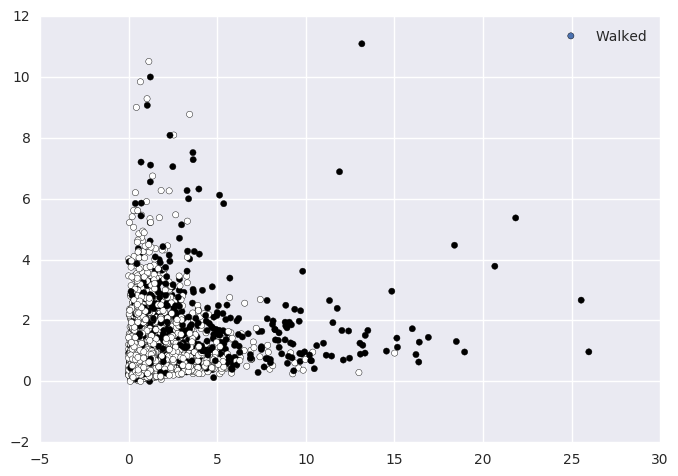

('Citizen by Naturalization', 'Work outside County')


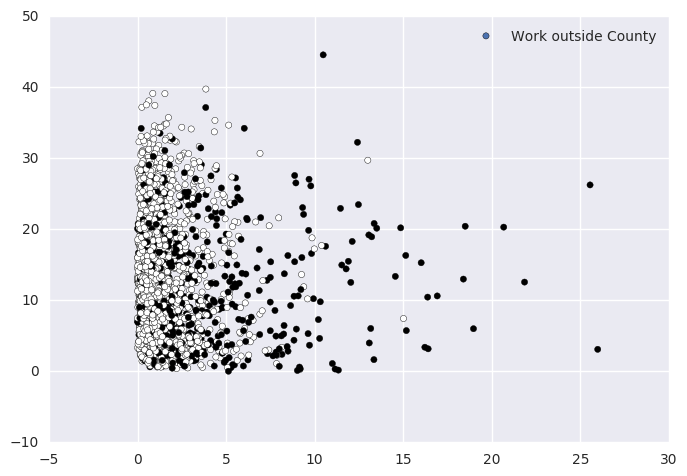

('Citizen by Naturalization', 'Work outside State')


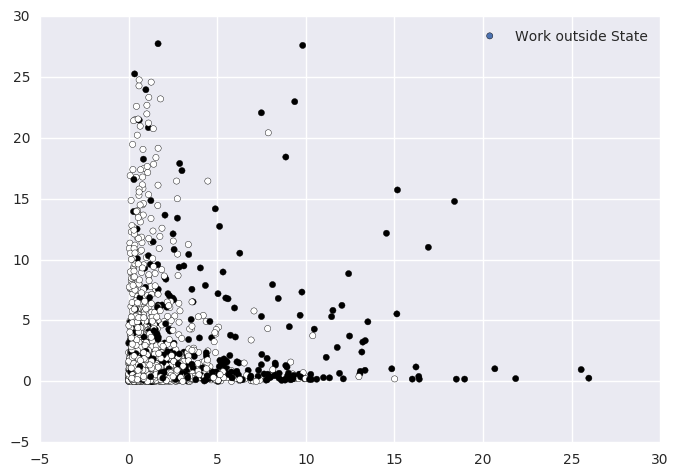

('Citizen by Naturalization', '2 vehicles')


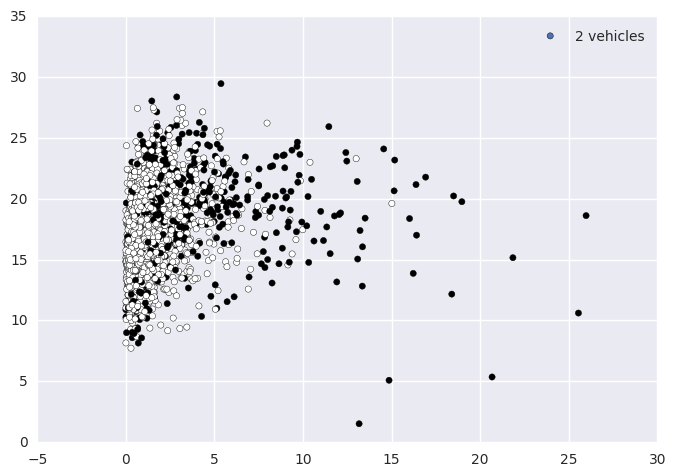

('Foreign born naturalized', 'Never Married')


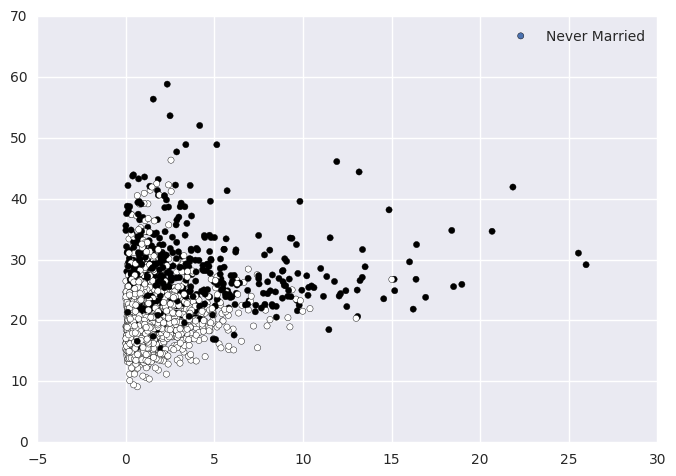

('Foreign born naturalized', 'Currently Married')


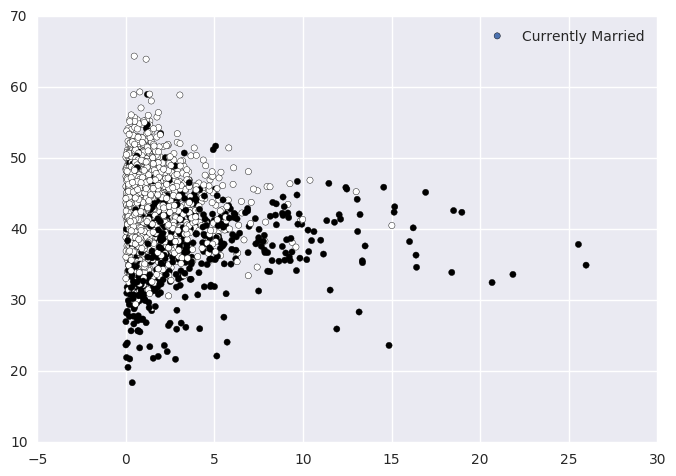

('Foreign born naturalized', 'Education Count')


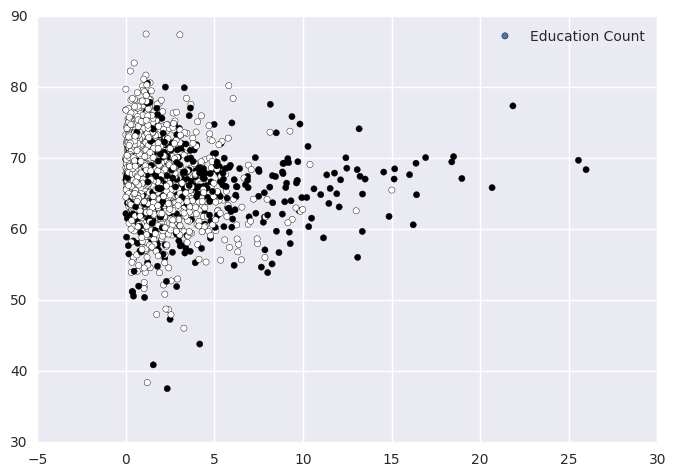

('Foreign born naturalized', 'Less Than HS')


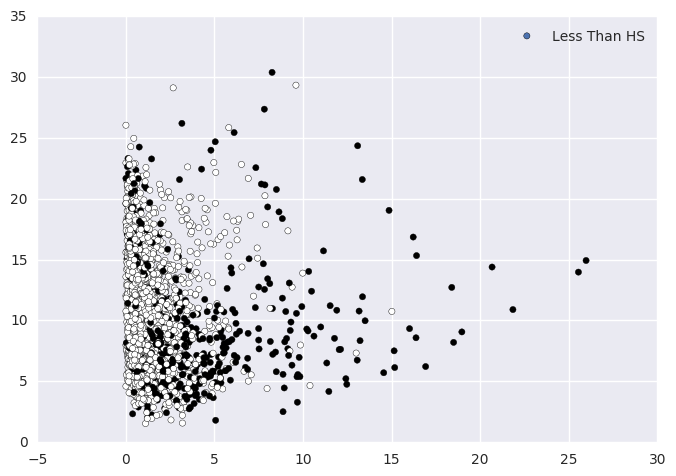

('Foreign born naturalized', 'Graduate')


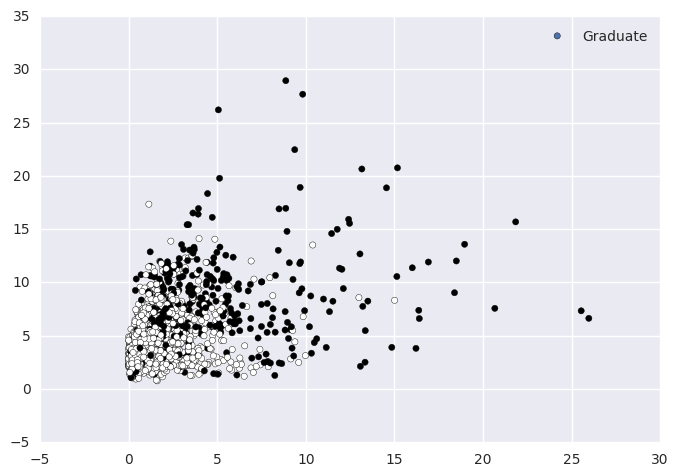

('Foreign born naturalized', 'Other State-HS or equal')


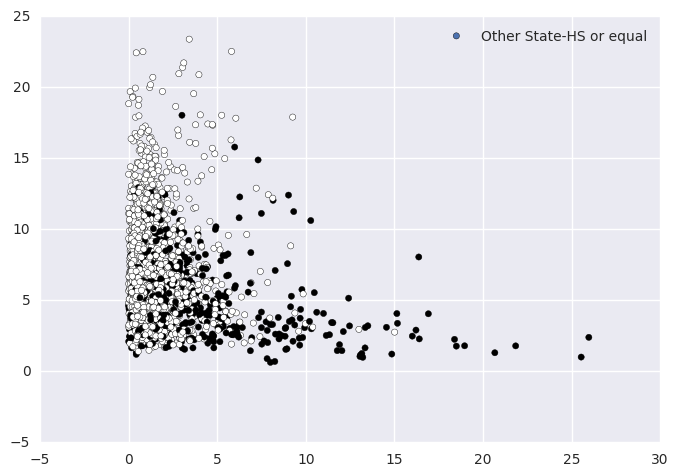

('Foreign born naturalized', 'Other State-Graduate')


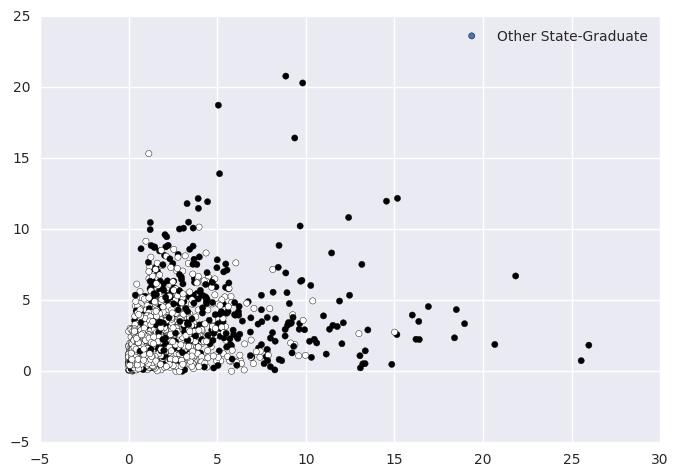

('Foreign born naturalized', 'Total Reporing 0 Income')


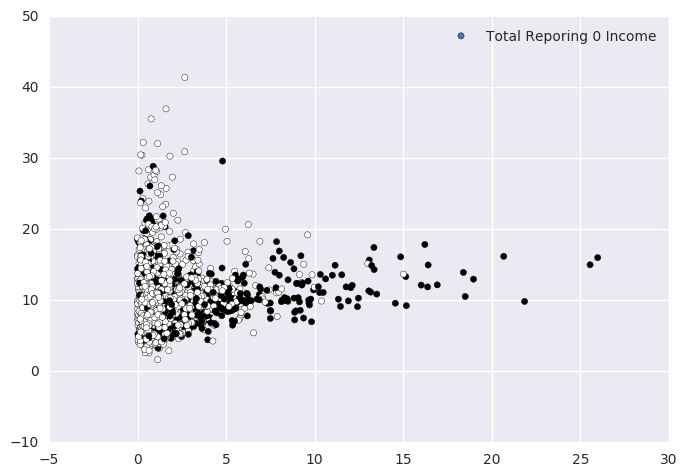

('Foreign born naturalized', 'Income 35-50K')


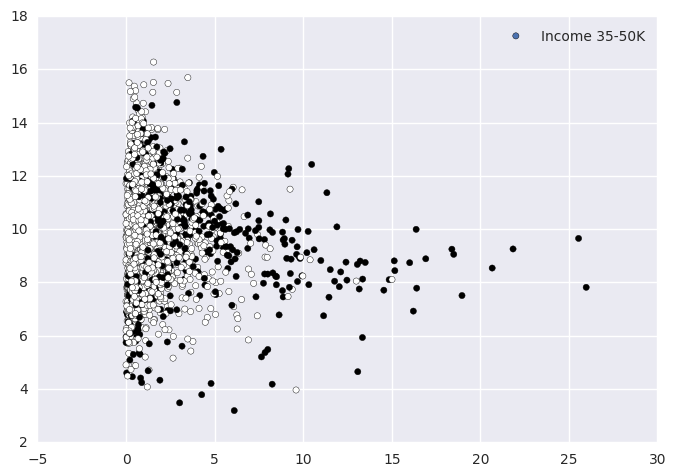

('Foreign born naturalized', 'Income 50-65K')


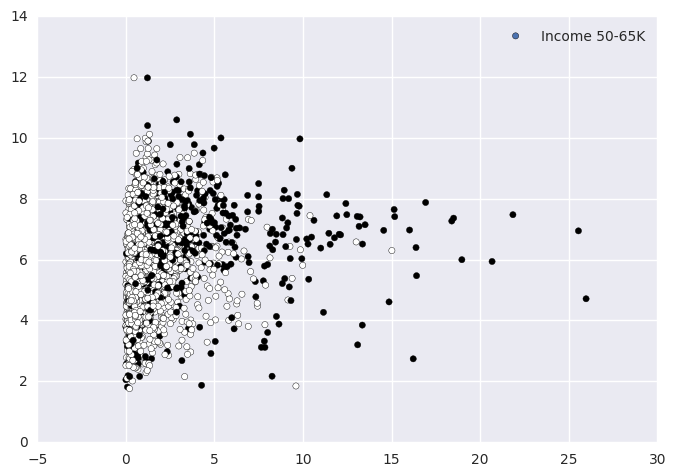

('Foreign born naturalized', 'Median Income')


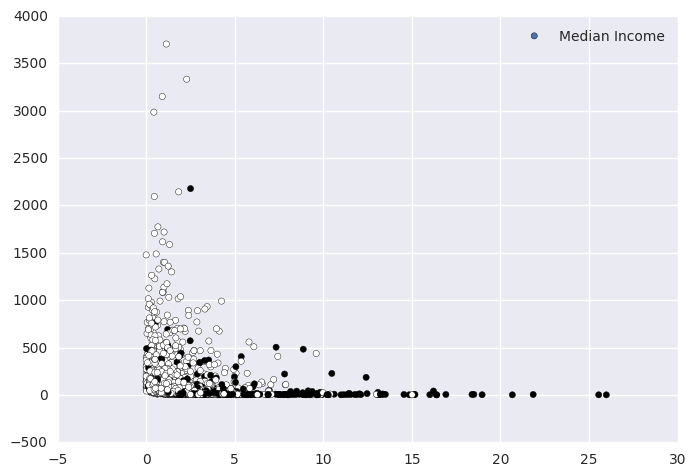

('Foreign born naturalized', 'Median Income Born In State')


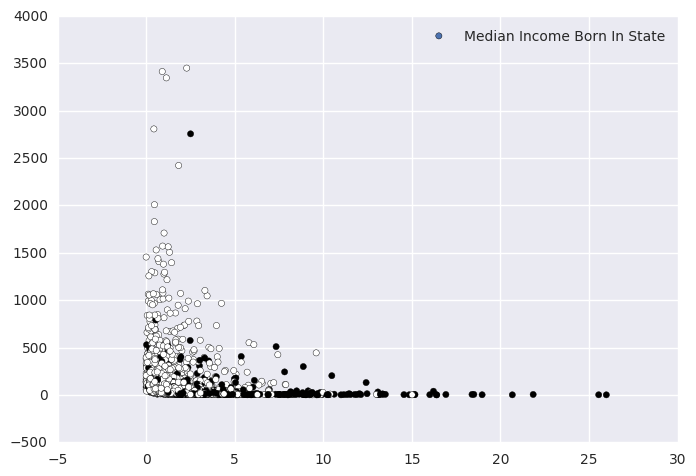

('Foreign born naturalized', 'Median Income Born Other State')


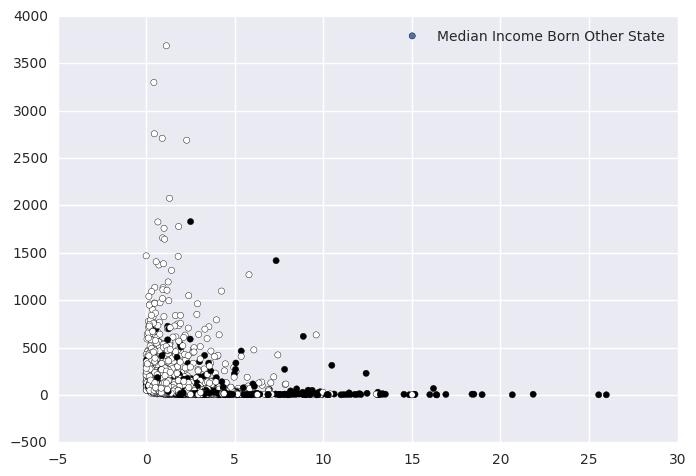

('Foreign born naturalized', 'Median Income Born Outside US: Native')


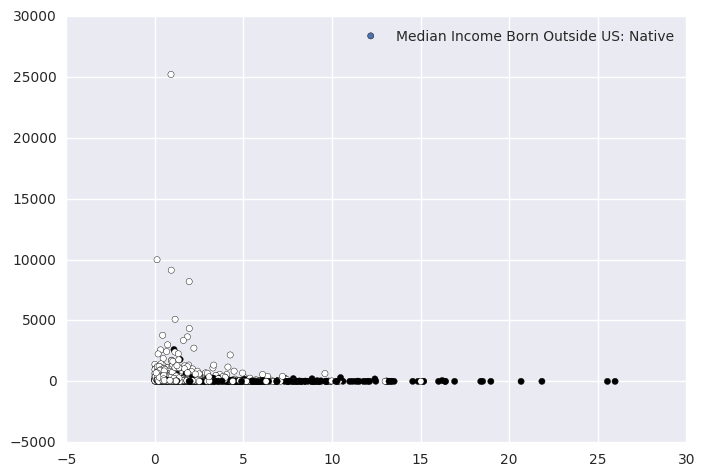

('Foreign born naturalized', 'Median Income Foreign Born')


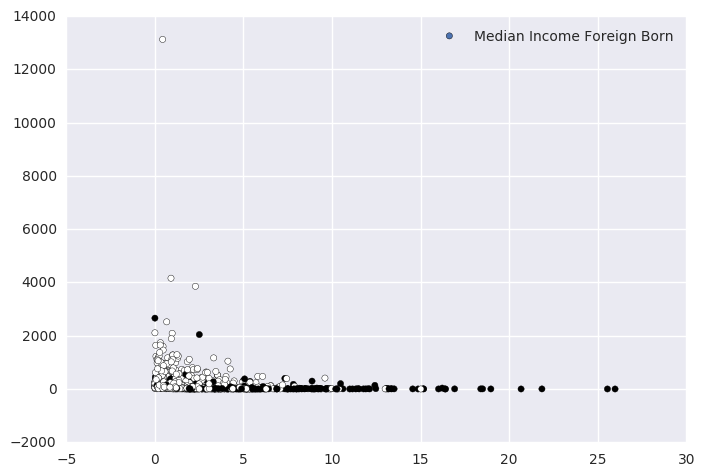

('Foreign born naturalized', '100% below povery line')


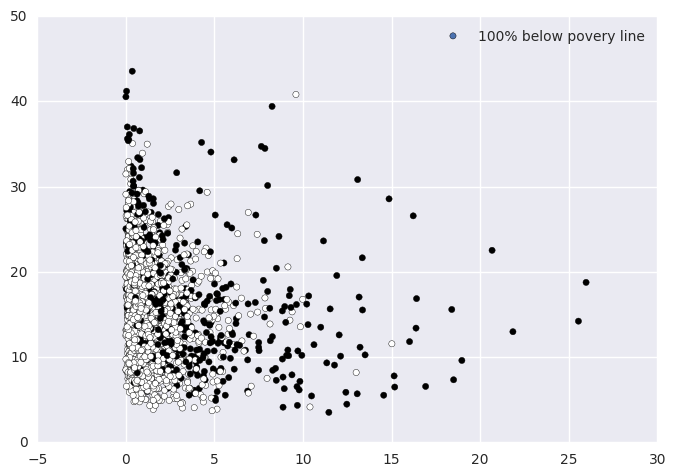

('Foreign born naturalized', 'Same house 1 year ago')


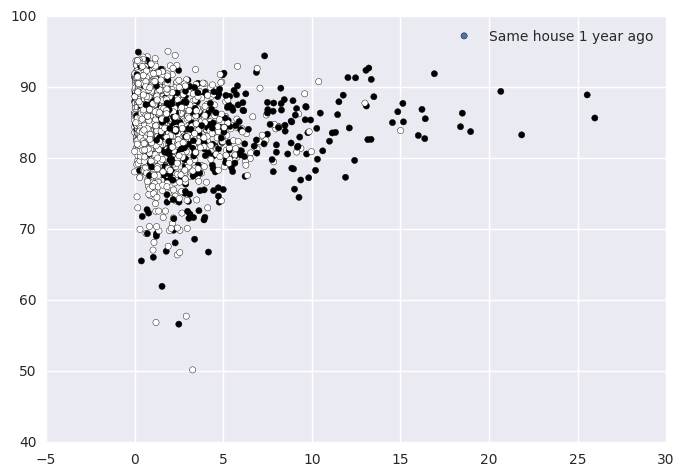

('Foreign born naturalized', 'Moved Within Same State')


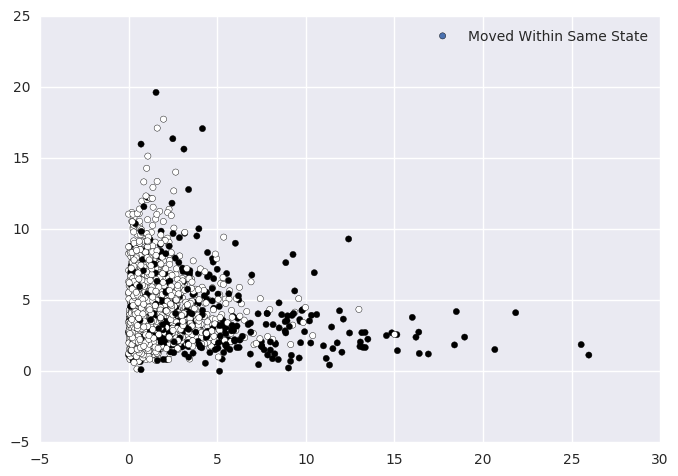

('Foreign born naturalized', 'Same house 1 year ago White')


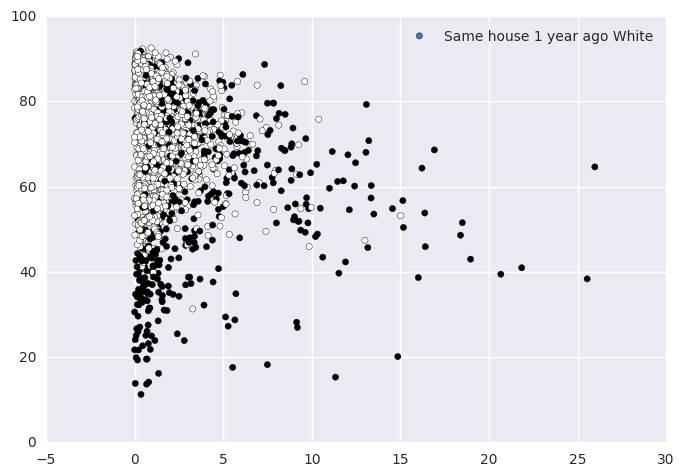

('Foreign born naturalized', 'Walked')


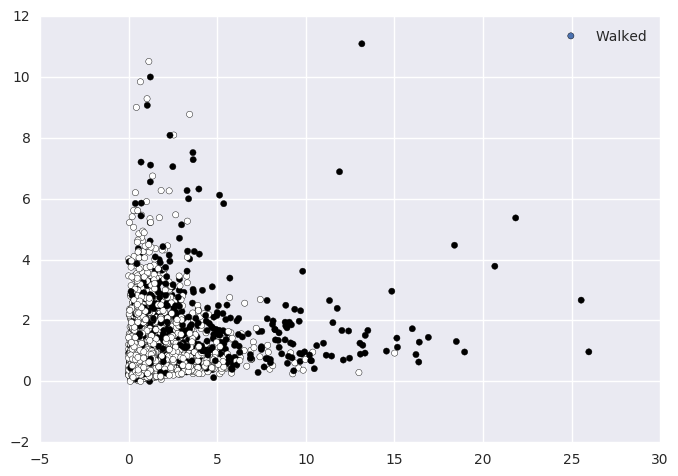

('Foreign born naturalized', 'Work outside County')


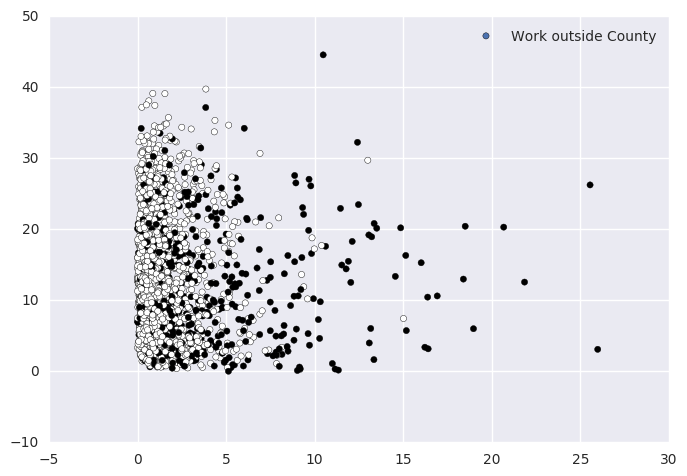

('Foreign born naturalized', 'Work outside State')


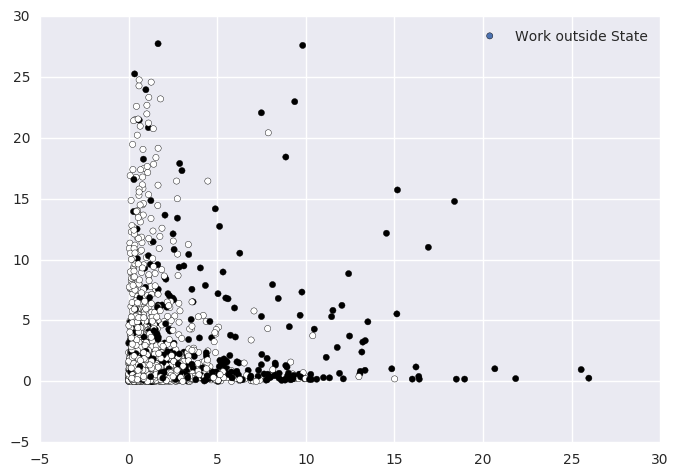

('Foreign born naturalized', '2 vehicles')


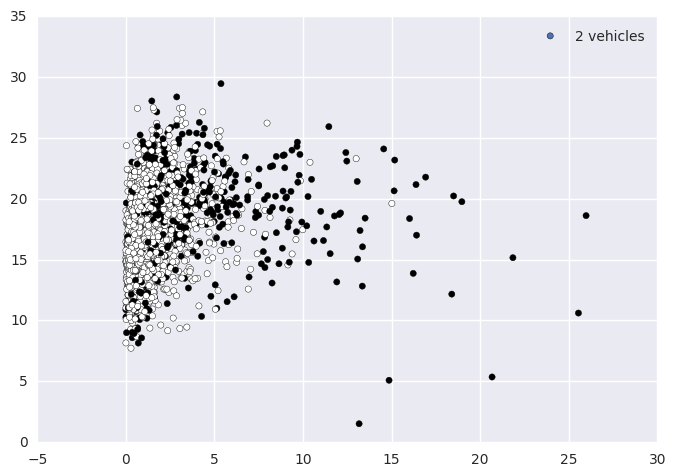

('Never Married', 'Currently Married')


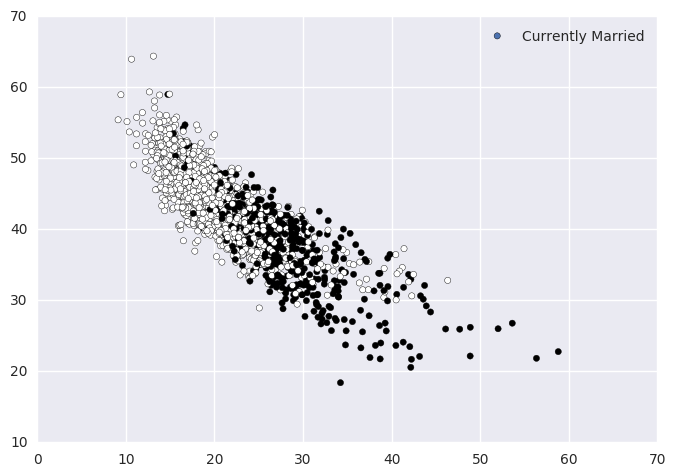

('Never Married', 'Education Count')


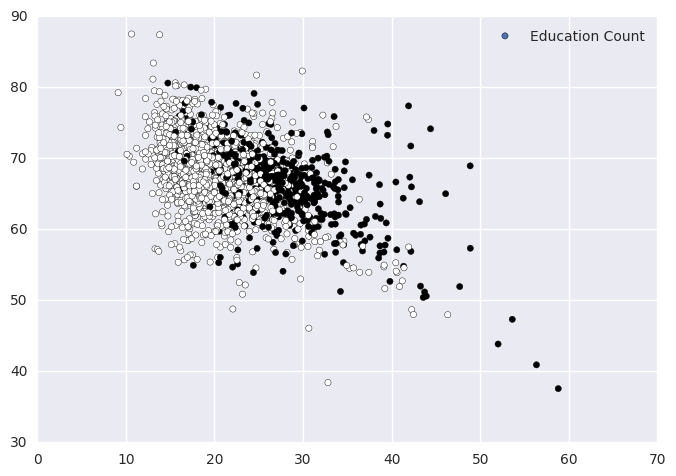

('Never Married', 'Less Than HS')


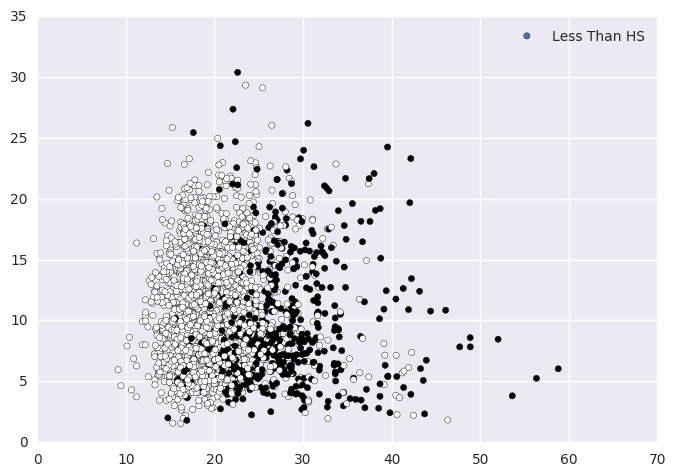

('Never Married', 'Graduate')


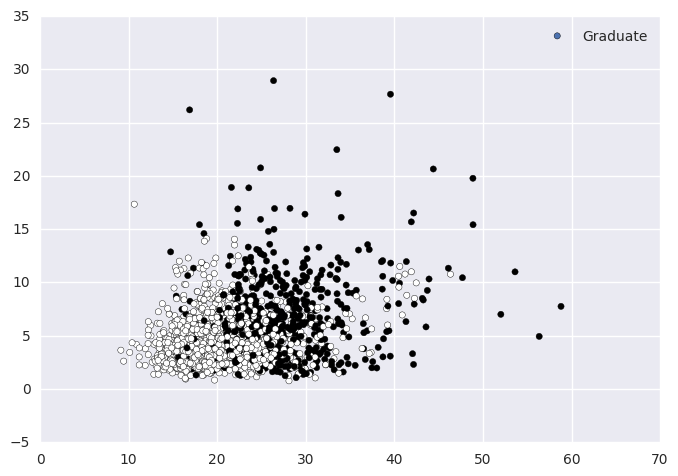

('Never Married', 'Other State-HS or equal')


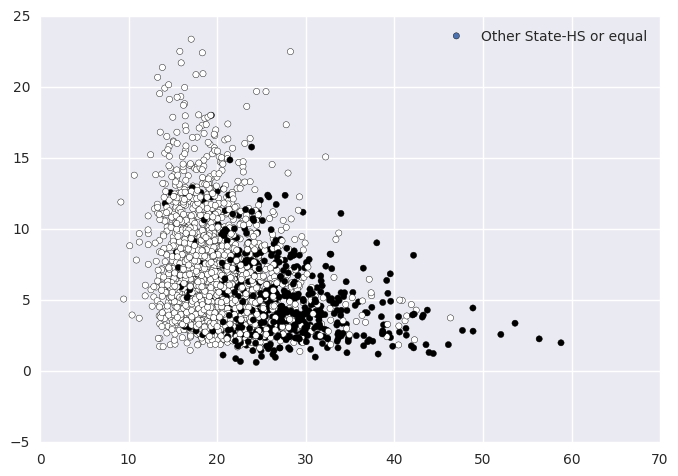

('Never Married', 'Other State-Graduate')


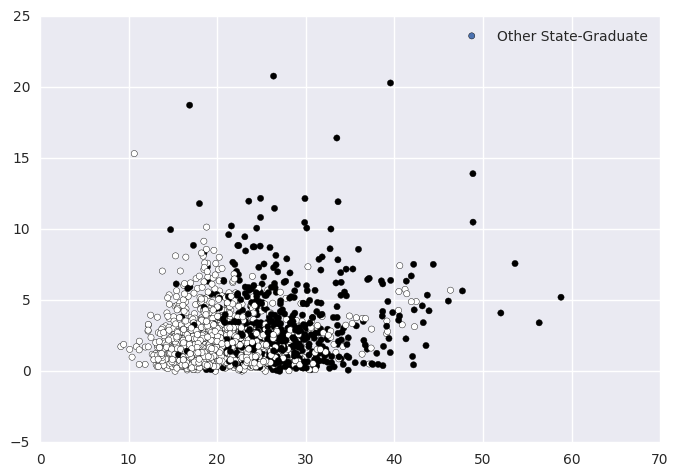

('Never Married', 'Total Reporing 0 Income')


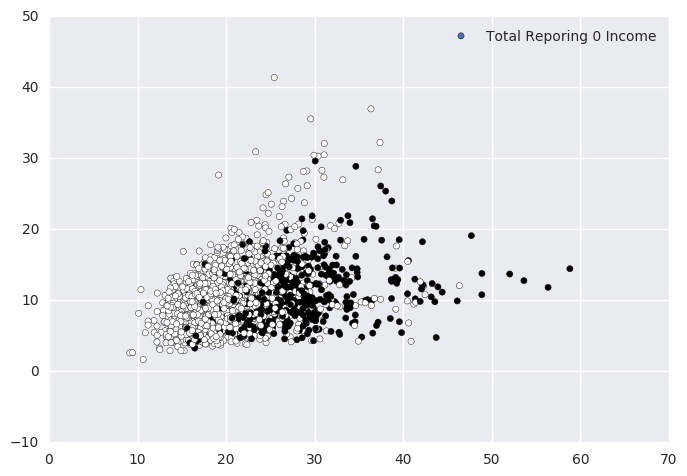

('Never Married', 'Income 35-50K')


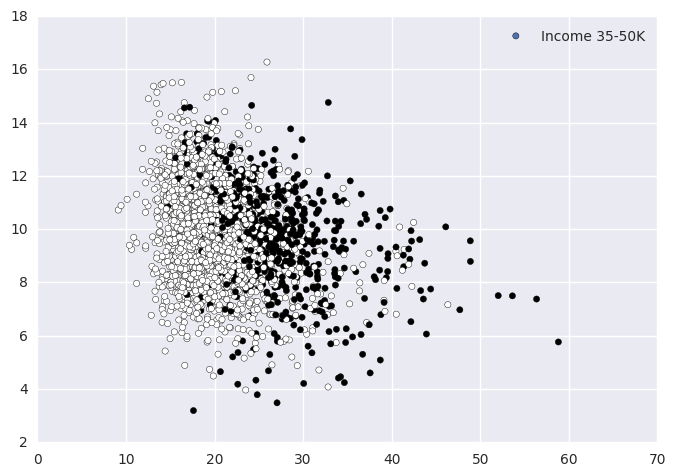

('Never Married', 'Income 50-65K')


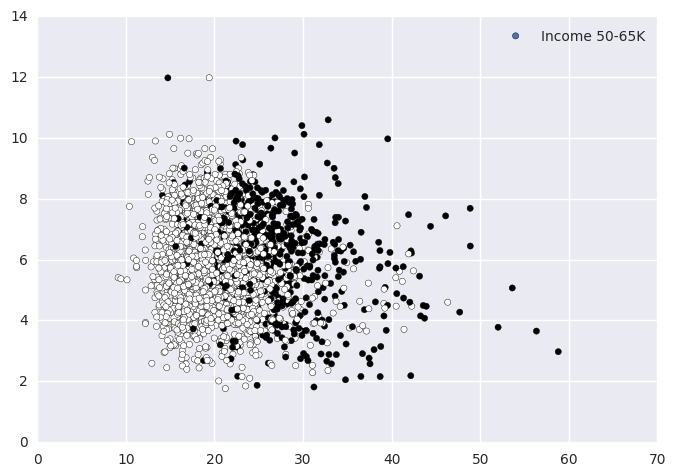

('Never Married', 'Median Income')


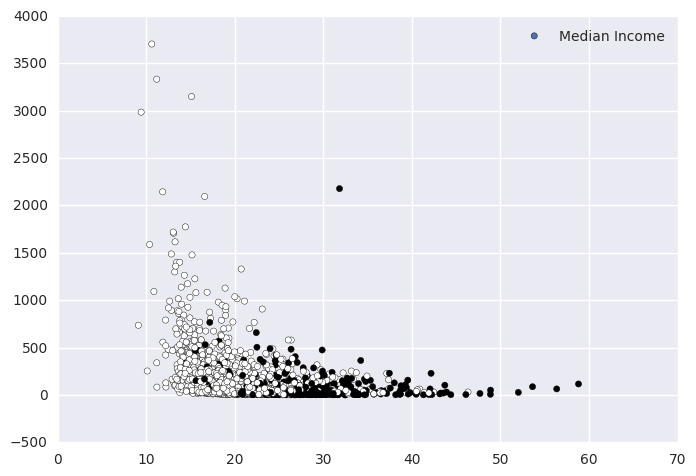

('Never Married', 'Median Income Born In State')


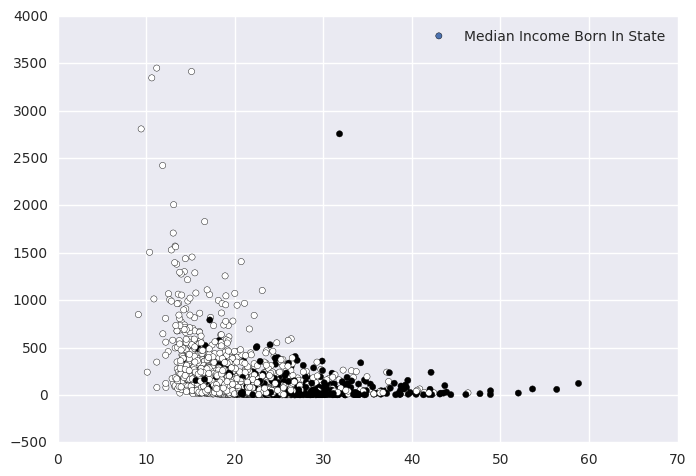

('Never Married', 'Median Income Born Other State')


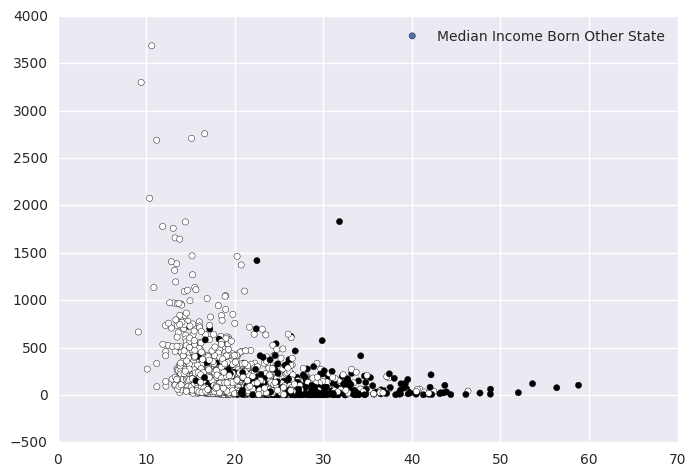

('Never Married', 'Median Income Born Outside US: Native')


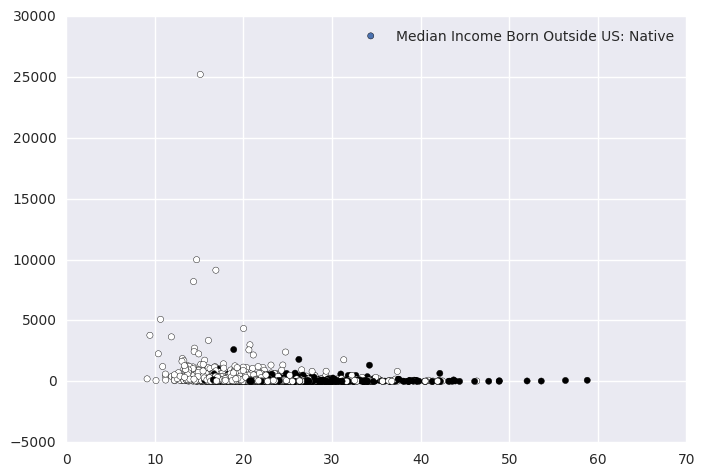

('Never Married', 'Median Income Foreign Born')


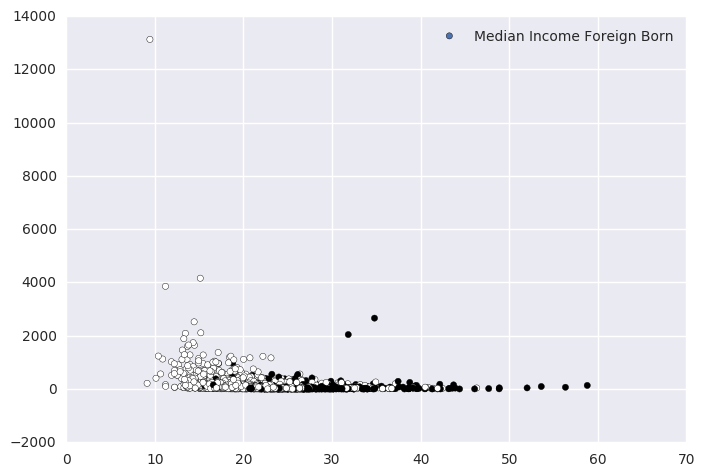

('Never Married', '100% below povery line')


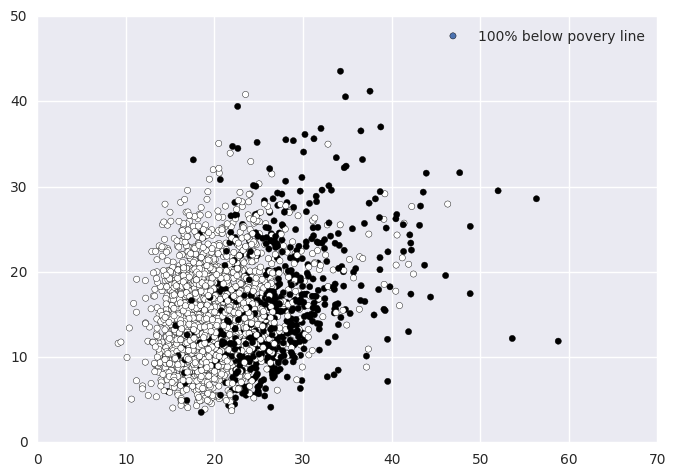

('Never Married', 'Same house 1 year ago')


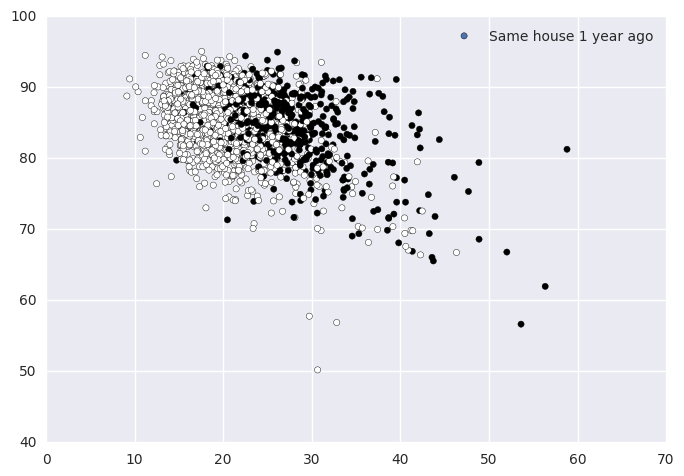

('Never Married', 'Moved Within Same State')


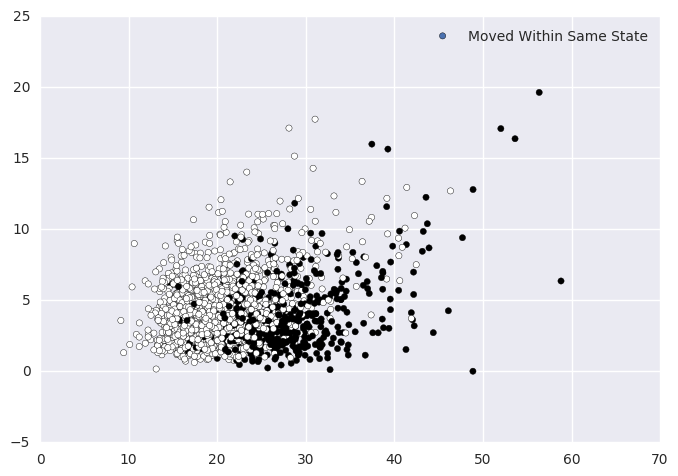

('Never Married', 'Same house 1 year ago White')


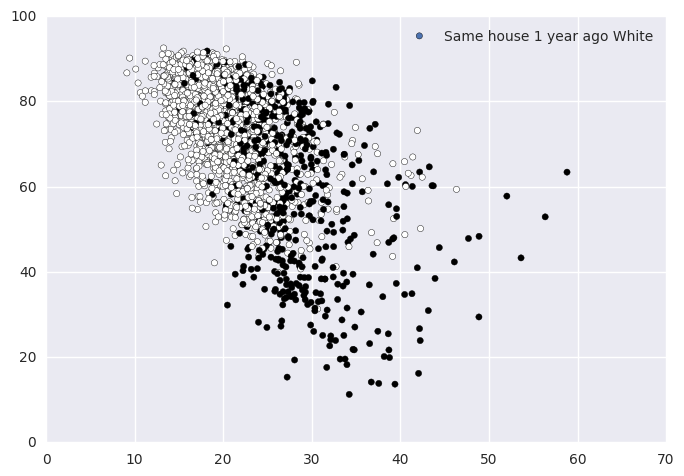

('Never Married', 'Walked')


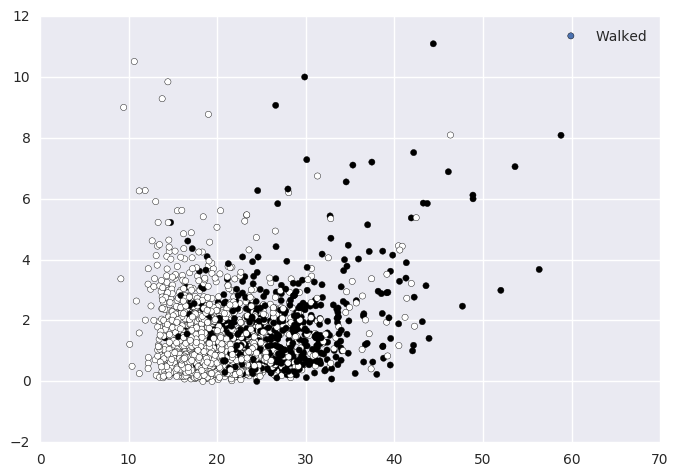

('Never Married', 'Work outside County')


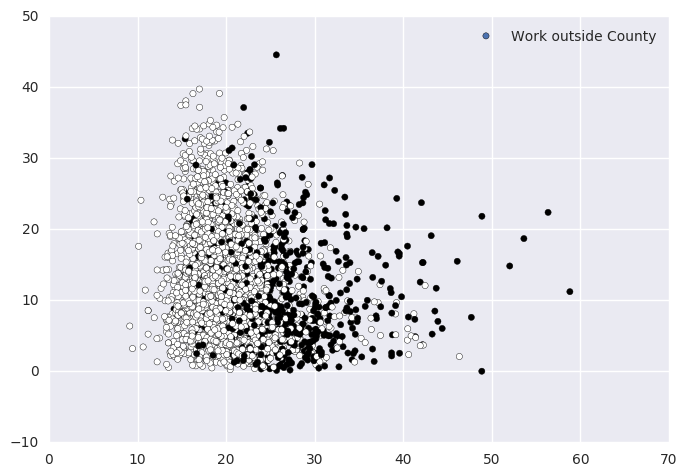

('Never Married', 'Work outside State')


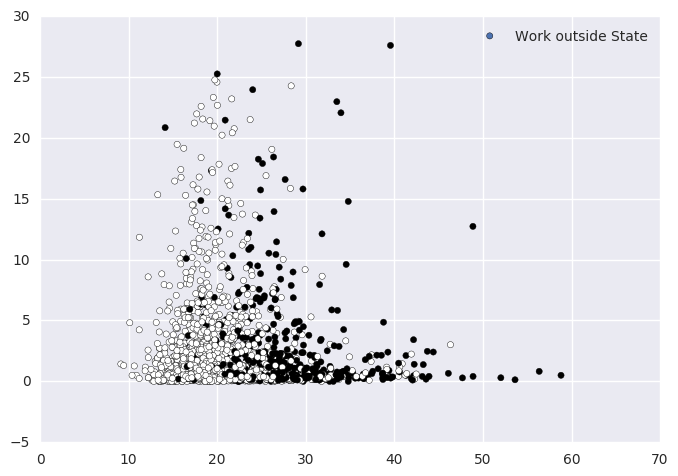

('Never Married', '2 vehicles')


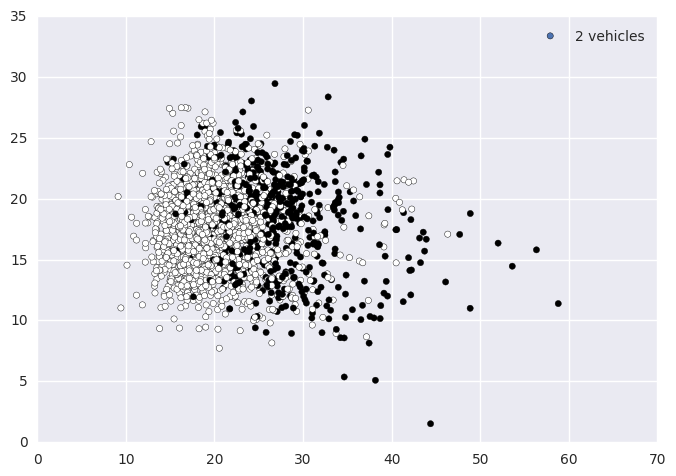

('Currently Married', 'Education Count')


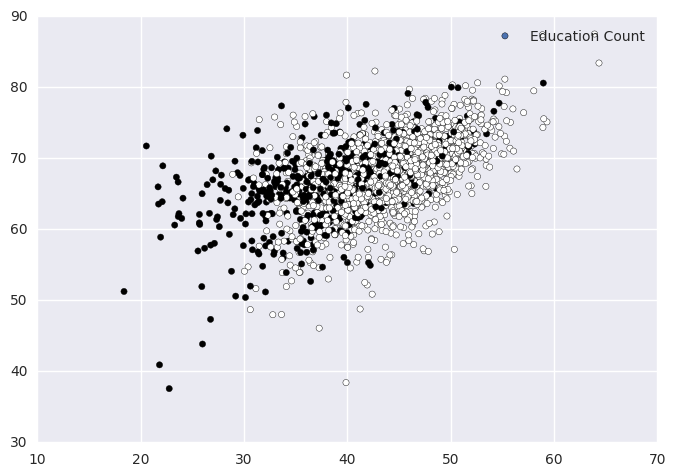

('Currently Married', 'Less Than HS')


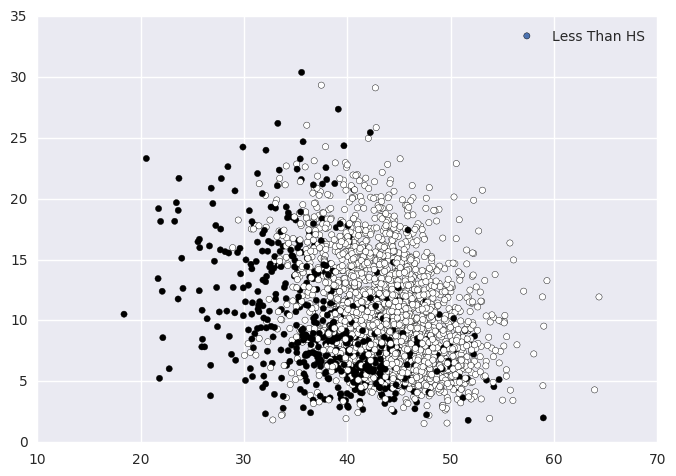

('Currently Married', 'Graduate')


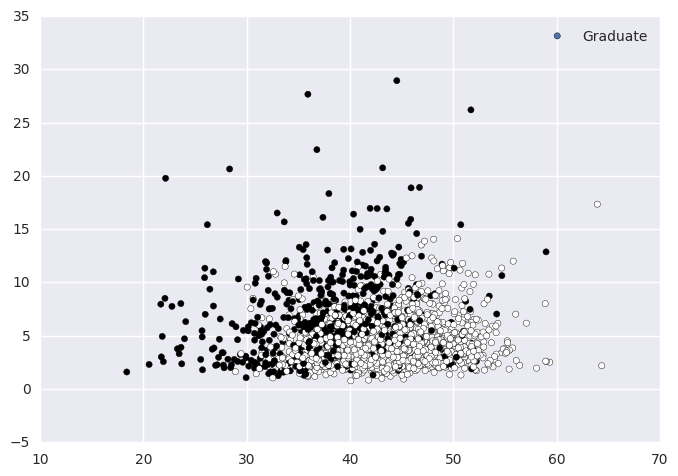

('Currently Married', 'Other State-HS or equal')


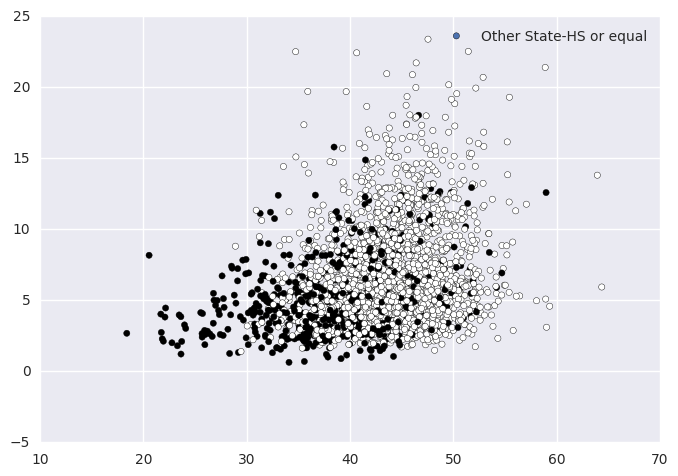

('Currently Married', 'Other State-Graduate')


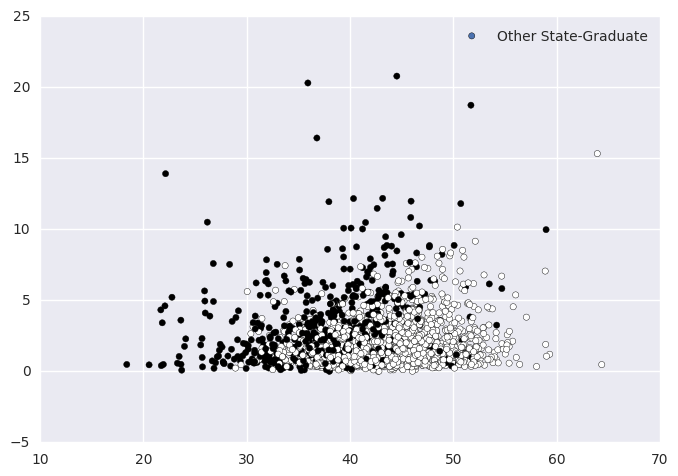

('Currently Married', 'Total Reporing 0 Income')


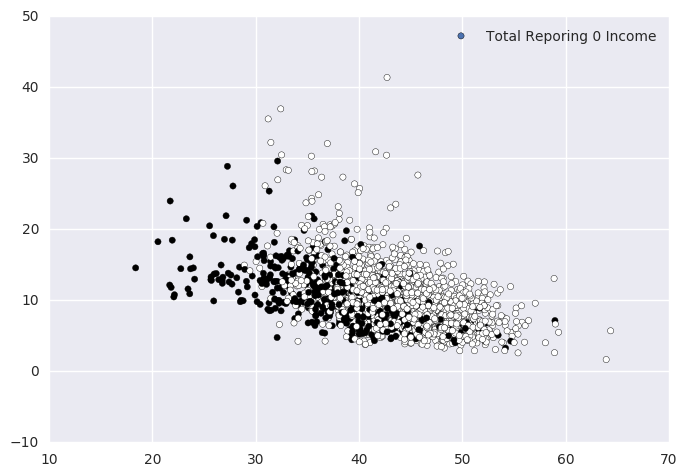

('Currently Married', 'Income 35-50K')


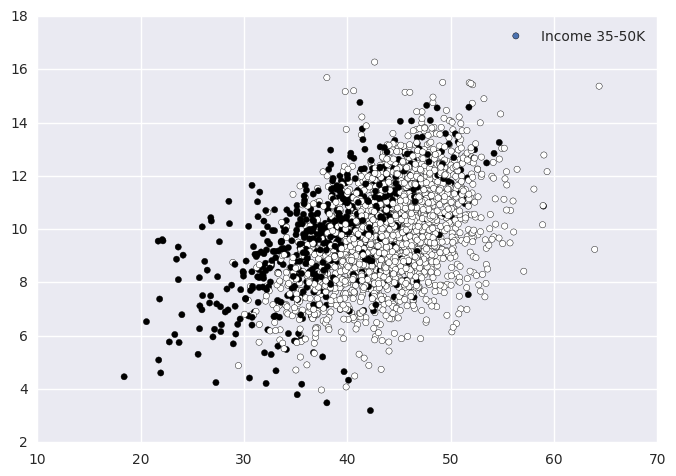

('Currently Married', 'Income 50-65K')


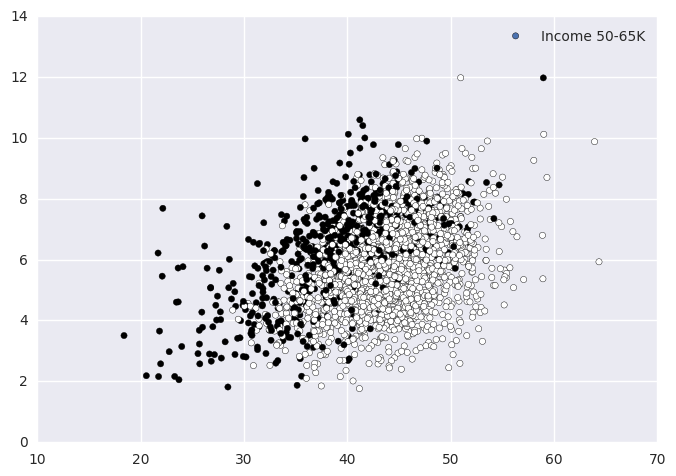

('Currently Married', 'Median Income')


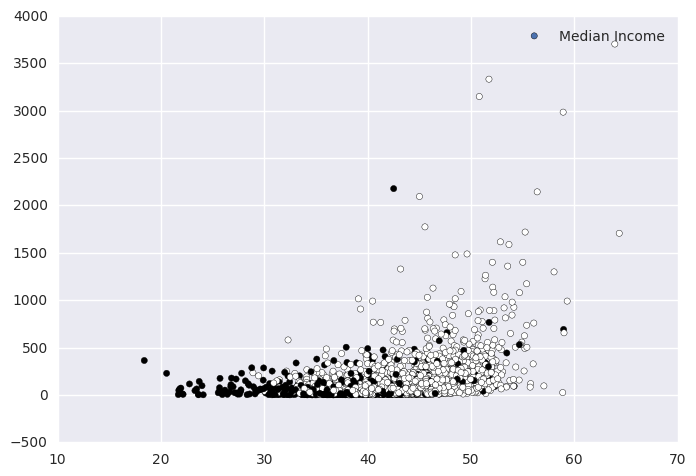

('Currently Married', 'Median Income Born In State')


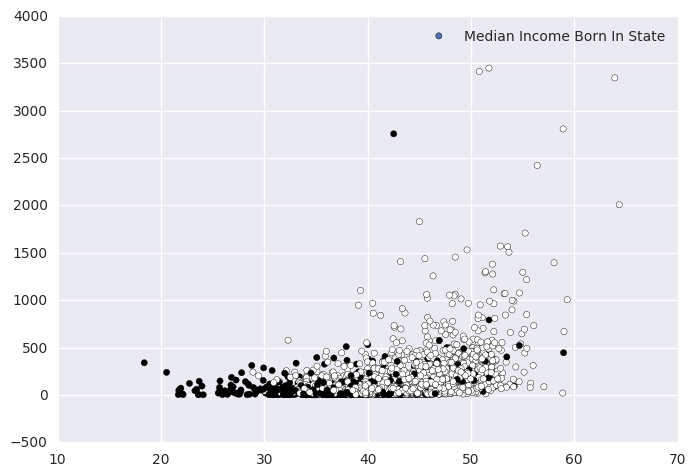

('Currently Married', 'Median Income Born Other State')


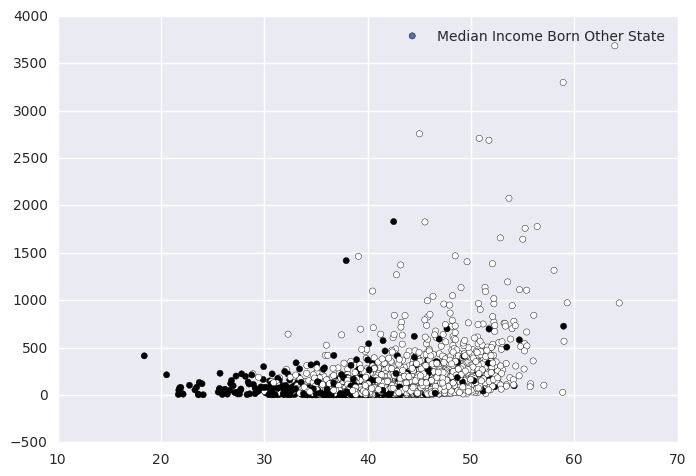

('Currently Married', 'Median Income Born Outside US: Native')


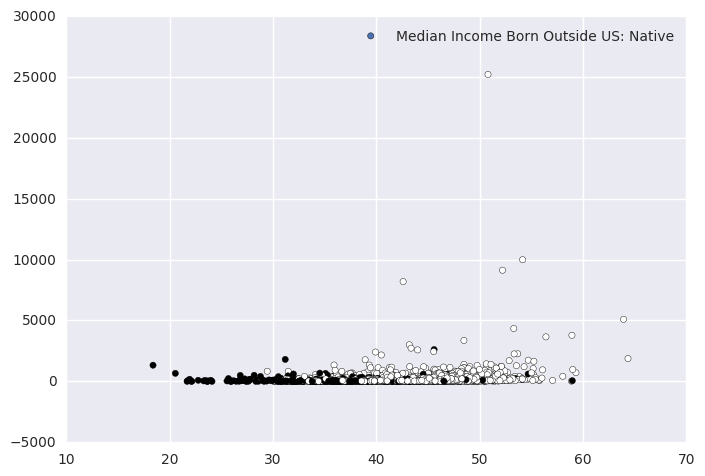

('Currently Married', 'Median Income Foreign Born')


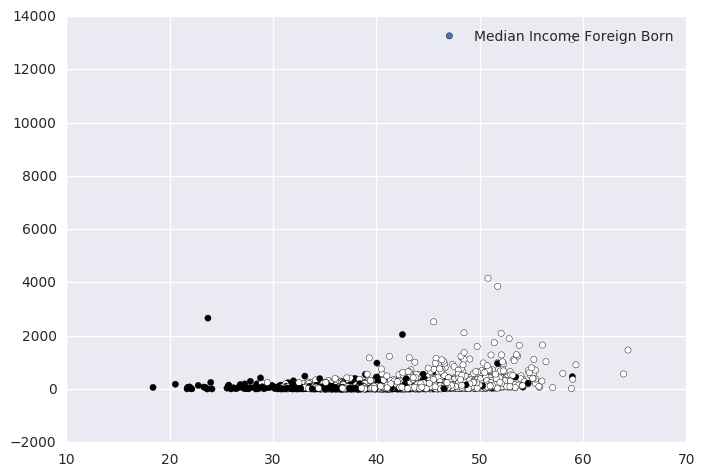

('Currently Married', '100% below povery line')


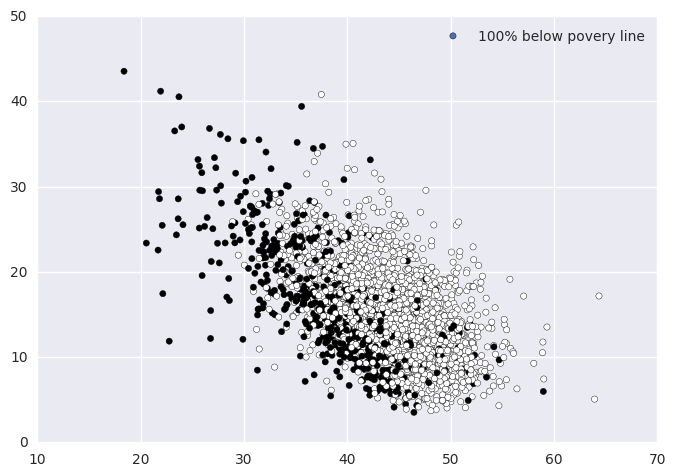

('Currently Married', 'Same house 1 year ago')


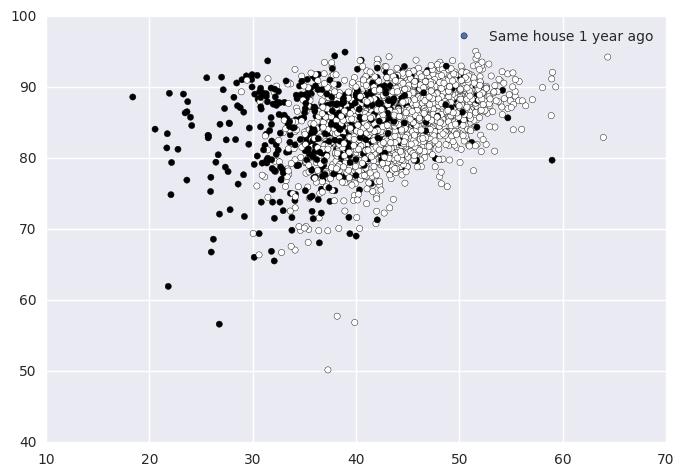

('Currently Married', 'Moved Within Same State')


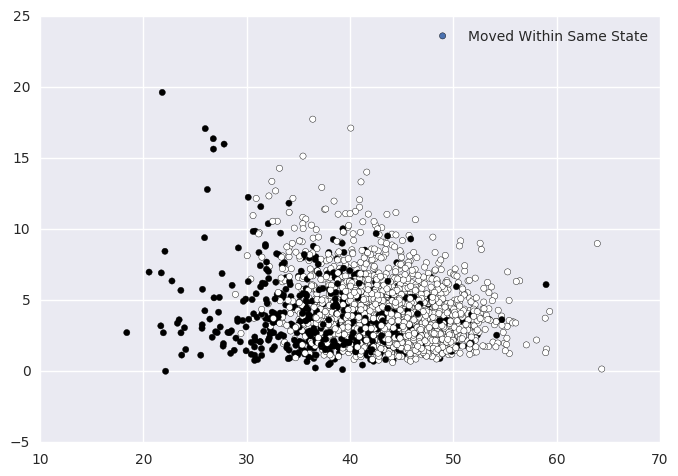

('Currently Married', 'Same house 1 year ago White')


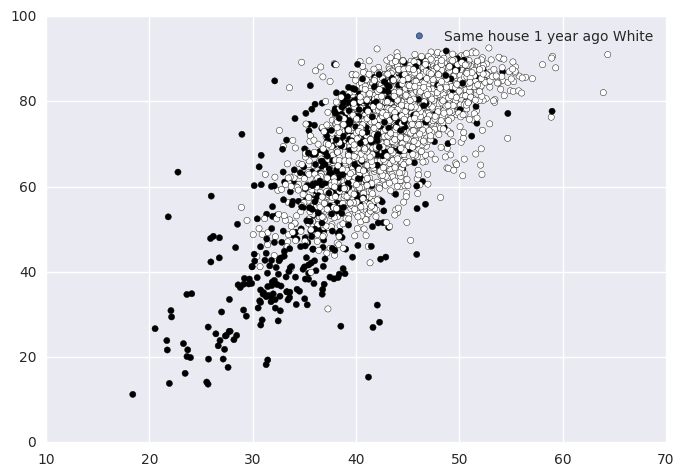

('Currently Married', 'Walked')


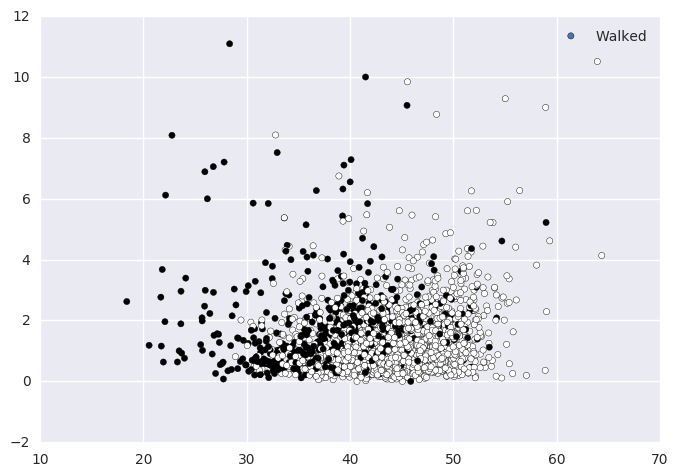

('Currently Married', 'Work outside County')


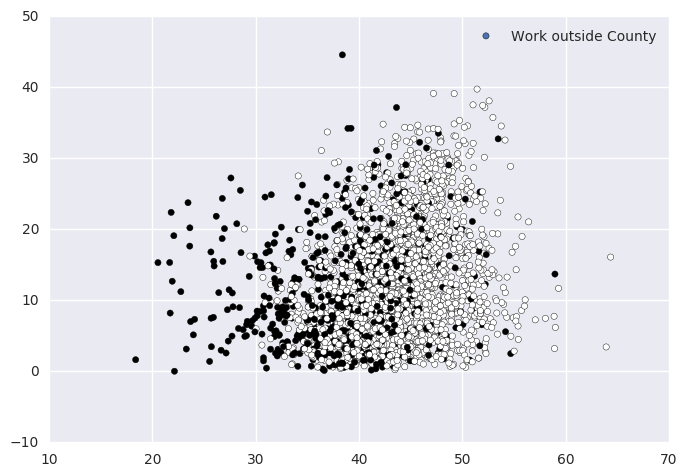

('Currently Married', 'Work outside State')


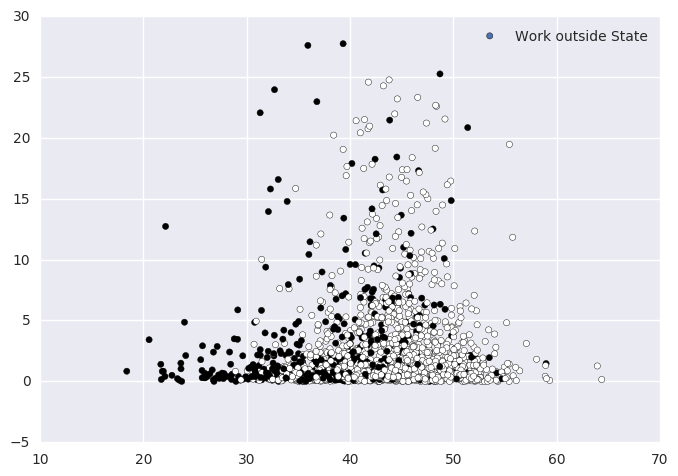

('Currently Married', '2 vehicles')


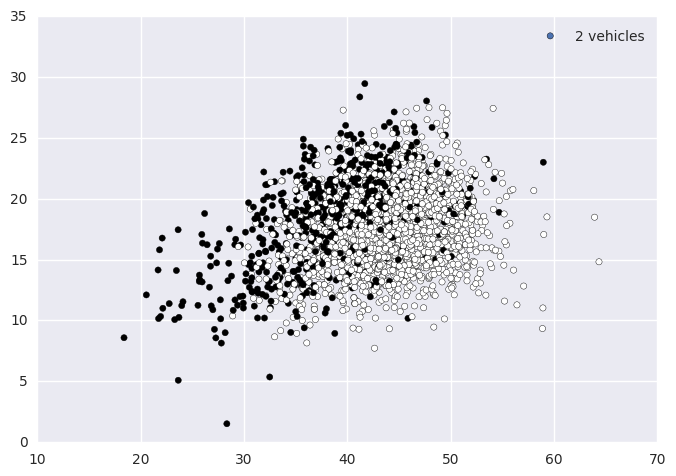

('Education Count', 'Less Than HS')


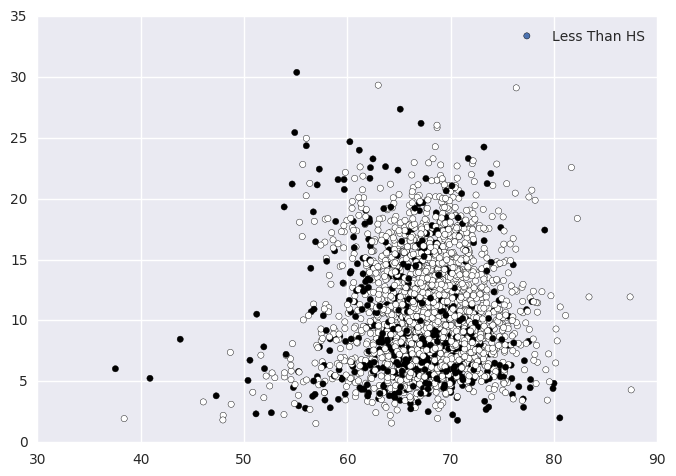

('Education Count', 'Graduate')


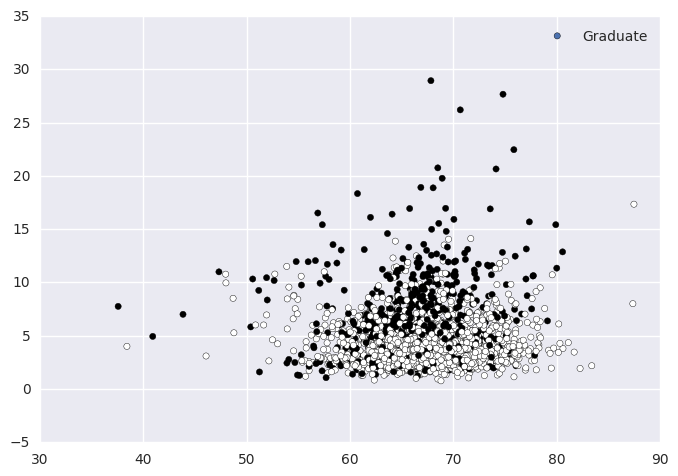

('Education Count', 'Other State-HS or equal')


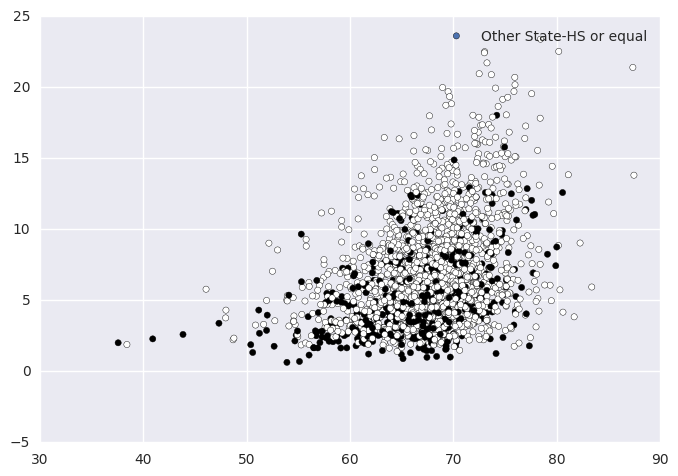

('Education Count', 'Other State-Graduate')


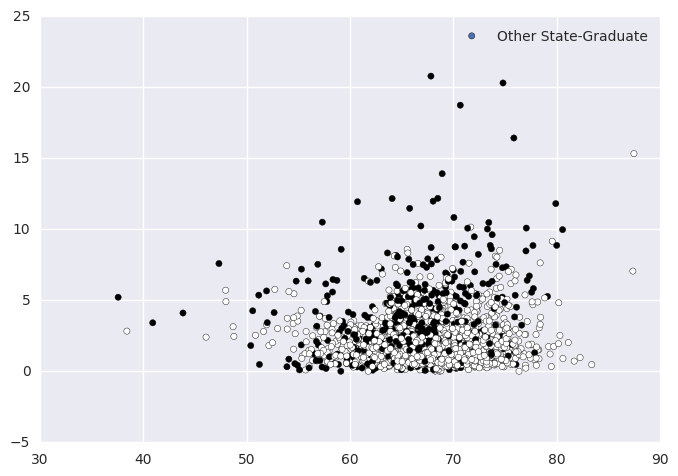

('Education Count', 'Total Reporing 0 Income')


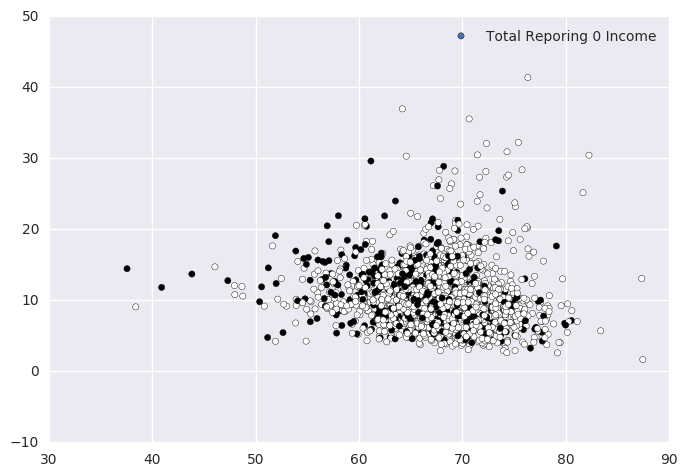

('Education Count', 'Income 35-50K')


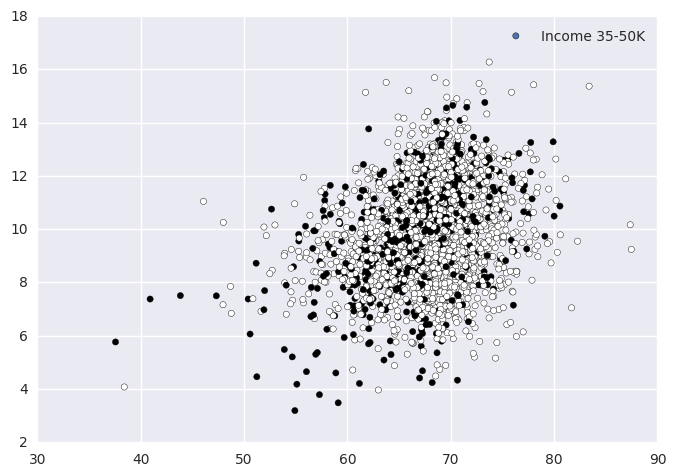

('Education Count', 'Income 50-65K')


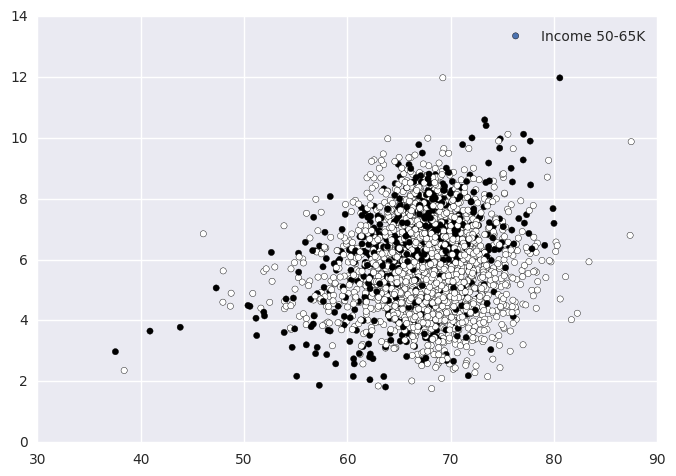

('Education Count', 'Median Income')


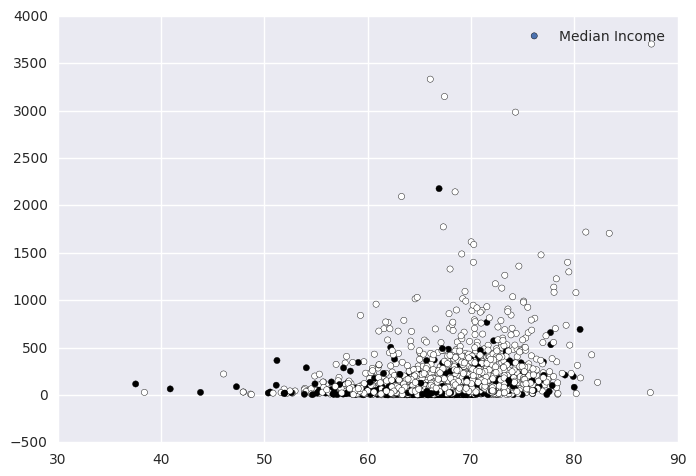

('Education Count', 'Median Income Born In State')


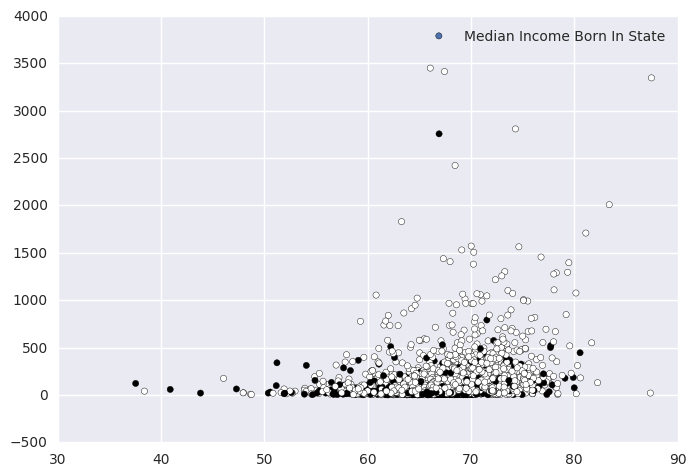

('Education Count', 'Median Income Born Other State')


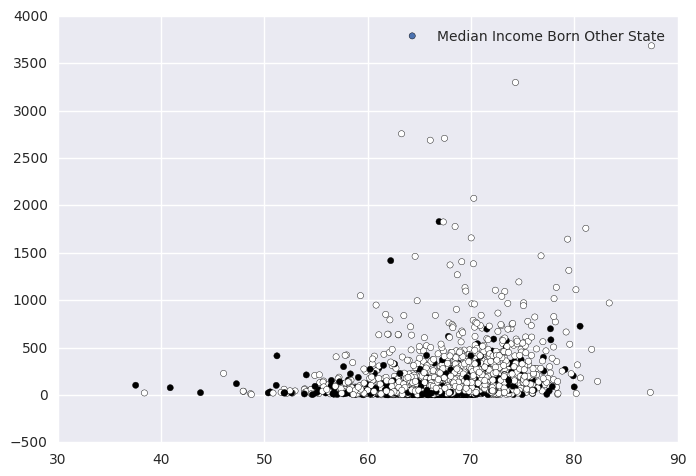

('Education Count', 'Median Income Born Outside US: Native')


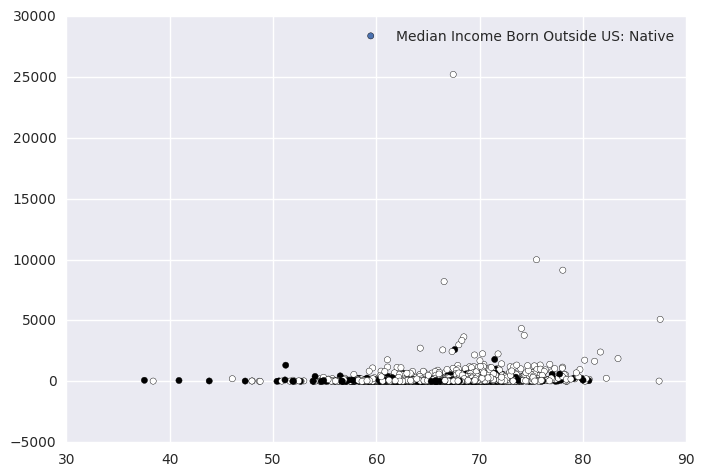

('Education Count', 'Median Income Foreign Born')


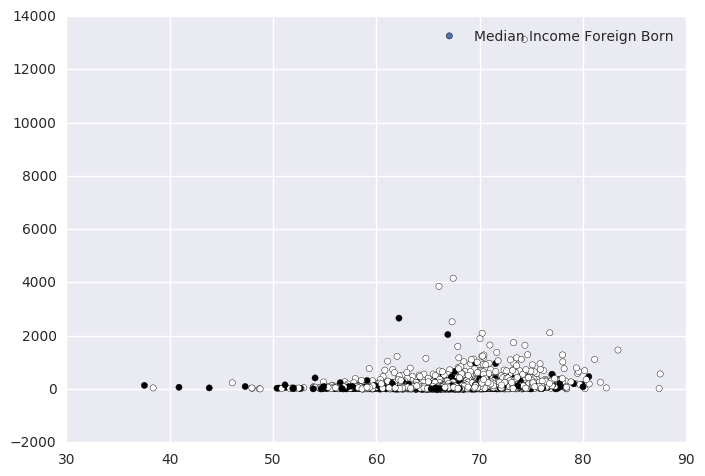

('Education Count', '100% below povery line')


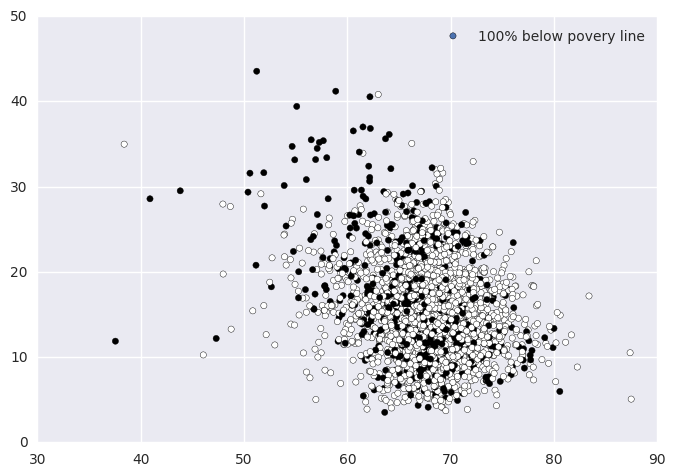

('Education Count', 'Same house 1 year ago')


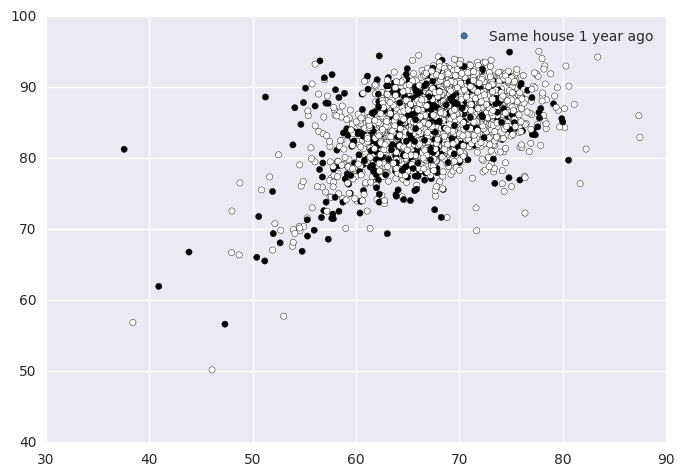

('Education Count', 'Moved Within Same State')


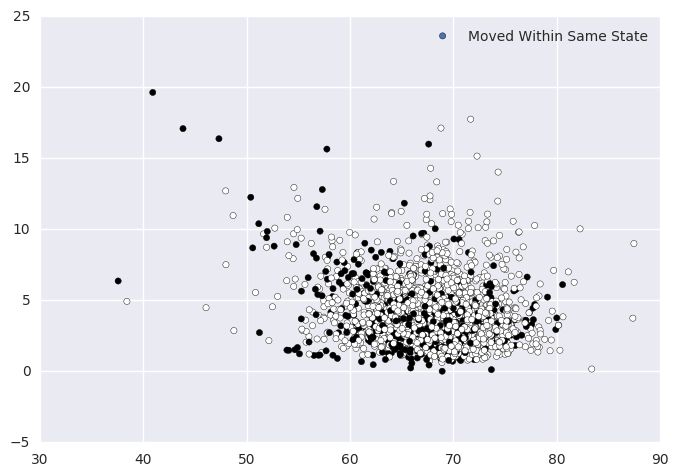

('Education Count', 'Same house 1 year ago White')


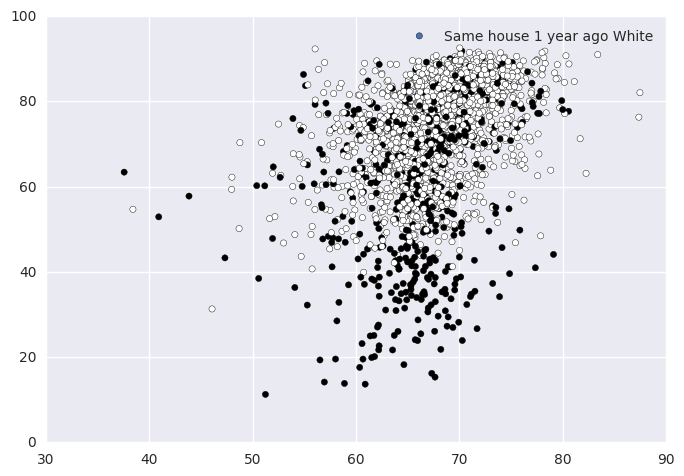

('Education Count', 'Walked')


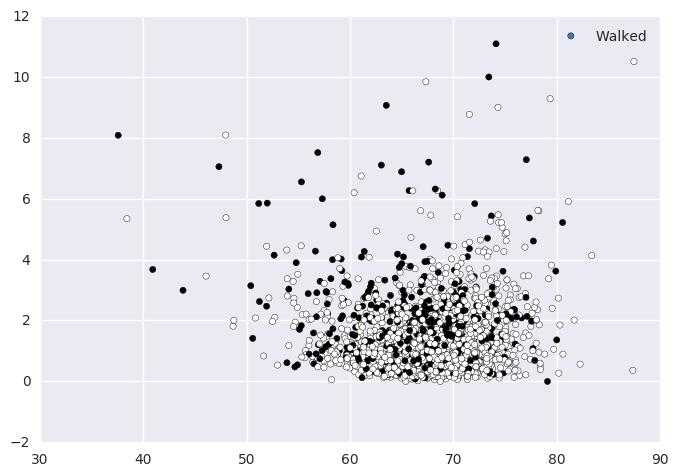

('Education Count', 'Work outside County')


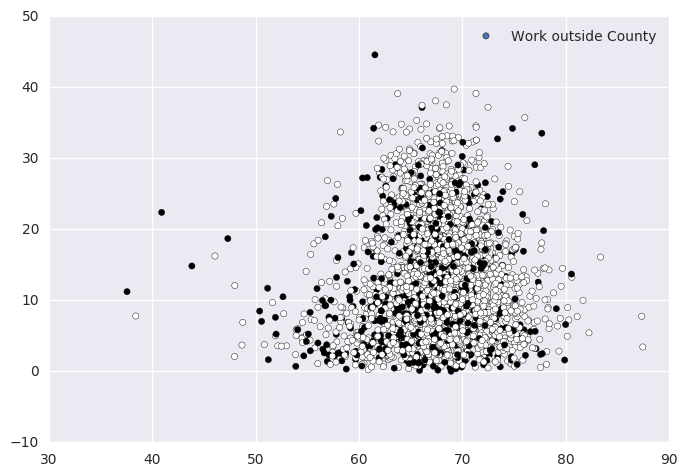

('Education Count', 'Work outside State')


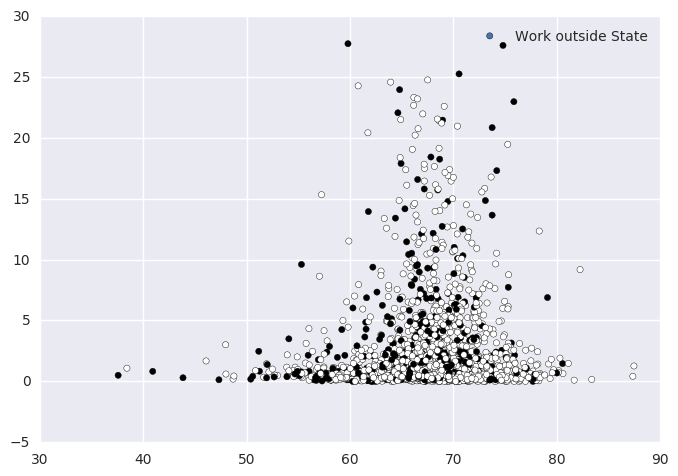

('Education Count', '2 vehicles')


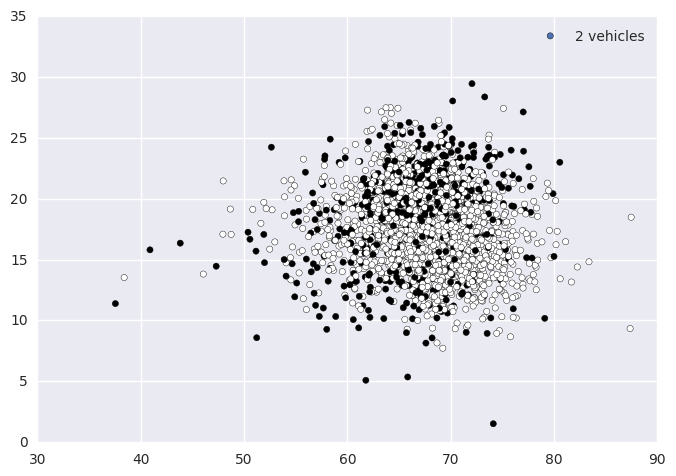

('Less Than HS', 'Graduate')


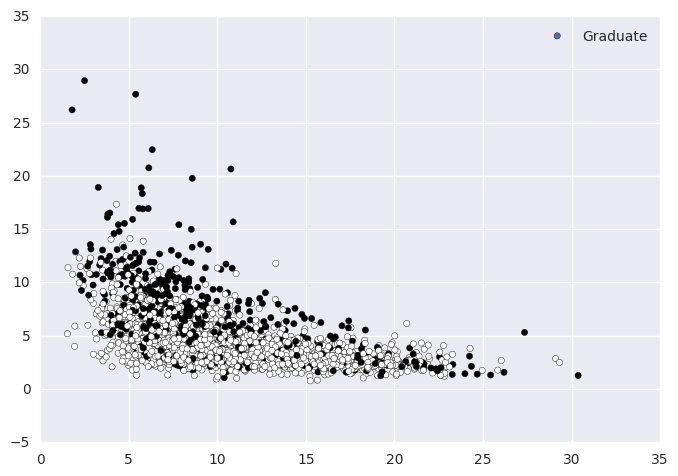

('Less Than HS', 'Other State-HS or equal')


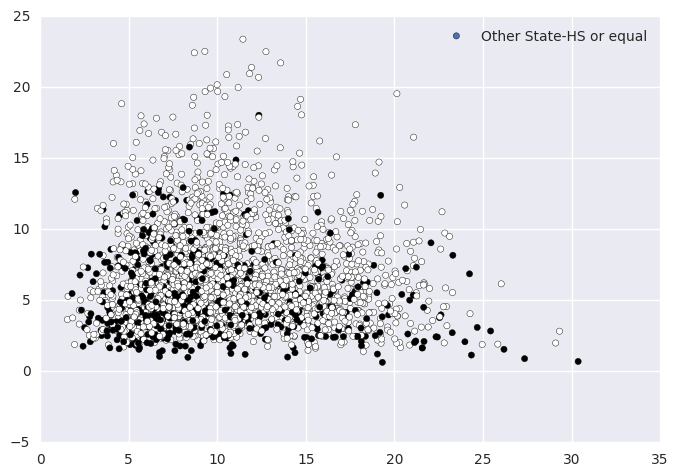

('Less Than HS', 'Other State-Graduate')


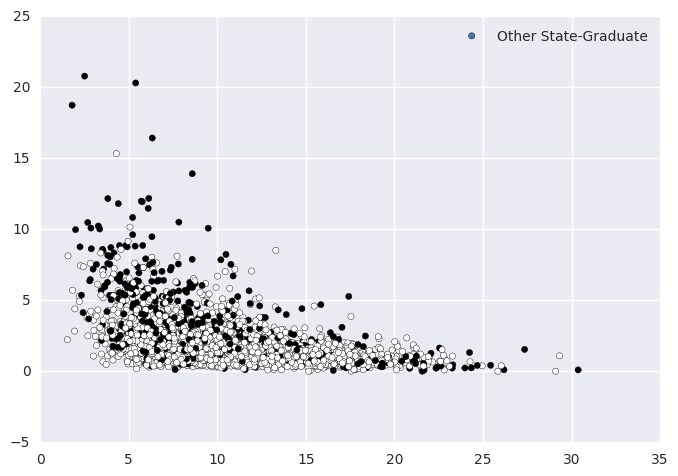

('Less Than HS', 'Total Reporing 0 Income')


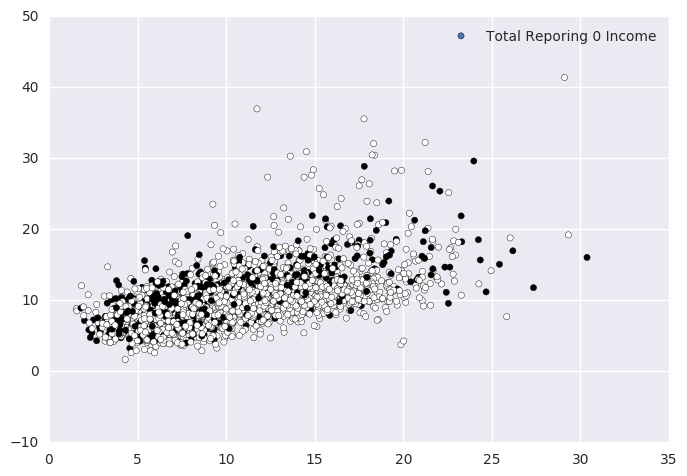

('Less Than HS', 'Income 35-50K')


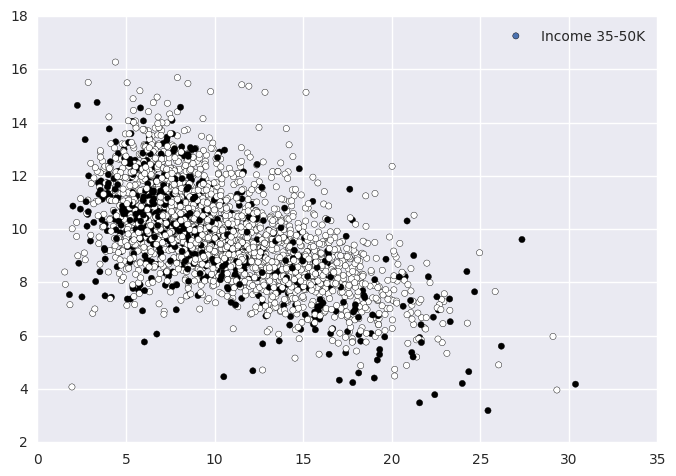

('Less Than HS', 'Income 50-65K')


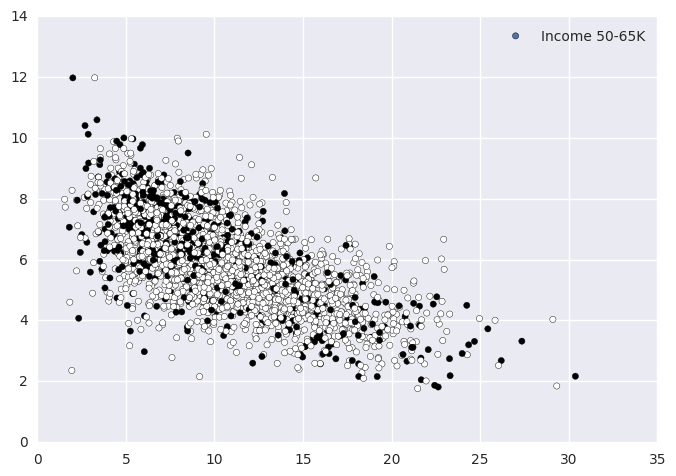

('Less Than HS', 'Median Income')


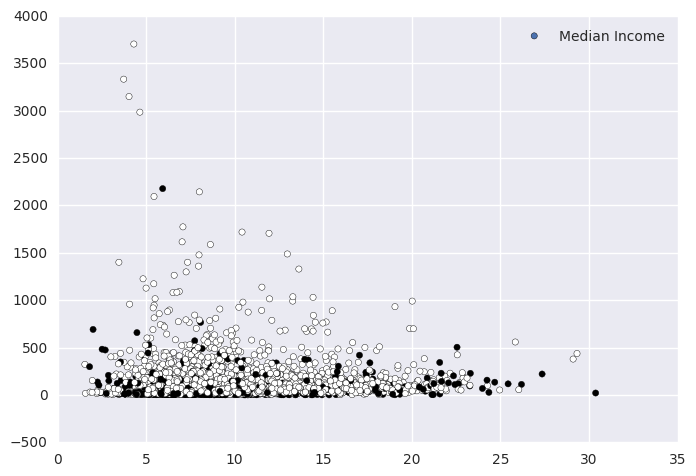

('Less Than HS', 'Median Income Born In State')


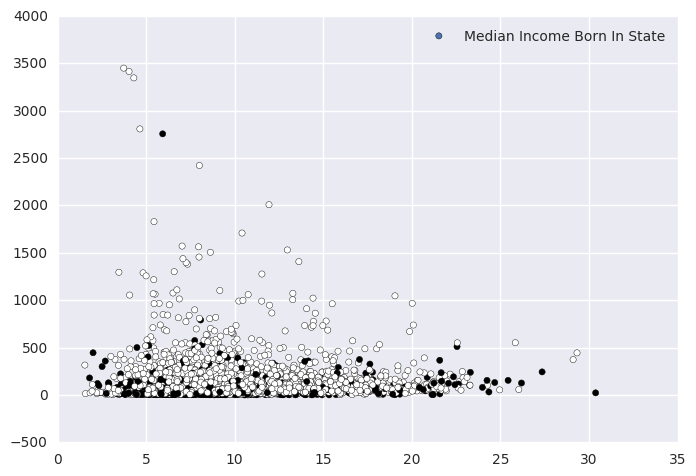

('Less Than HS', 'Median Income Born Other State')


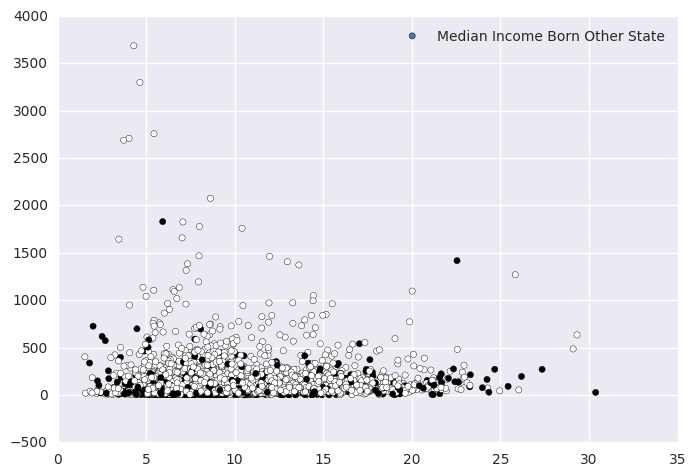

('Less Than HS', 'Median Income Born Outside US: Native')


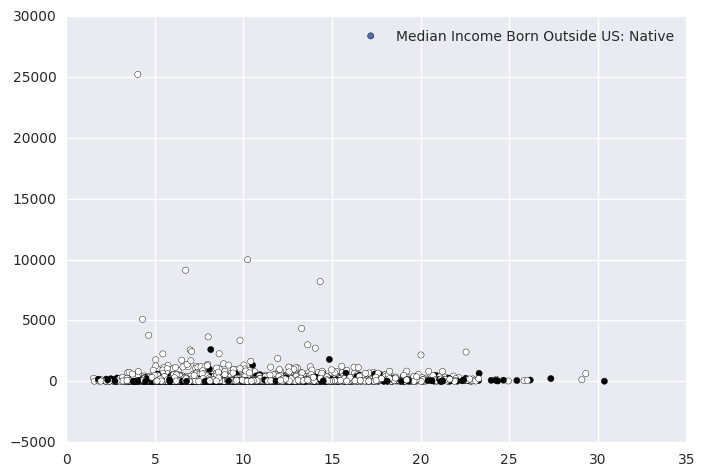

('Less Than HS', 'Median Income Foreign Born')


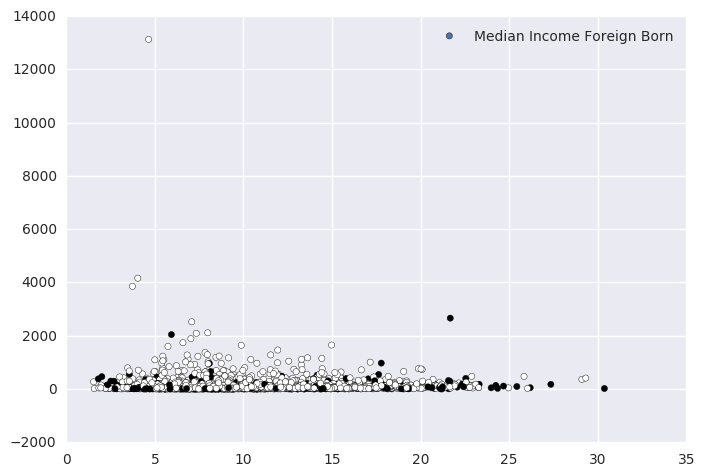

('Less Than HS', '100% below povery line')


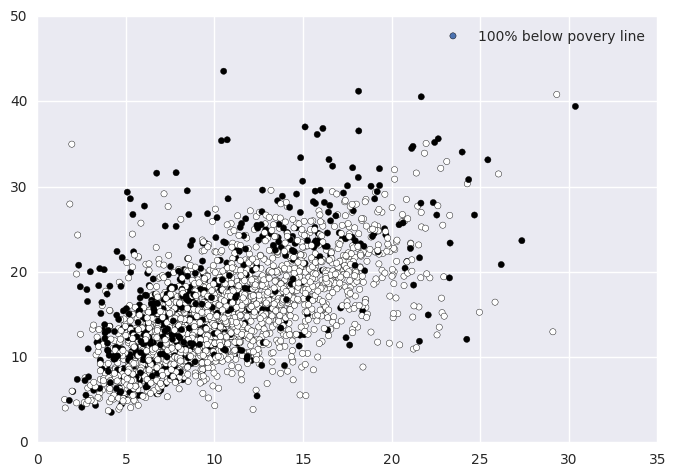

('Less Than HS', 'Same house 1 year ago')


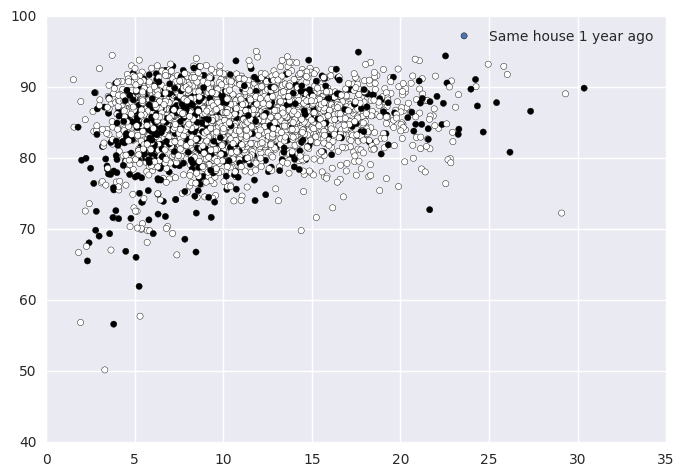

('Less Than HS', 'Moved Within Same State')


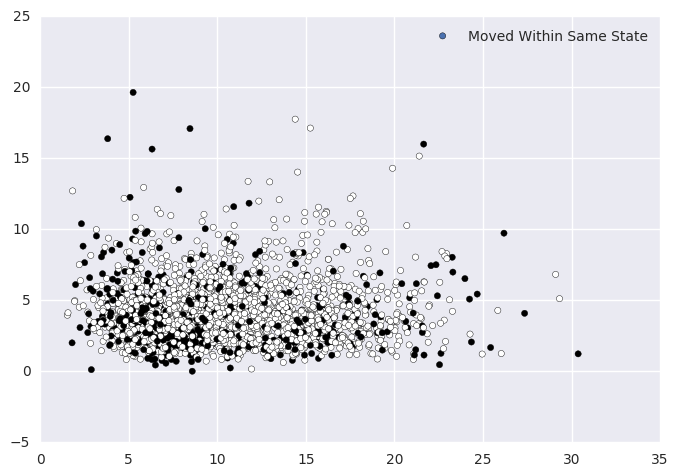

('Less Than HS', 'Same house 1 year ago White')


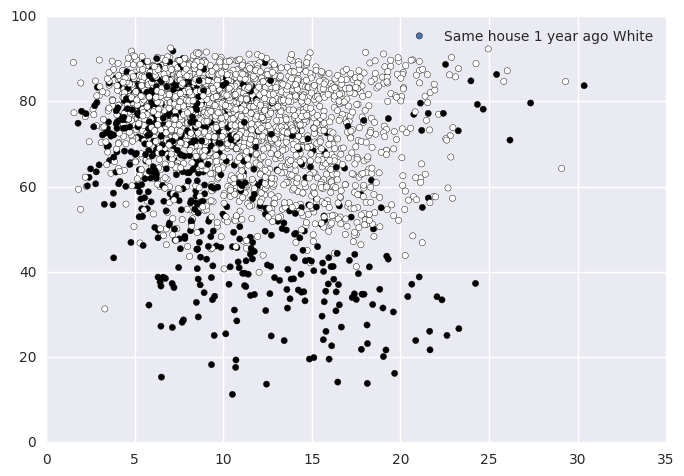

('Less Than HS', 'Walked')


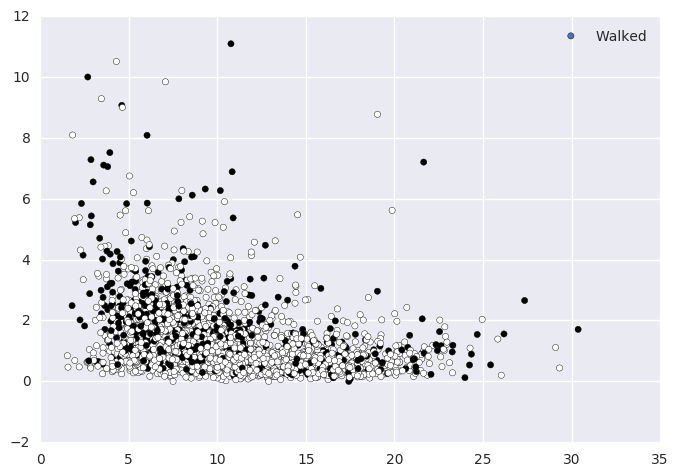

('Less Than HS', 'Work outside County')


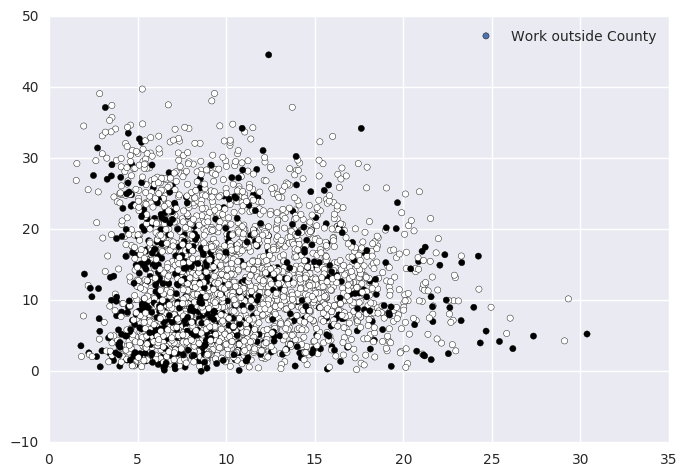

('Less Than HS', 'Work outside State')


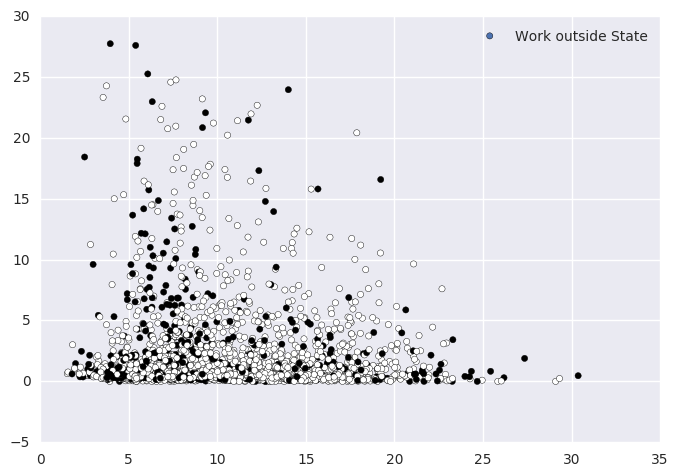

('Less Than HS', '2 vehicles')


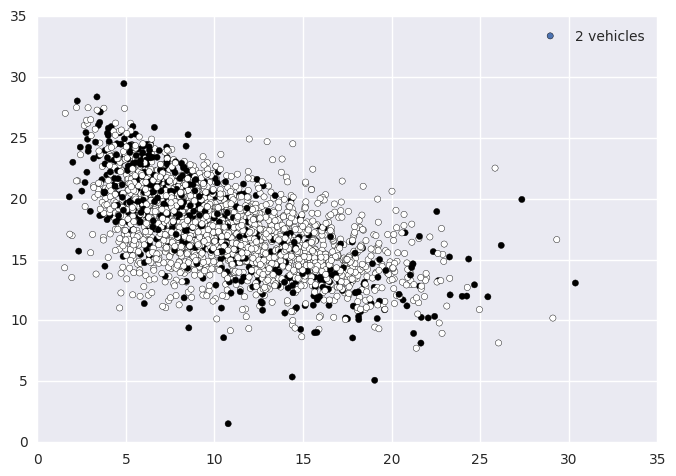

('Graduate', 'Other State-HS or equal')


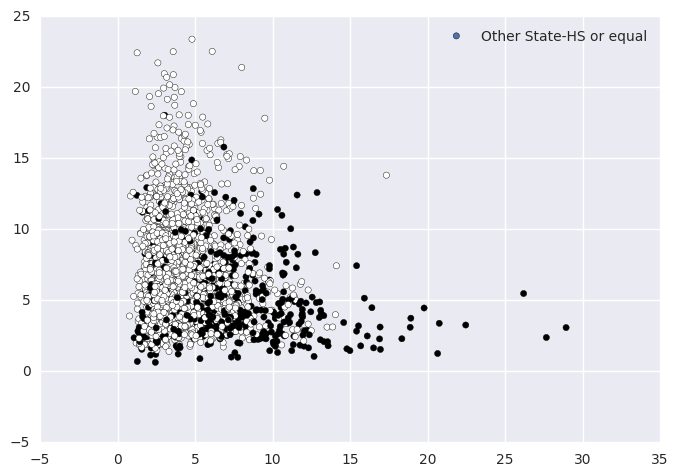

('Graduate', 'Other State-Graduate')


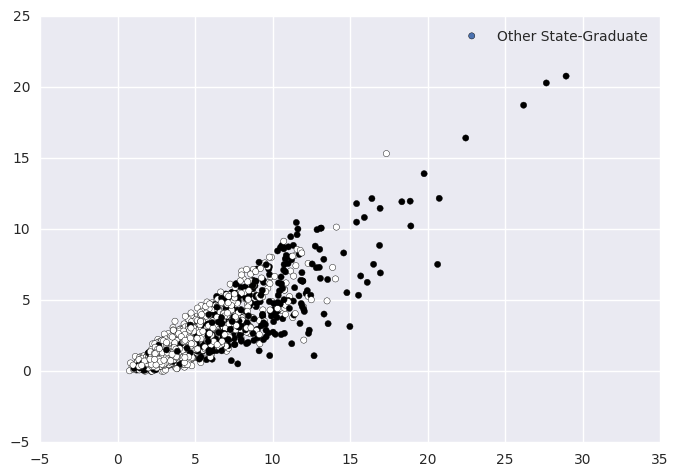

('Graduate', 'Total Reporing 0 Income')


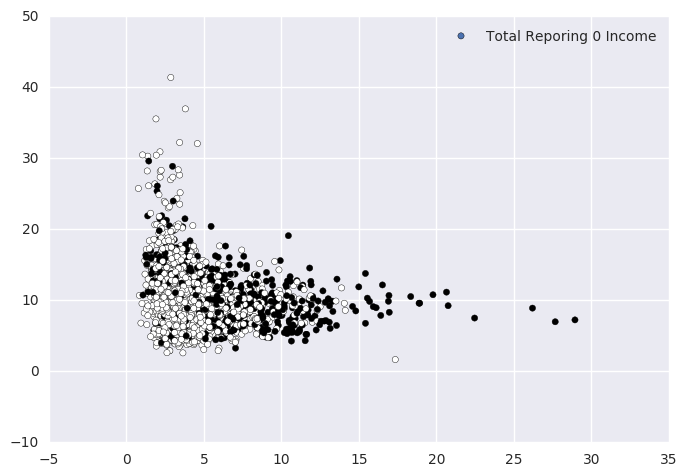

('Graduate', 'Income 35-50K')


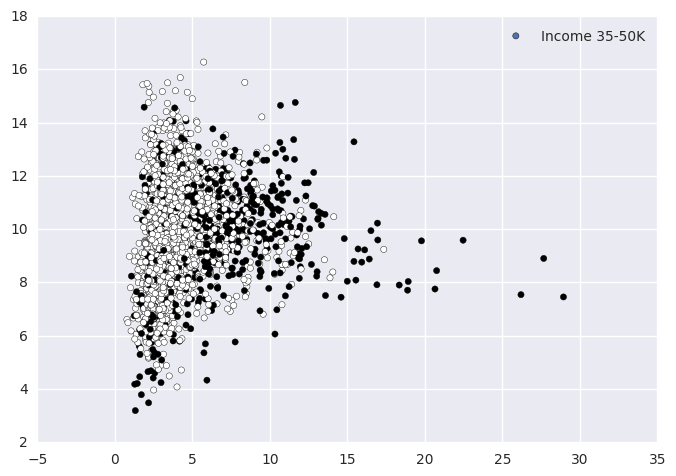

('Graduate', 'Income 50-65K')


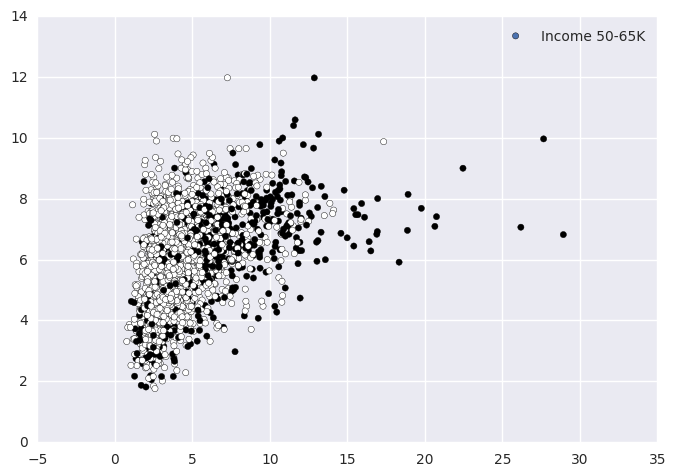

('Graduate', 'Median Income')


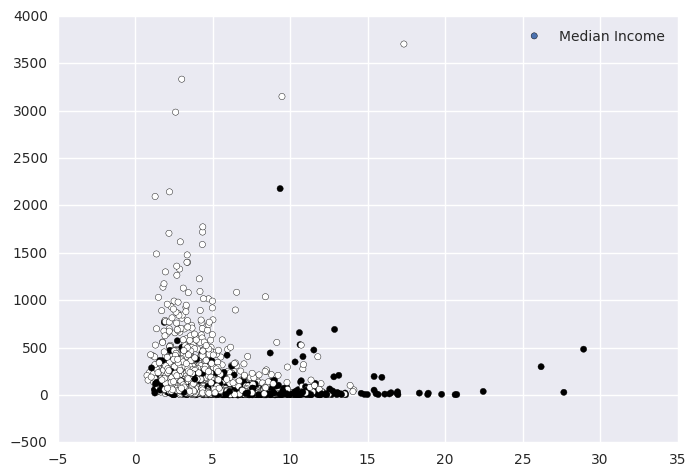

('Graduate', 'Median Income Born In State')


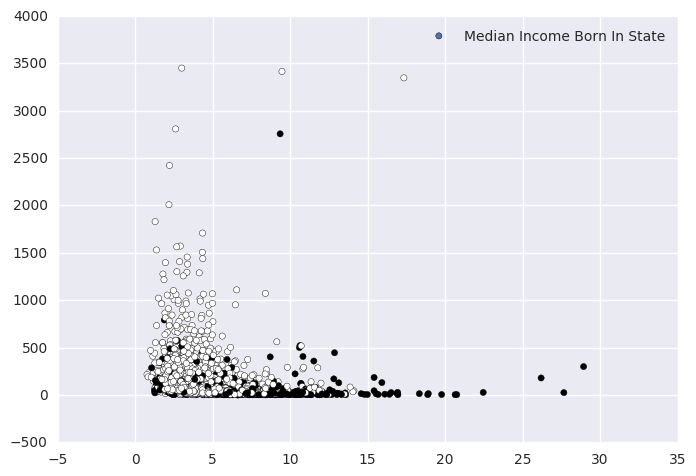

('Graduate', 'Median Income Born Other State')


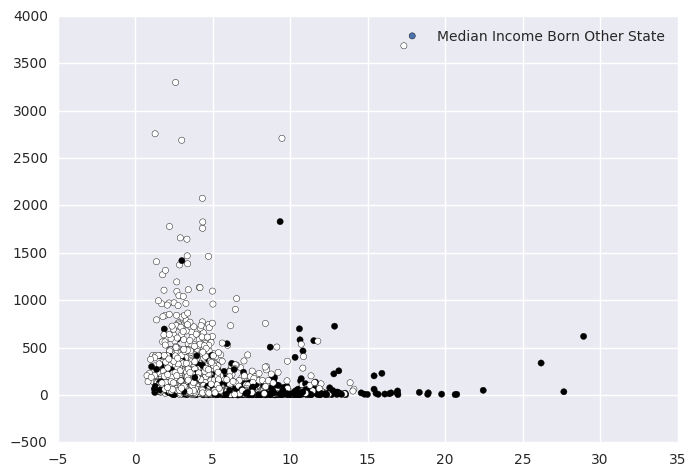

('Graduate', 'Median Income Born Outside US: Native')


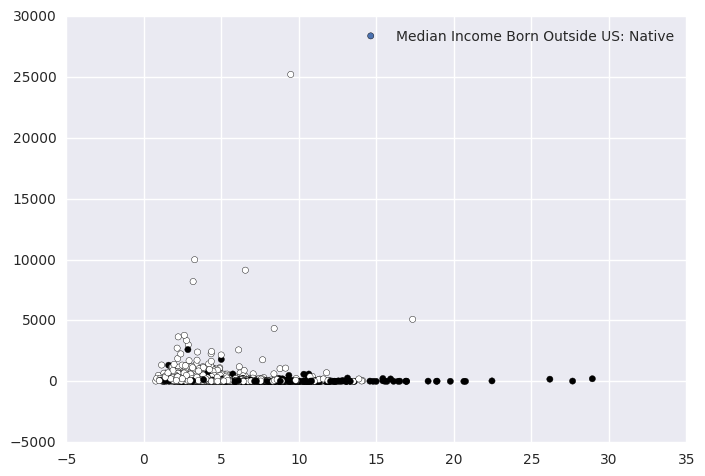

('Graduate', 'Median Income Foreign Born')


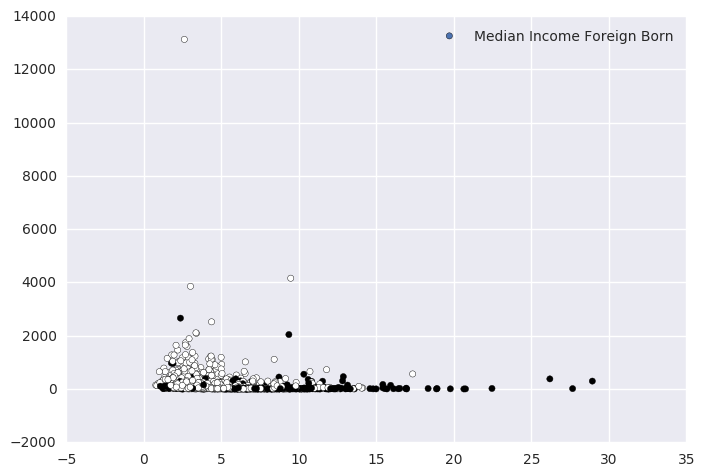

('Graduate', '100% below povery line')


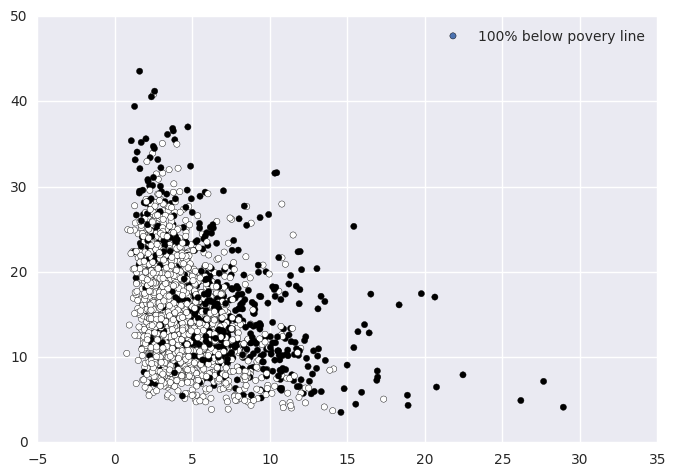

('Graduate', 'Same house 1 year ago')


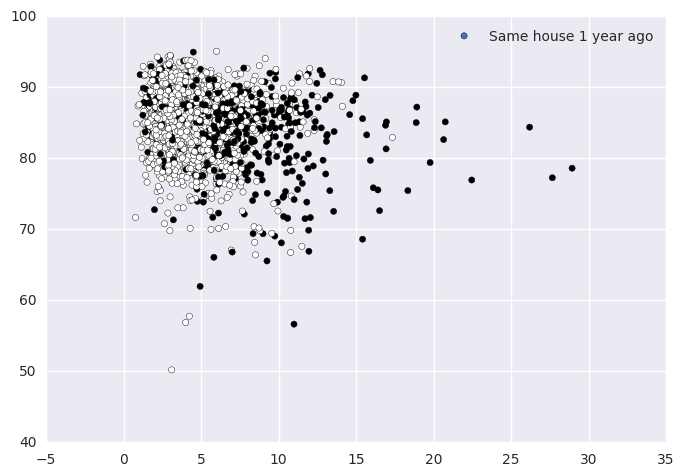

('Graduate', 'Moved Within Same State')


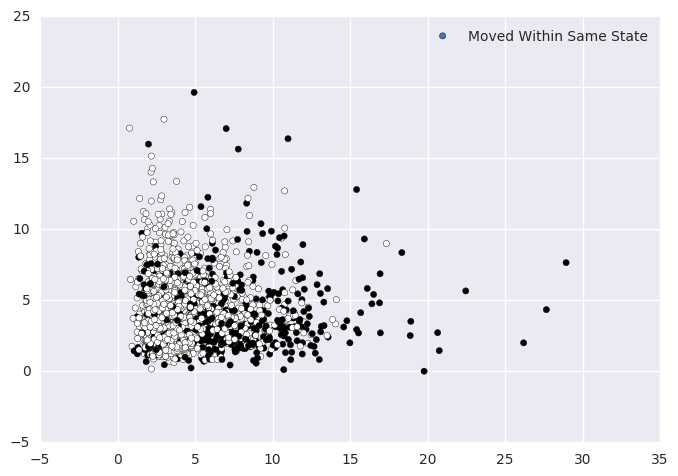

('Graduate', 'Same house 1 year ago White')


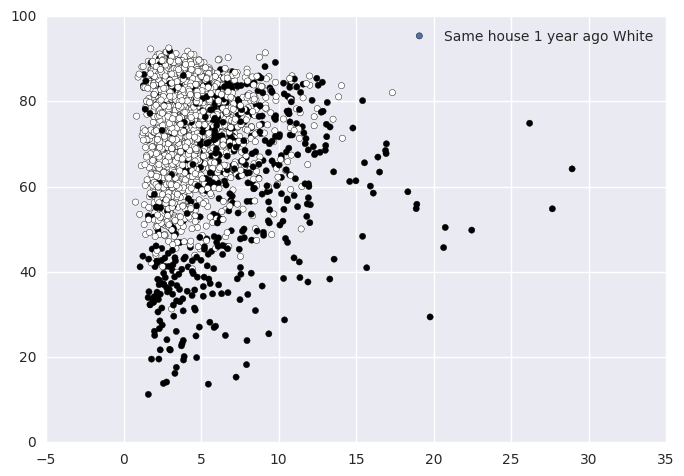

('Graduate', 'Walked')


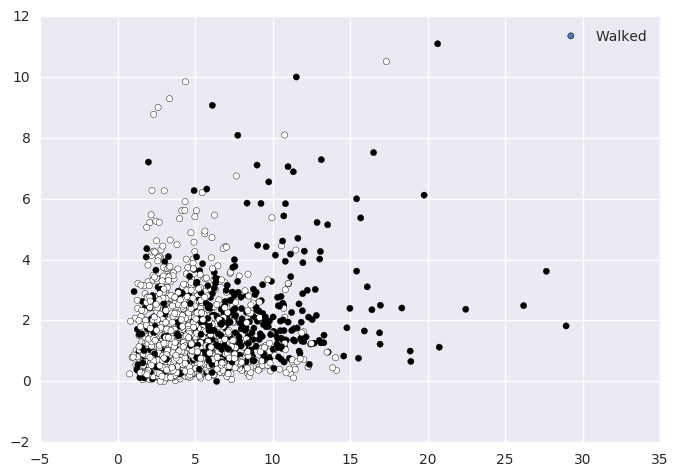

('Graduate', 'Work outside County')


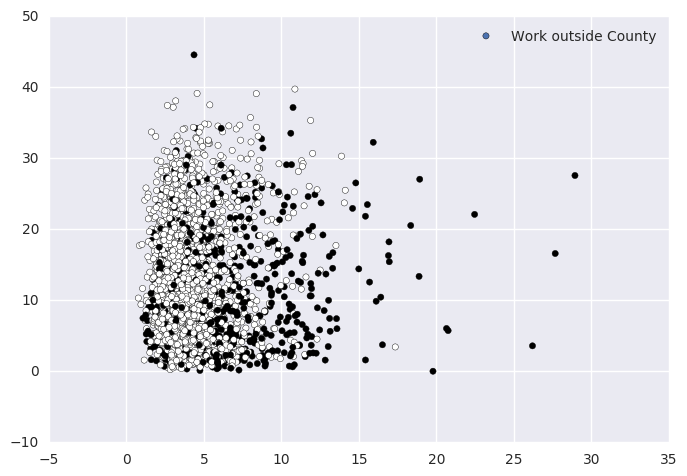

('Graduate', 'Work outside State')


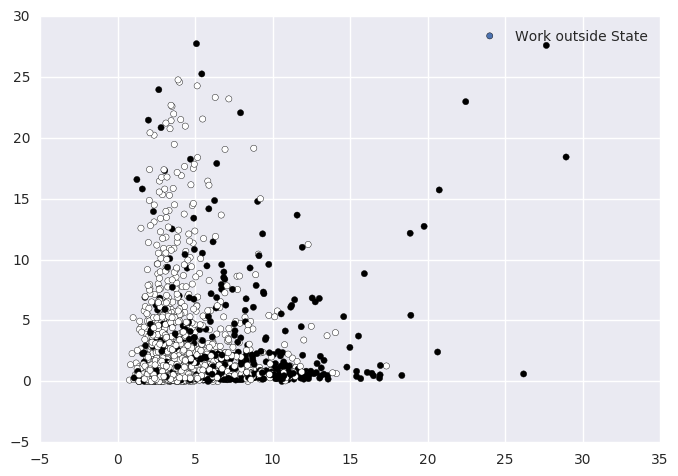

('Graduate', '2 vehicles')


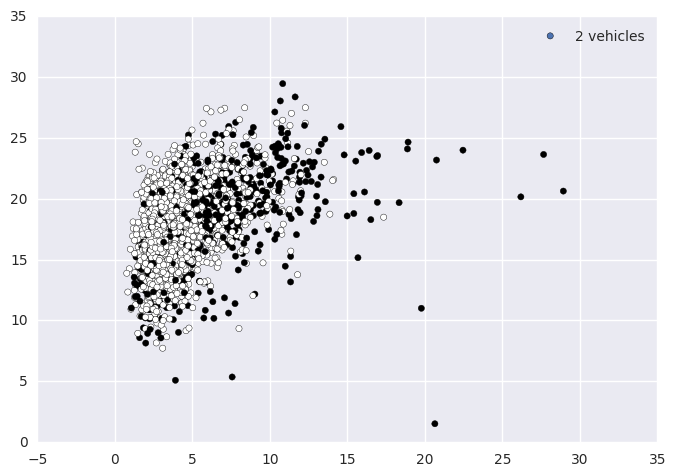

('Other State-HS or equal', 'Other State-Graduate')


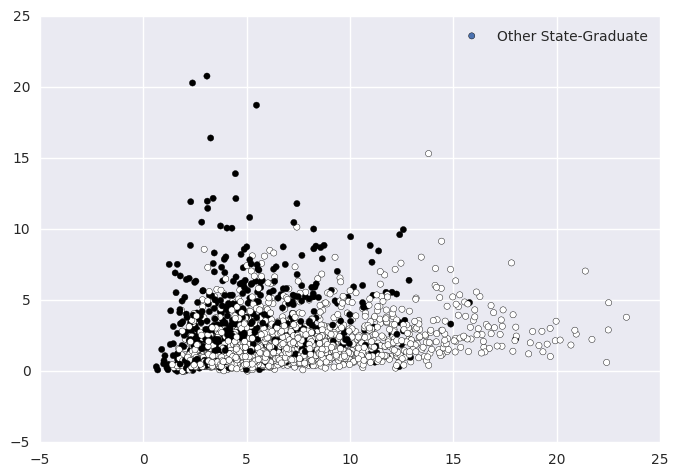

('Other State-HS or equal', 'Total Reporing 0 Income')


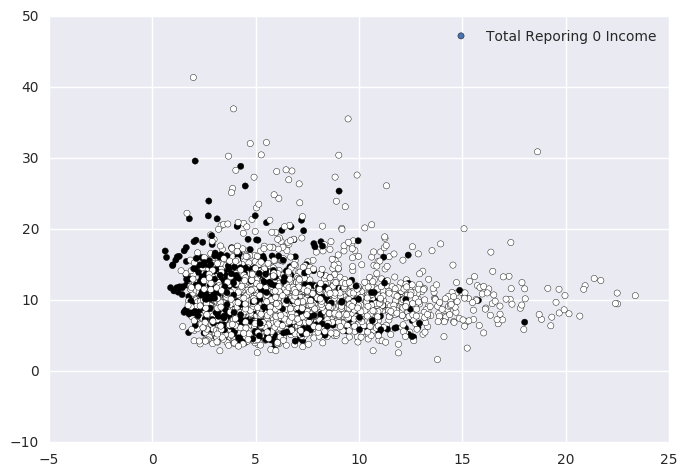

('Other State-HS or equal', 'Income 35-50K')


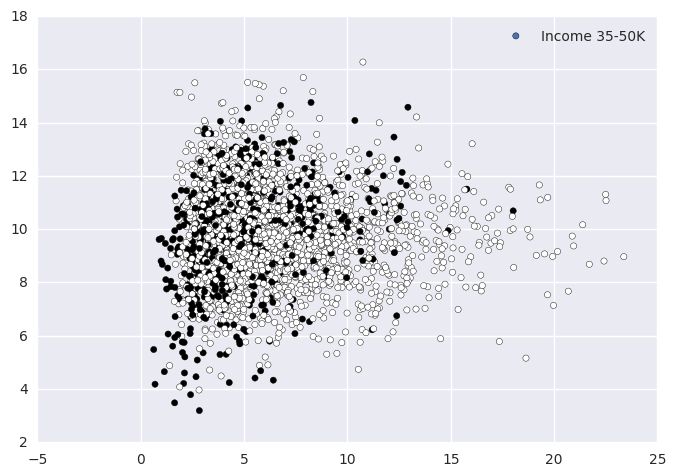

('Other State-HS or equal', 'Income 50-65K')


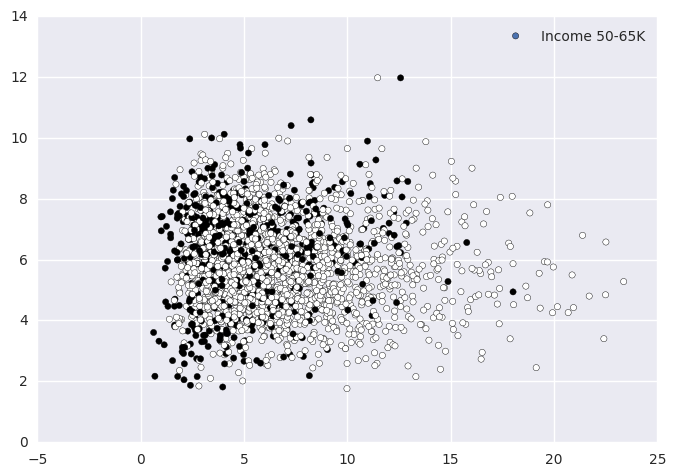

('Other State-HS or equal', 'Median Income')


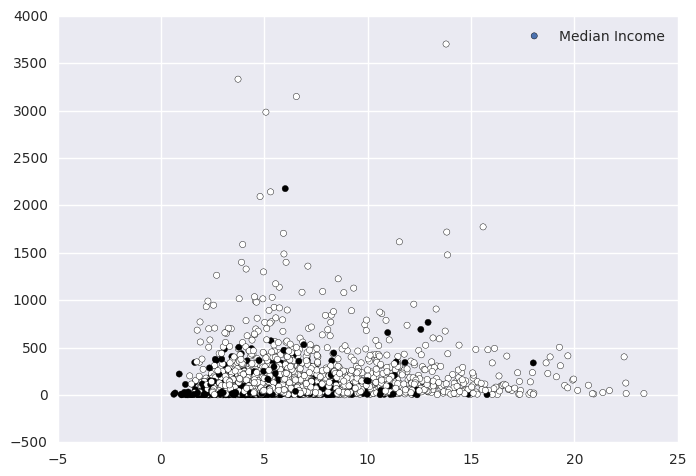

('Other State-HS or equal', 'Median Income Born In State')


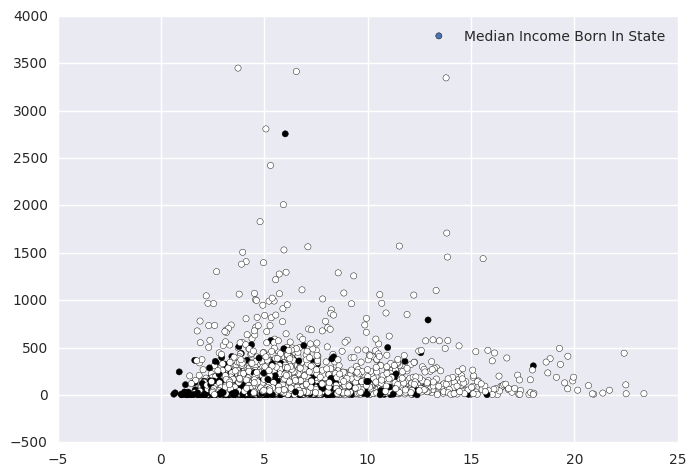

('Other State-HS or equal', 'Median Income Born Other State')


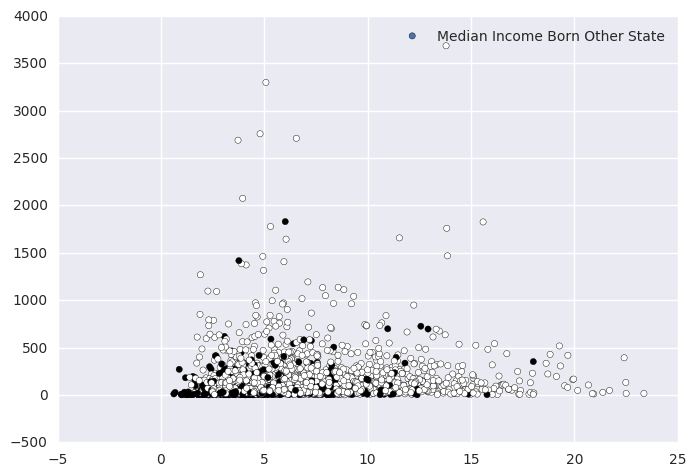

('Other State-HS or equal', 'Median Income Born Outside US: Native')


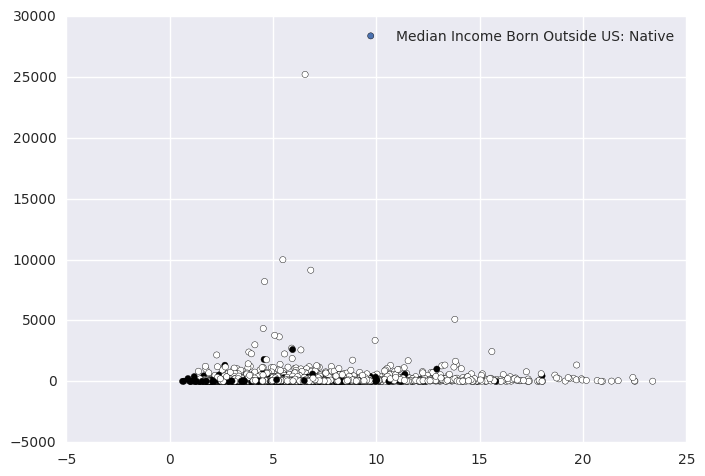

('Other State-HS or equal', 'Median Income Foreign Born')


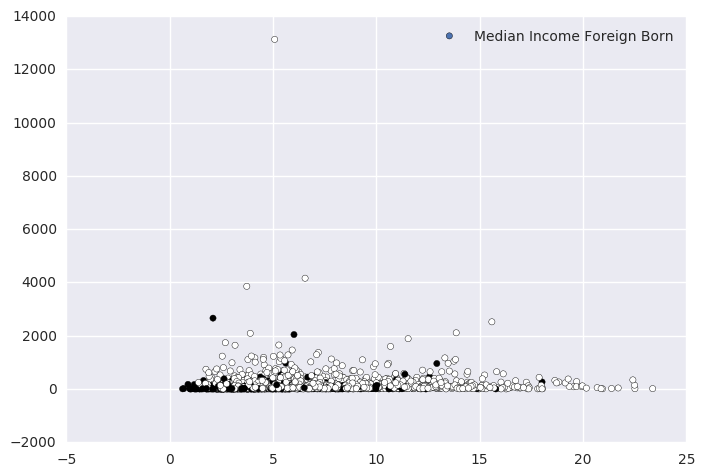

('Other State-HS or equal', '100% below povery line')


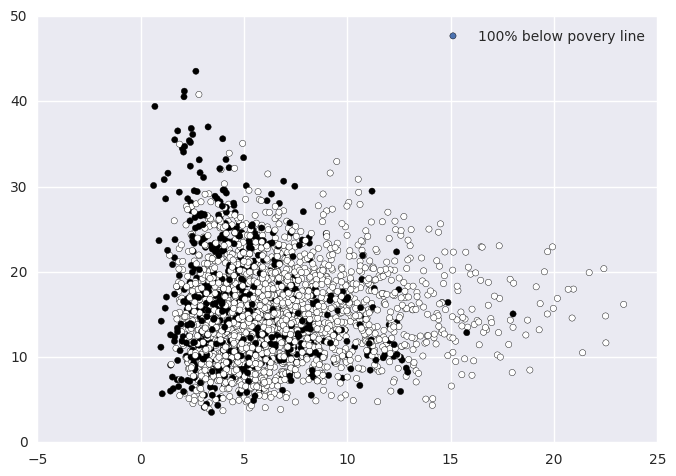

('Other State-HS or equal', 'Same house 1 year ago')


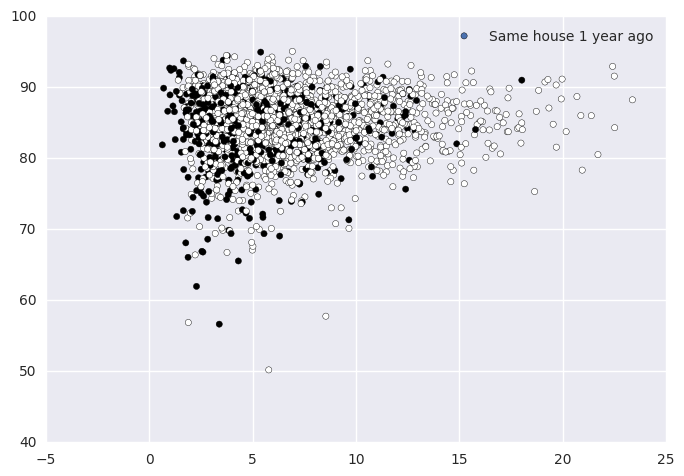

('Other State-HS or equal', 'Moved Within Same State')


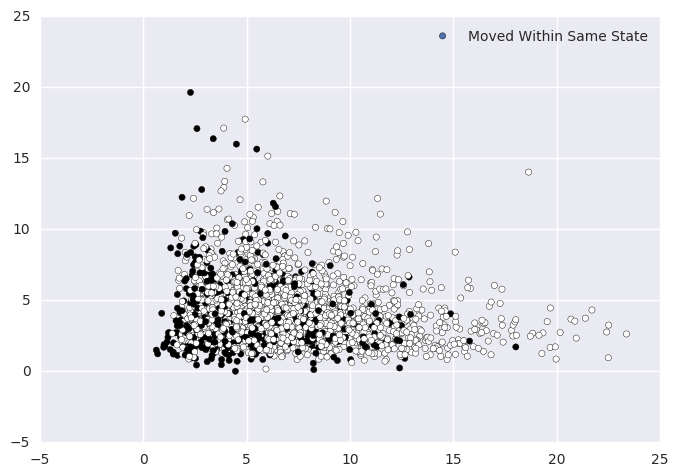

('Other State-HS or equal', 'Same house 1 year ago White')


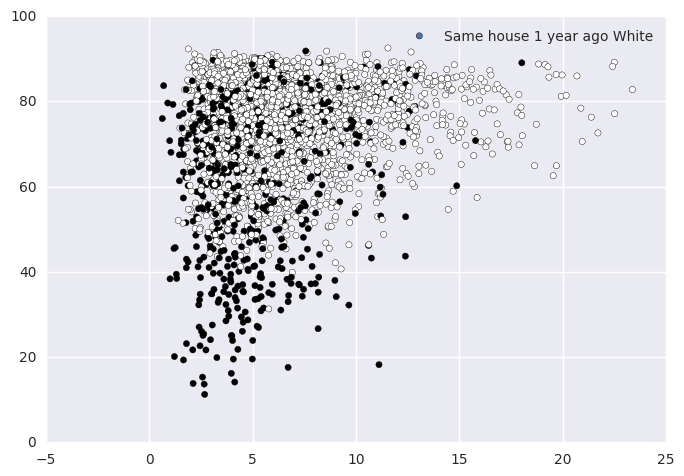

('Other State-HS or equal', 'Walked')


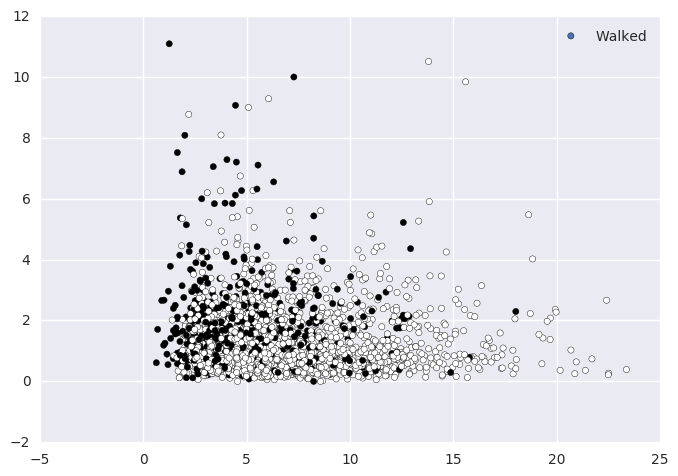

('Other State-HS or equal', 'Work outside County')


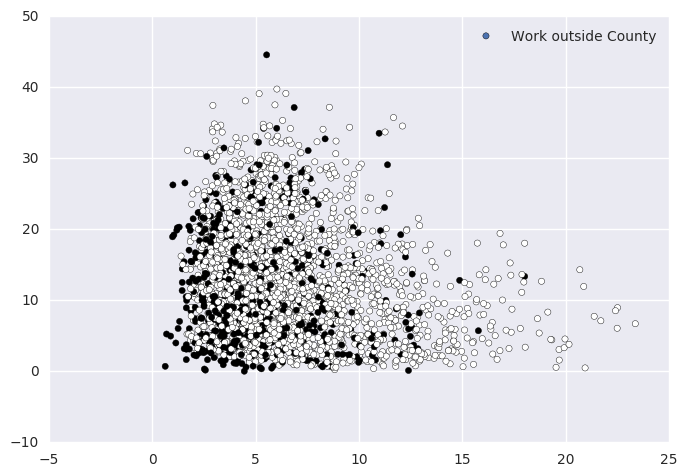

('Other State-HS or equal', 'Work outside State')


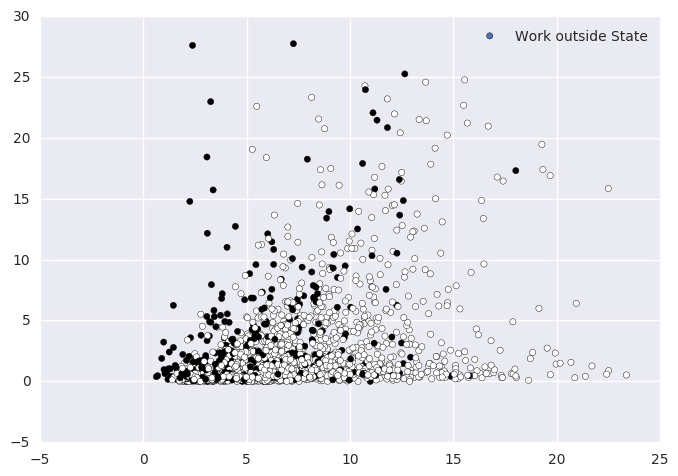

('Other State-HS or equal', '2 vehicles')


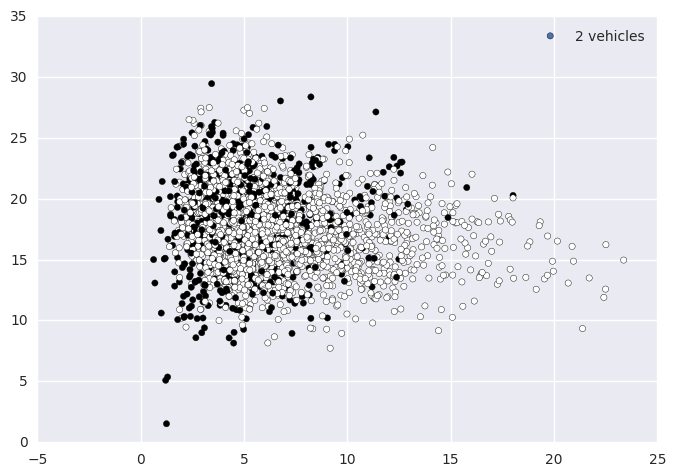

('Other State-Graduate', 'Total Reporing 0 Income')


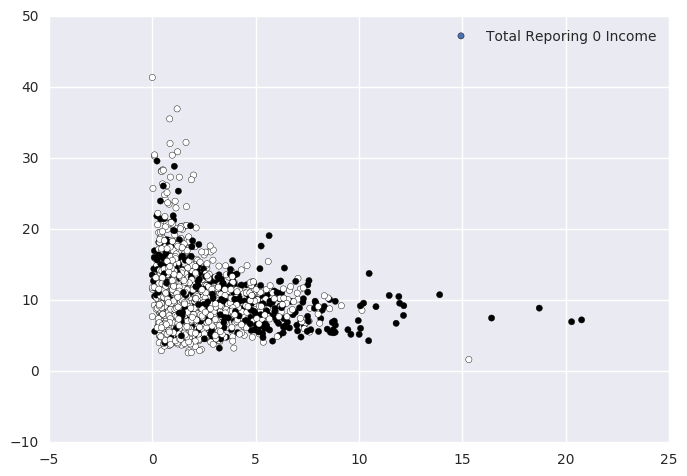

('Other State-Graduate', 'Income 35-50K')


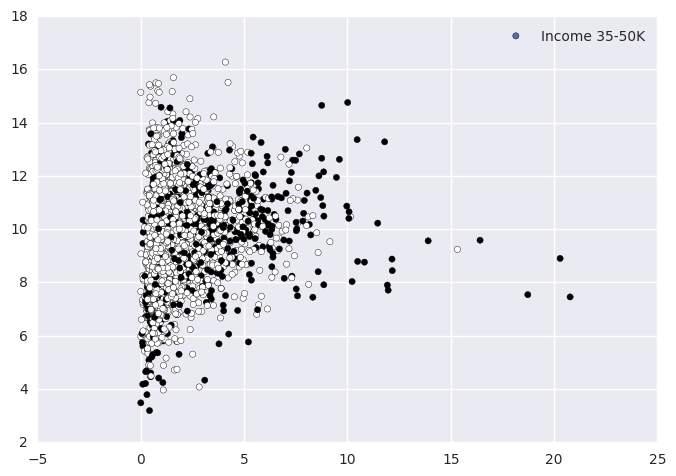

('Other State-Graduate', 'Income 50-65K')


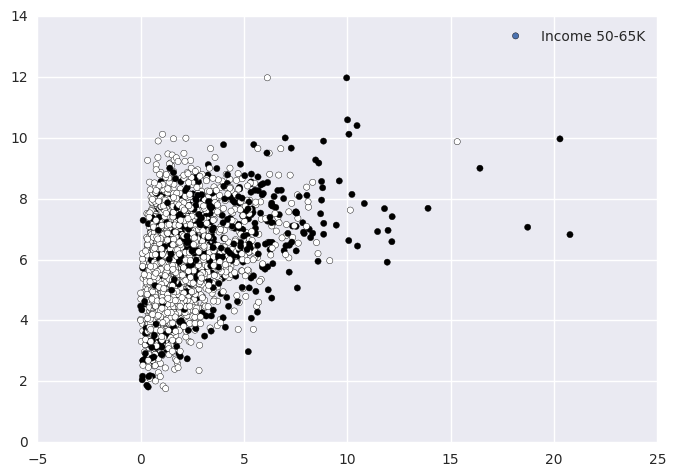

('Other State-Graduate', 'Median Income')


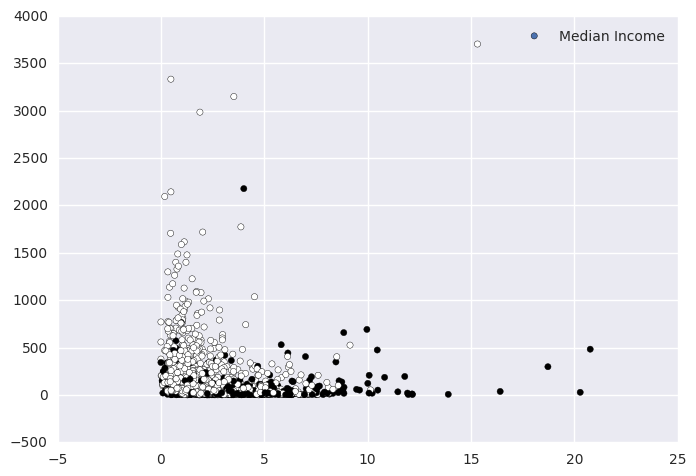

('Other State-Graduate', 'Median Income Born In State')


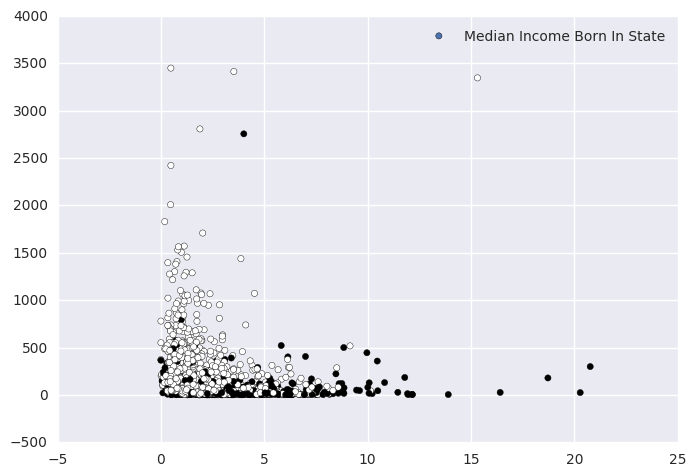

('Other State-Graduate', 'Median Income Born Other State')


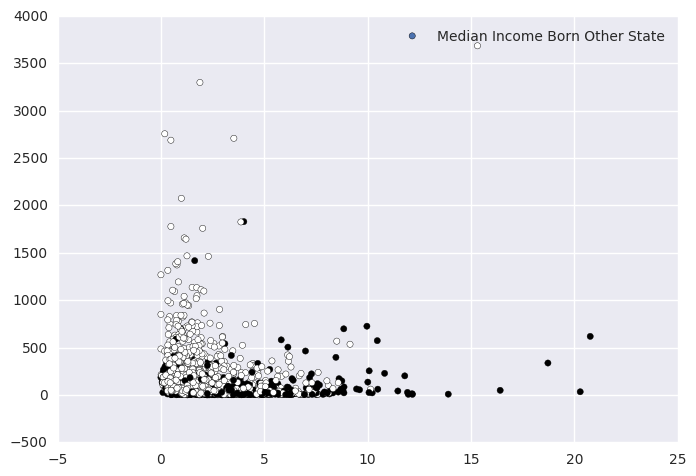

('Other State-Graduate', 'Median Income Born Outside US: Native')


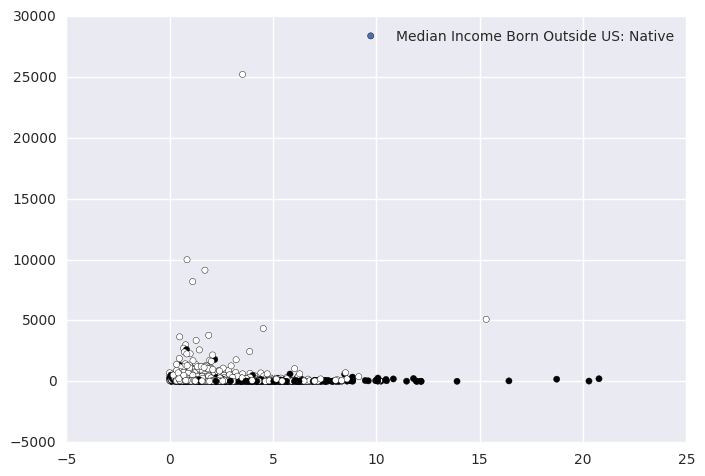

('Other State-Graduate', 'Median Income Foreign Born')


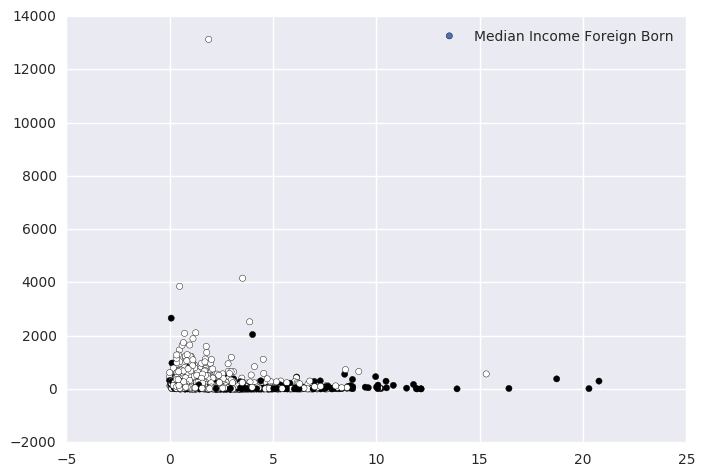

('Other State-Graduate', '100% below povery line')


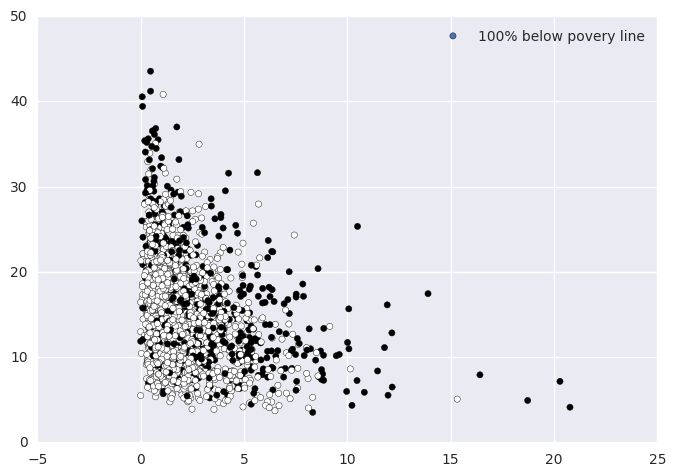

('Other State-Graduate', 'Same house 1 year ago')


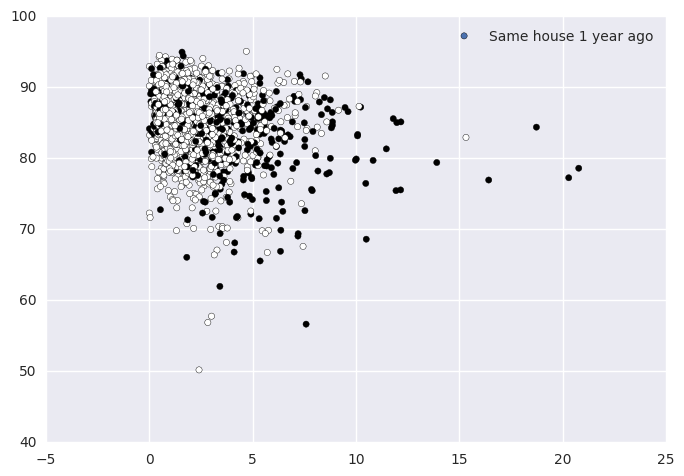

('Other State-Graduate', 'Moved Within Same State')


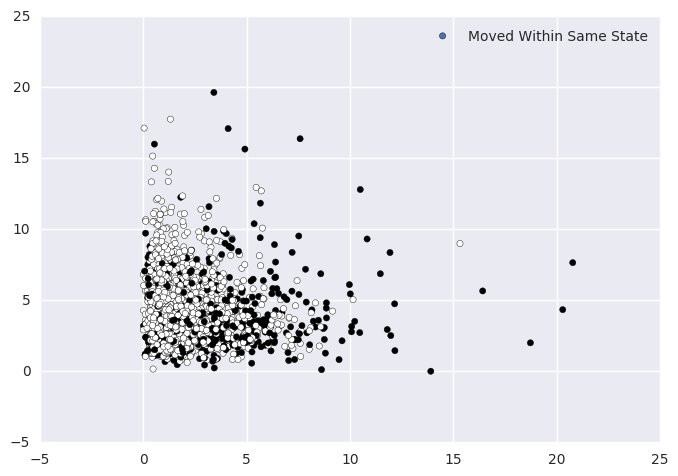

('Other State-Graduate', 'Same house 1 year ago White')


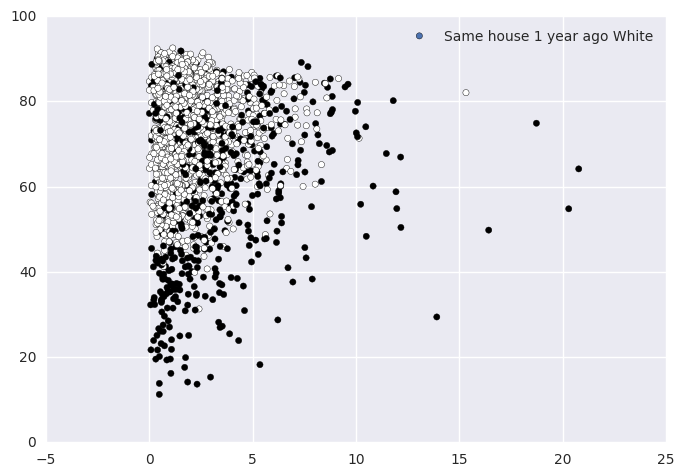

('Other State-Graduate', 'Walked')


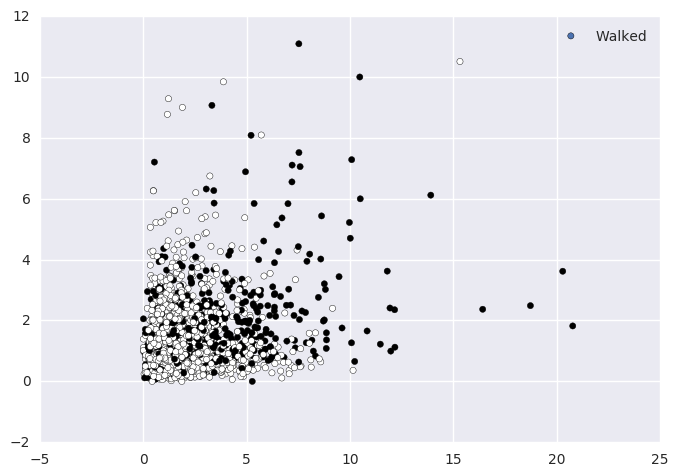

('Other State-Graduate', 'Work outside County')


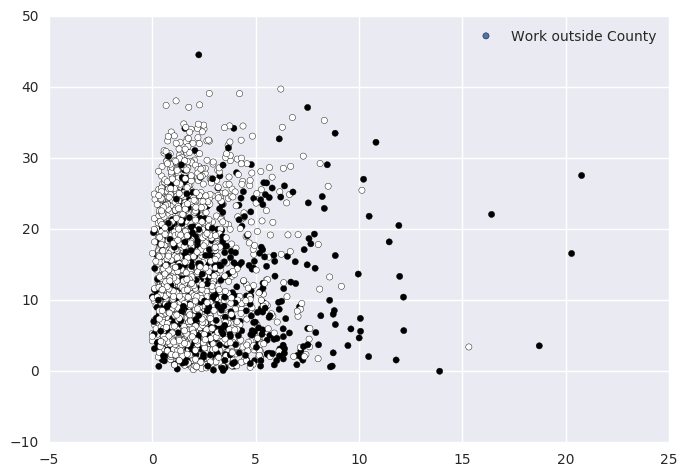

('Other State-Graduate', 'Work outside State')


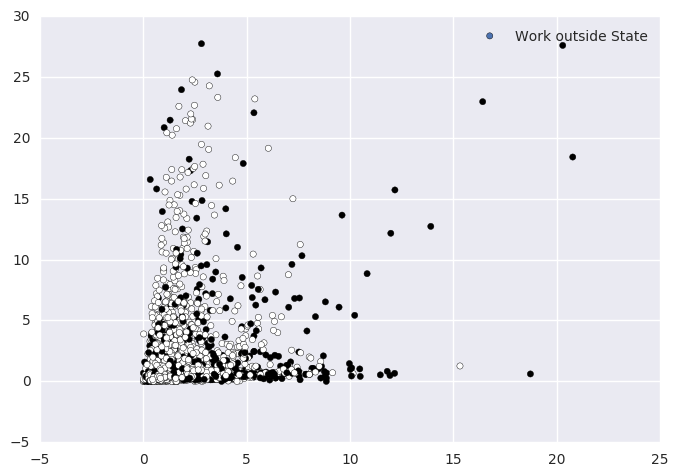

('Other State-Graduate', '2 vehicles')


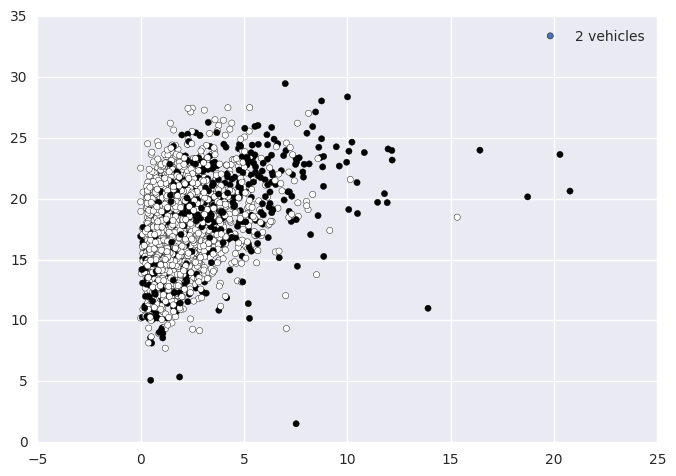

('Total Reporing 0 Income', 'Income 35-50K')


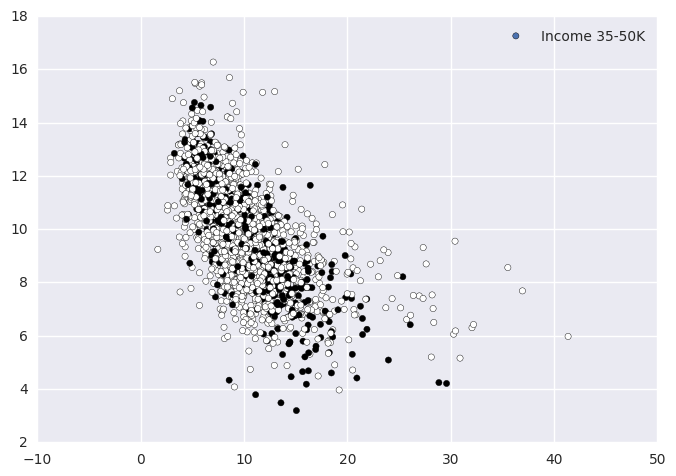

('Total Reporing 0 Income', 'Income 50-65K')


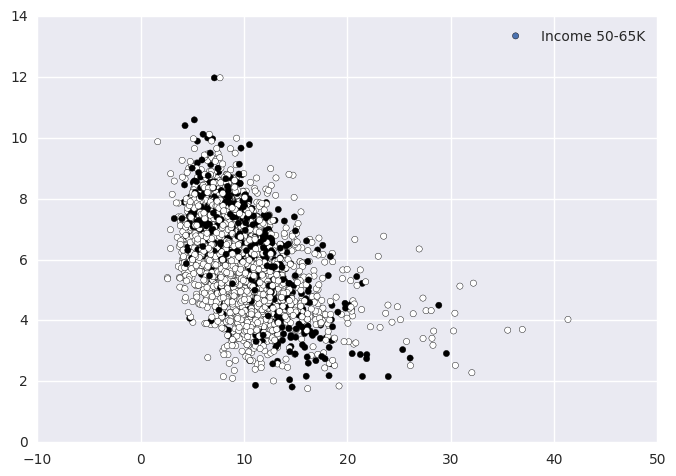

('Total Reporing 0 Income', 'Median Income')


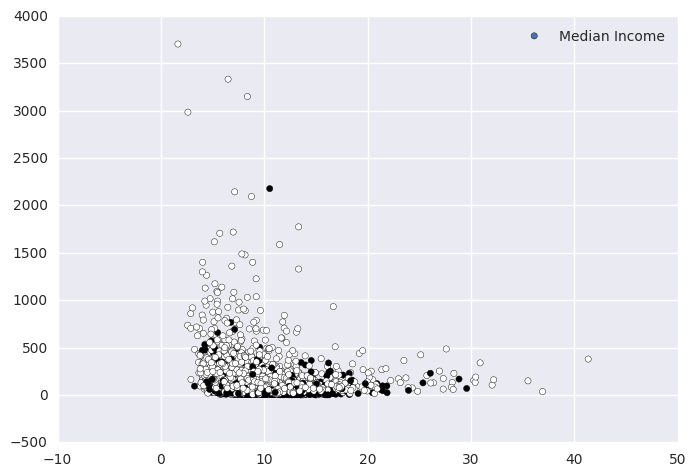

('Total Reporing 0 Income', 'Median Income Born In State')


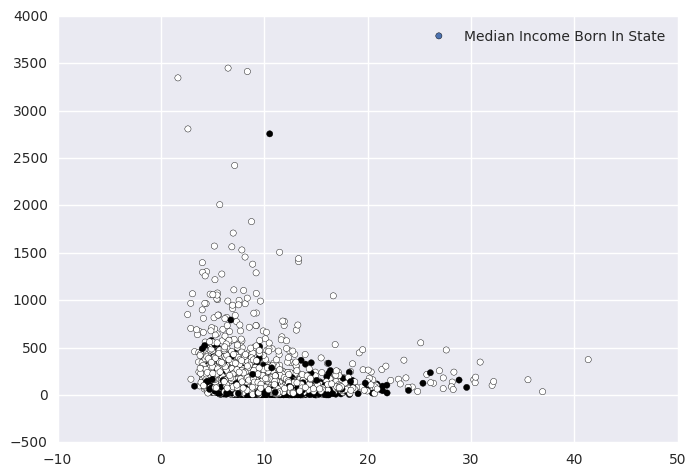

('Total Reporing 0 Income', 'Median Income Born Other State')


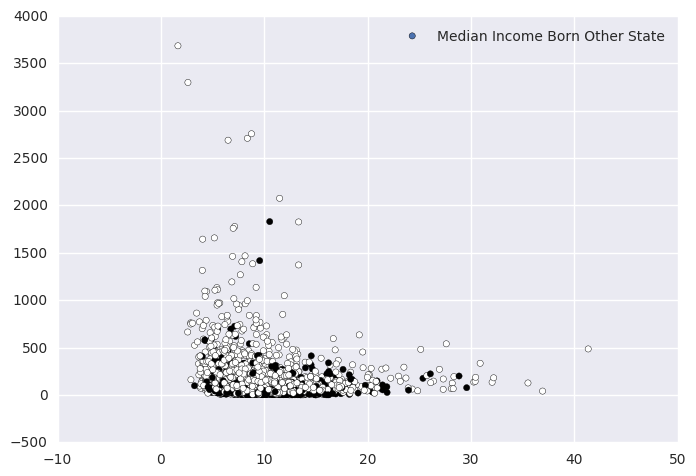

('Total Reporing 0 Income', 'Median Income Born Outside US: Native')


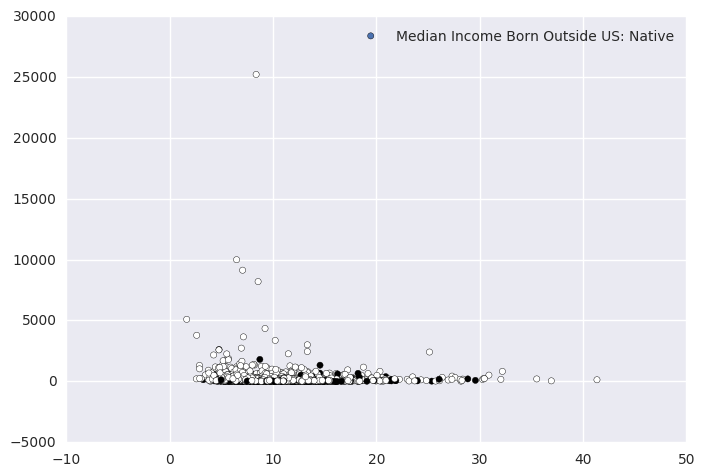

('Total Reporing 0 Income', 'Median Income Foreign Born')


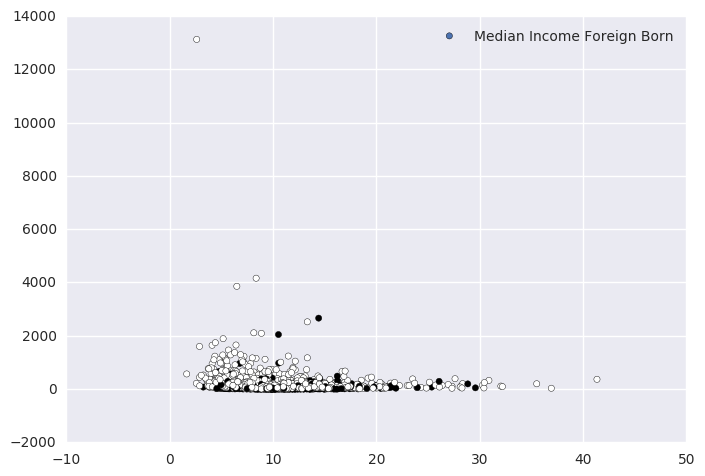

('Total Reporing 0 Income', '100% below povery line')


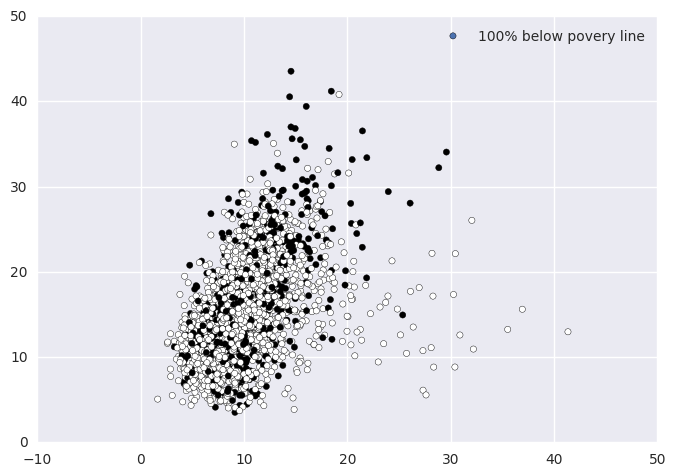

('Total Reporing 0 Income', 'Same house 1 year ago')


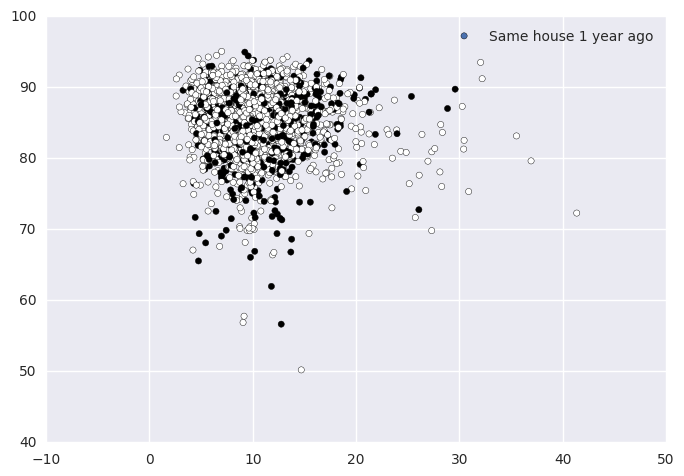

('Total Reporing 0 Income', 'Moved Within Same State')


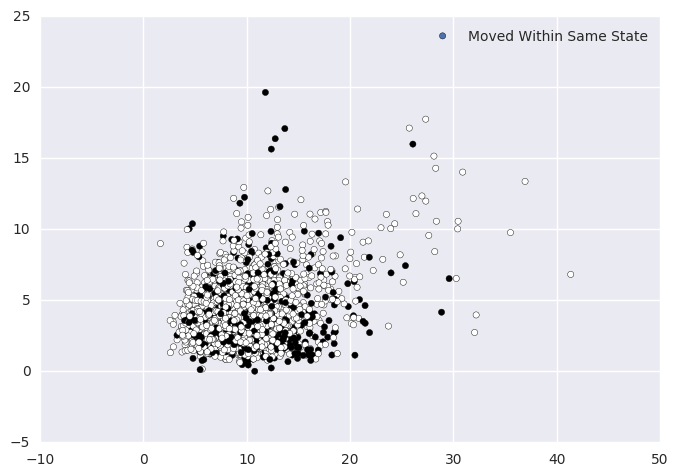

('Total Reporing 0 Income', 'Same house 1 year ago White')


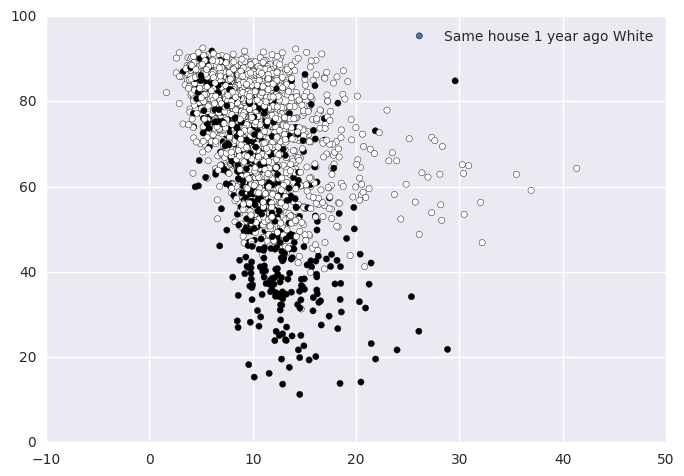

('Total Reporing 0 Income', 'Walked')


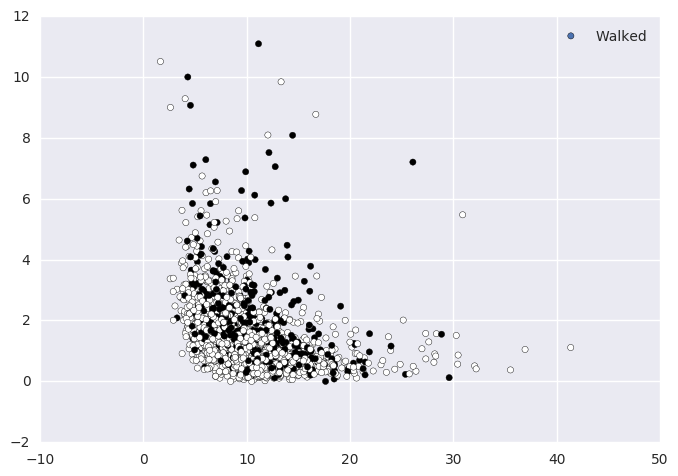

('Total Reporing 0 Income', 'Work outside County')


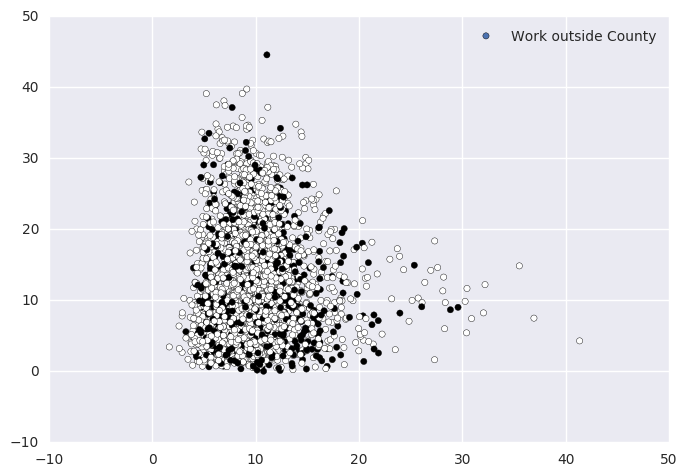

('Total Reporing 0 Income', 'Work outside State')


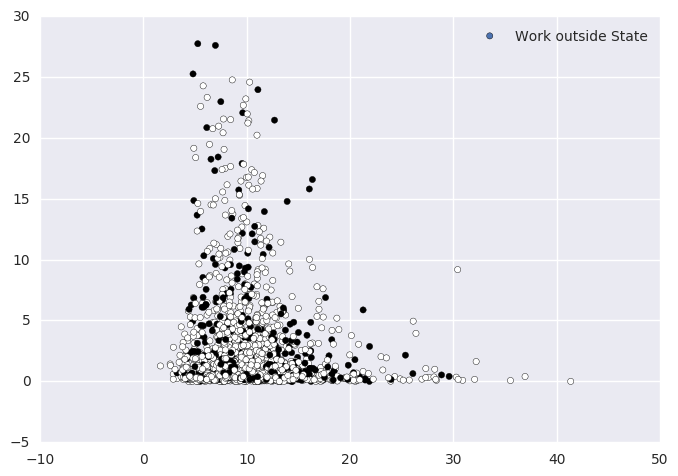

('Total Reporing 0 Income', '2 vehicles')


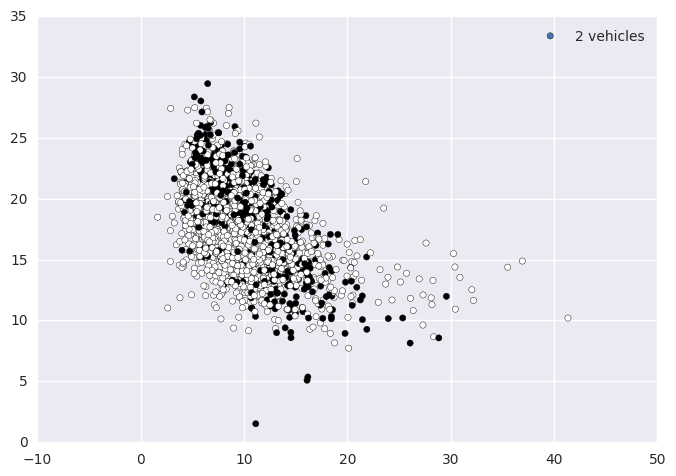

('Income 35-50K', 'Income 50-65K')


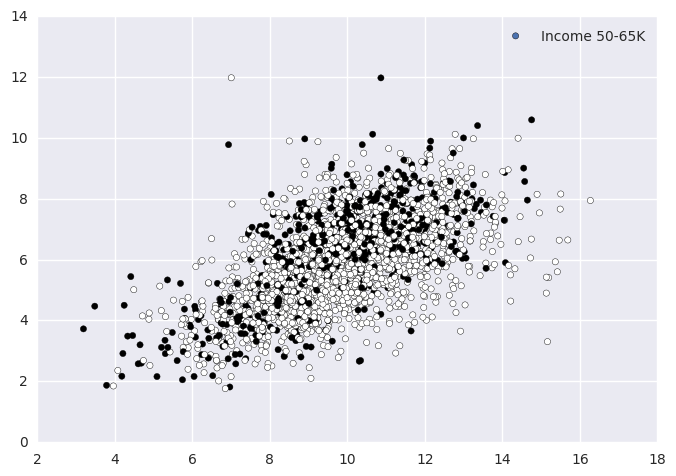

('Income 35-50K', 'Median Income')


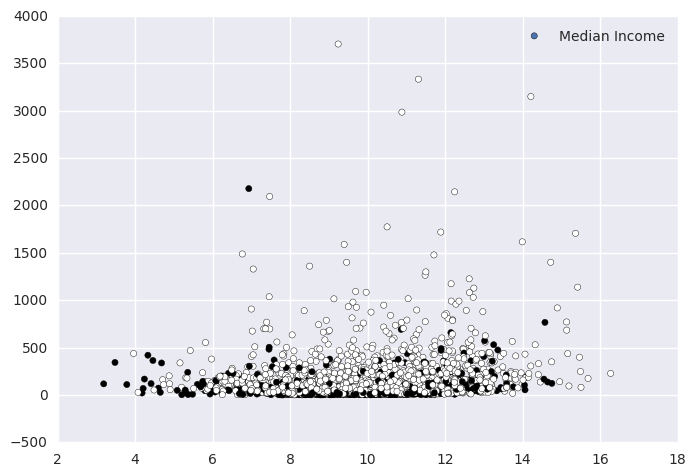

('Income 35-50K', 'Median Income Born In State')


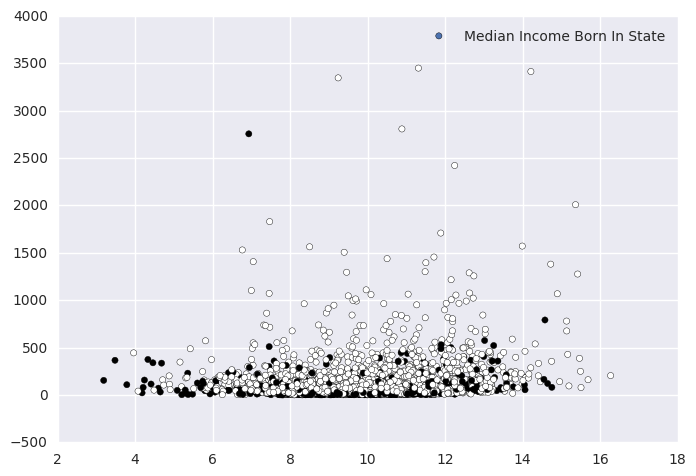

('Income 35-50K', 'Median Income Born Other State')


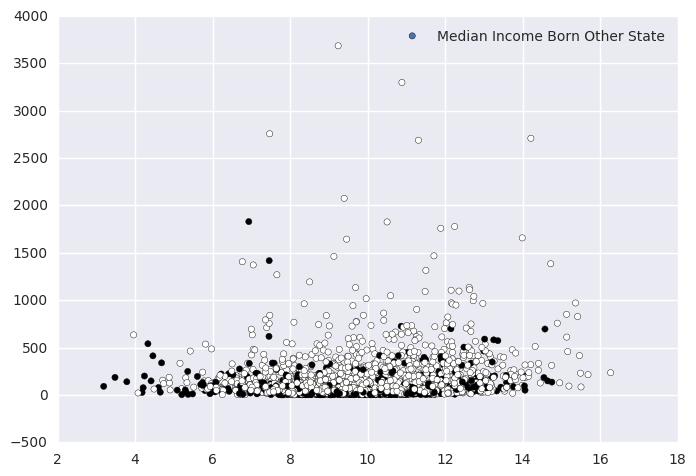

('Income 35-50K', 'Median Income Born Outside US: Native')


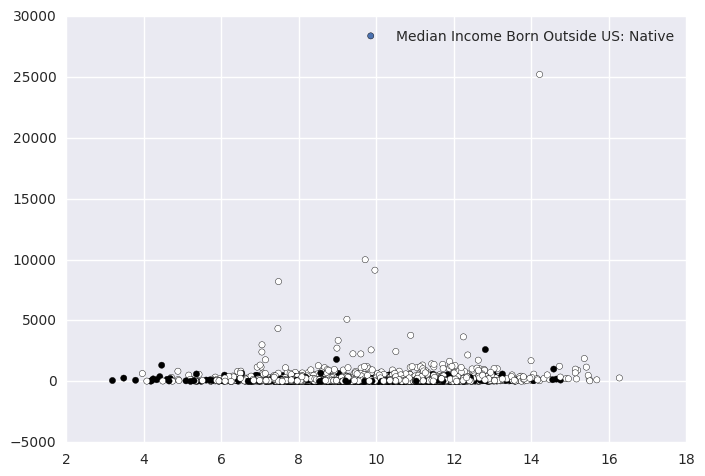

('Income 35-50K', 'Median Income Foreign Born')


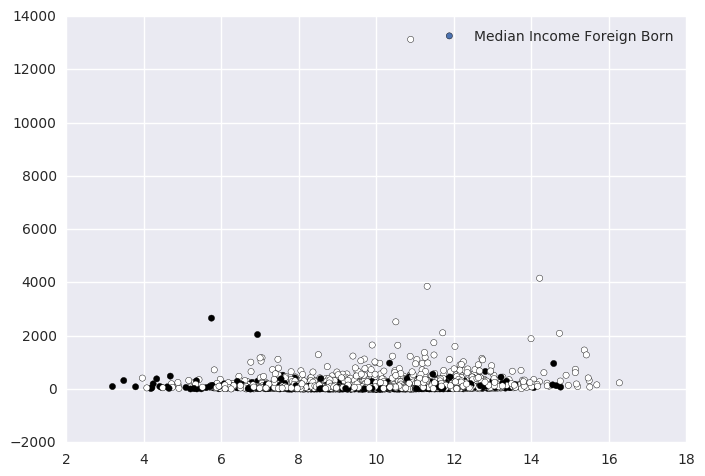

('Income 35-50K', '100% below povery line')


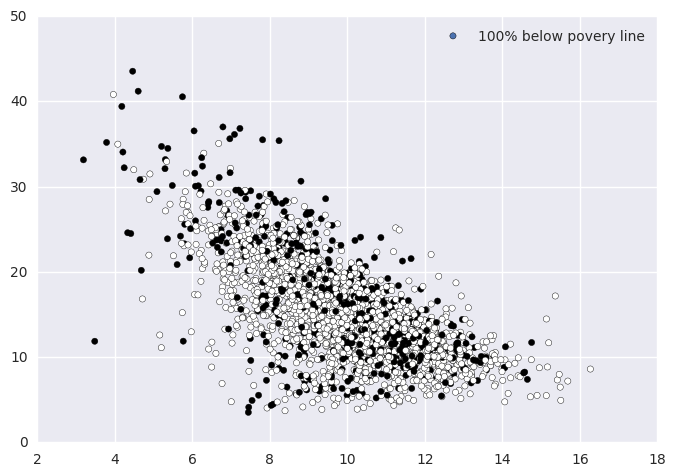

('Income 35-50K', 'Same house 1 year ago')


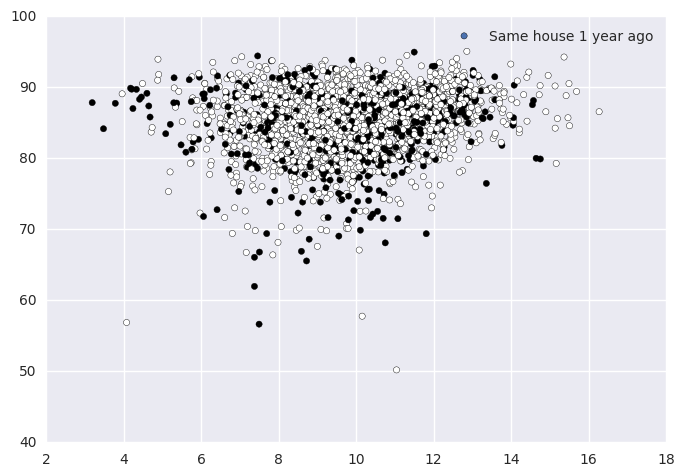

('Income 35-50K', 'Moved Within Same State')


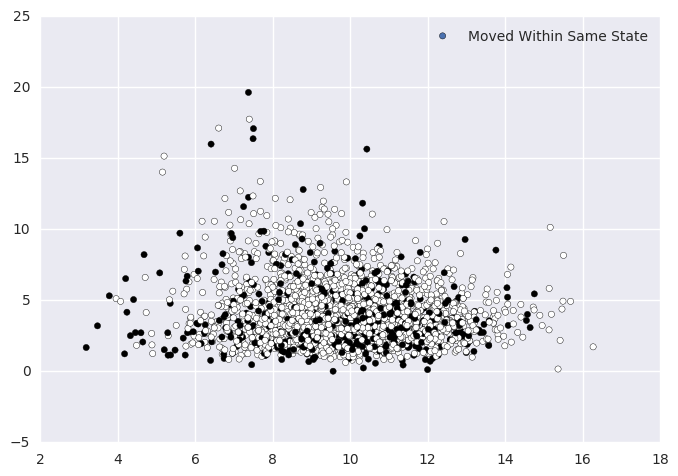

('Income 35-50K', 'Same house 1 year ago White')


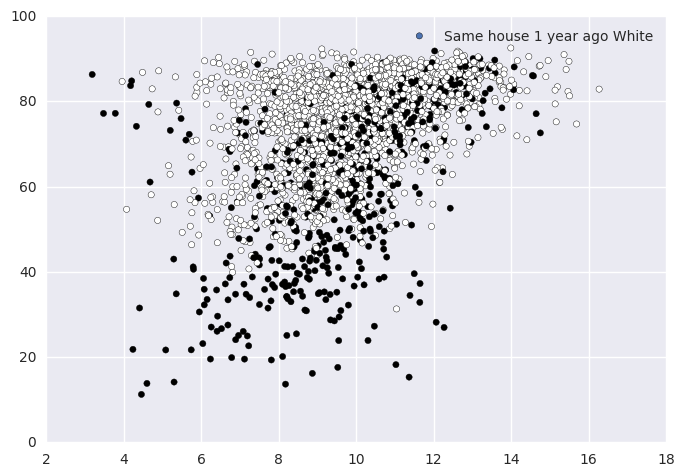

('Income 35-50K', 'Walked')


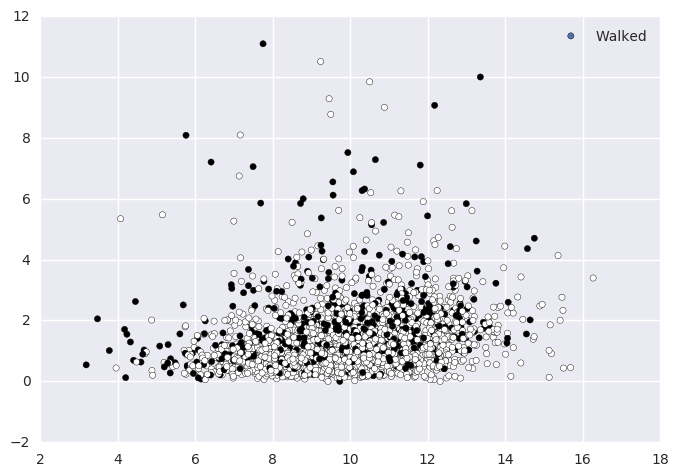

('Income 35-50K', 'Work outside County')


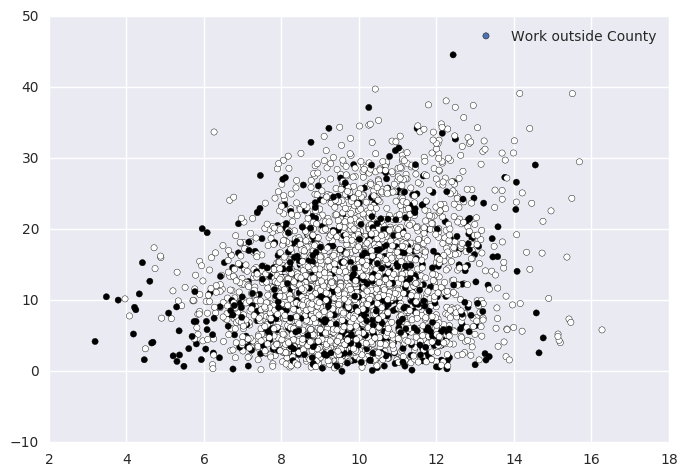

('Income 35-50K', 'Work outside State')


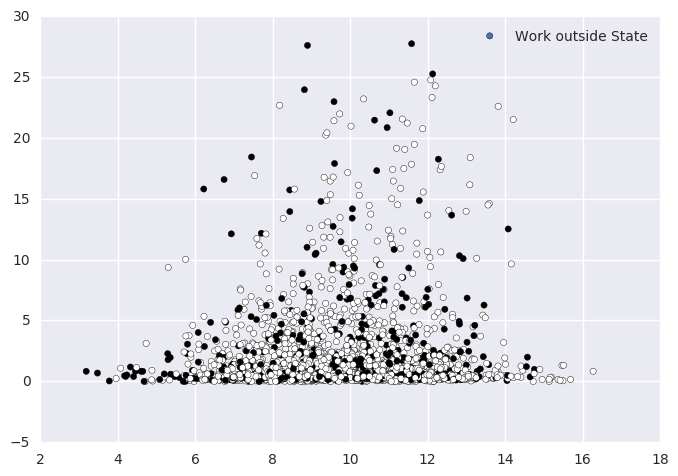

('Income 35-50K', '2 vehicles')


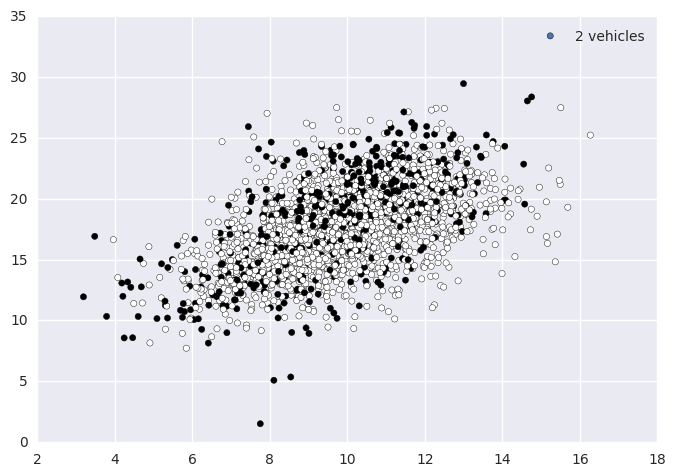

('Income 50-65K', 'Median Income')


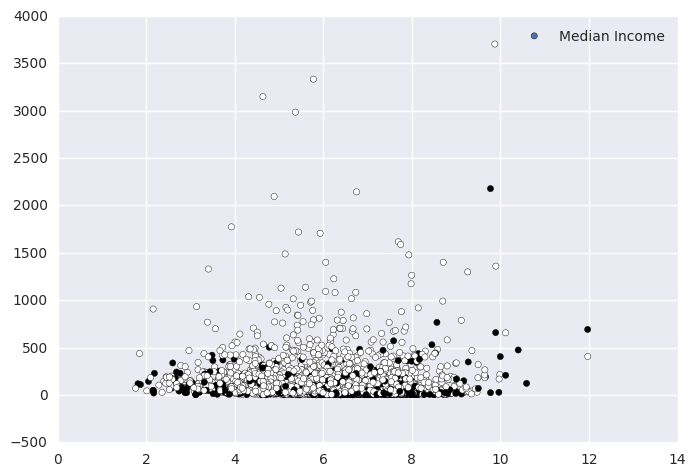

('Income 50-65K', 'Median Income Born In State')


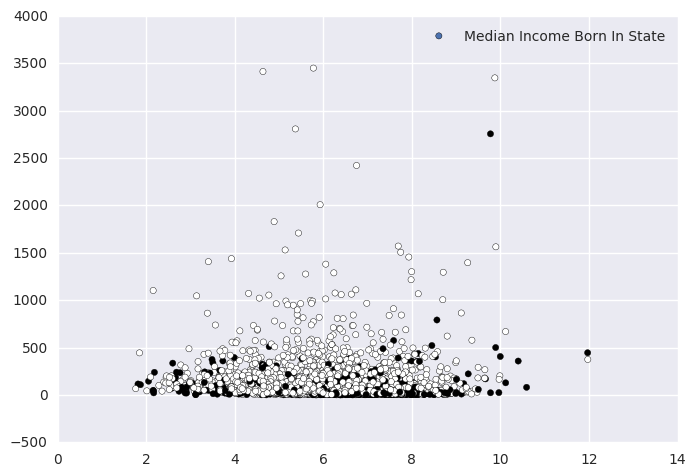

('Income 50-65K', 'Median Income Born Other State')


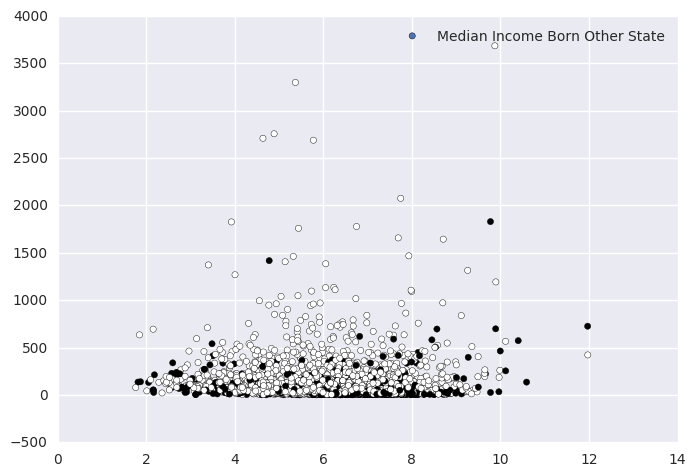

('Income 50-65K', 'Median Income Born Outside US: Native')


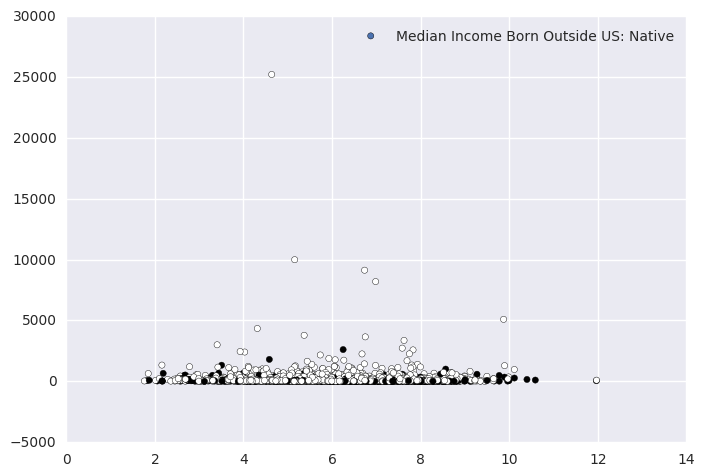

('Income 50-65K', 'Median Income Foreign Born')


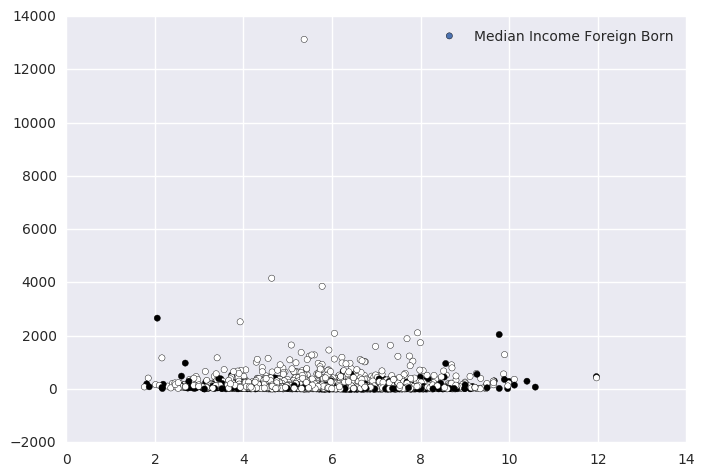

('Income 50-65K', '100% below povery line')


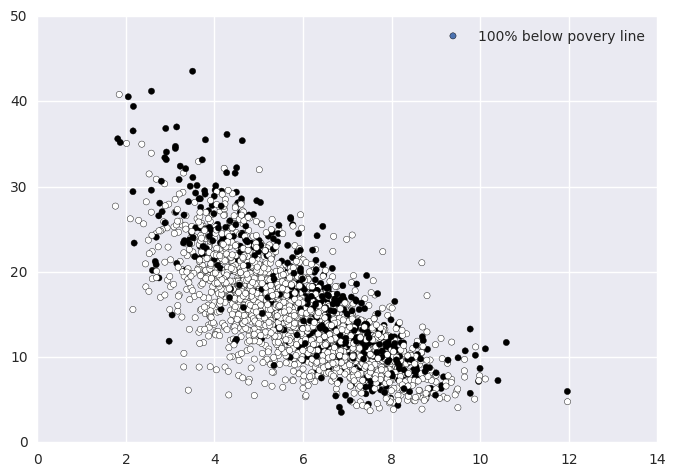

('Income 50-65K', 'Same house 1 year ago')


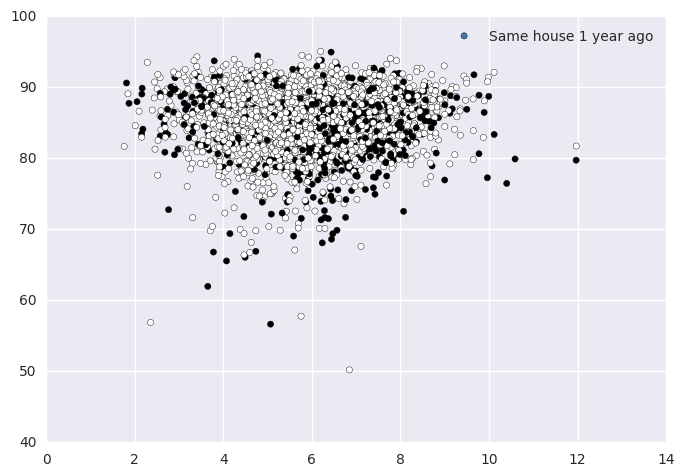

('Income 50-65K', 'Moved Within Same State')


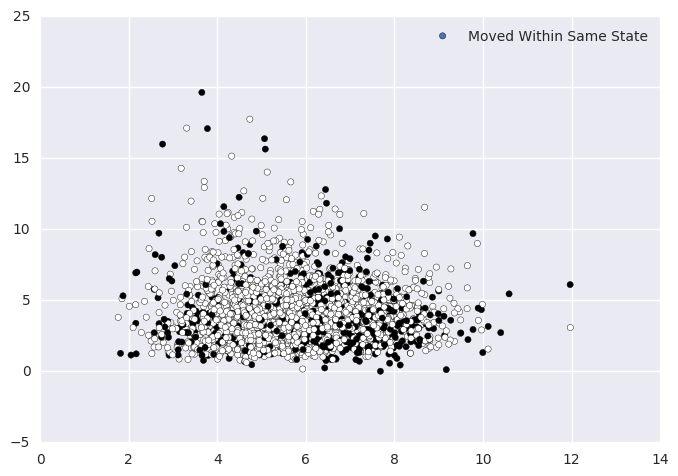

('Income 50-65K', 'Same house 1 year ago White')


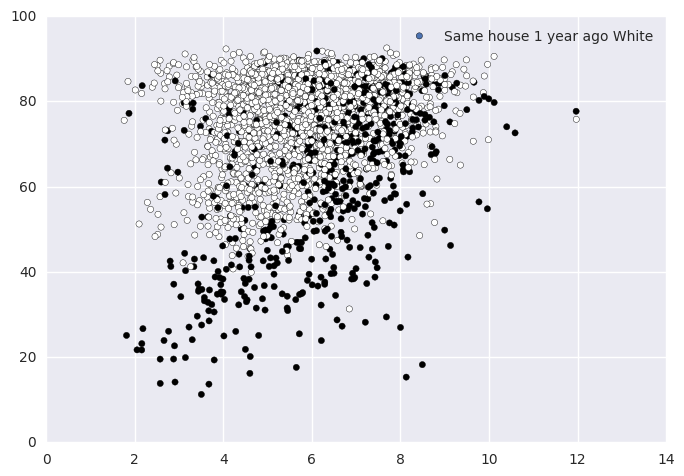

('Income 50-65K', 'Walked')


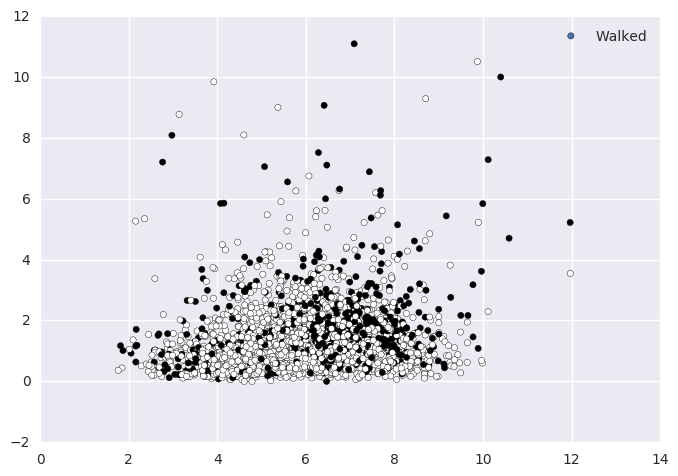

('Income 50-65K', 'Work outside County')


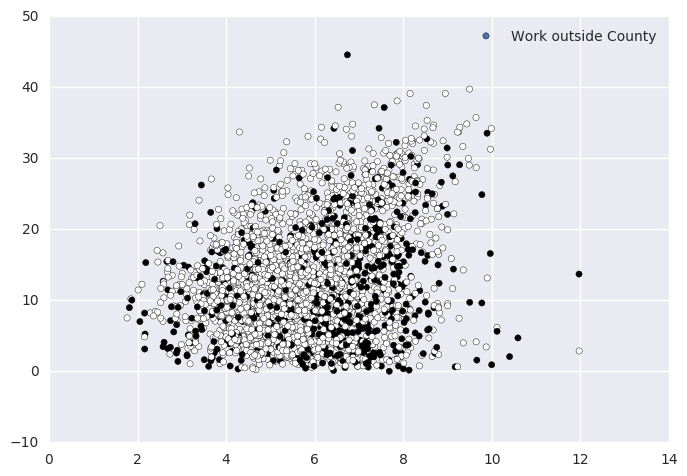

('Income 50-65K', 'Work outside State')


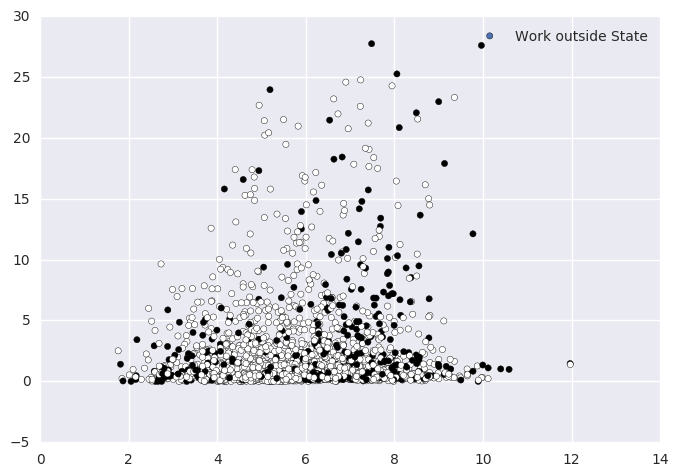

('Income 50-65K', '2 vehicles')


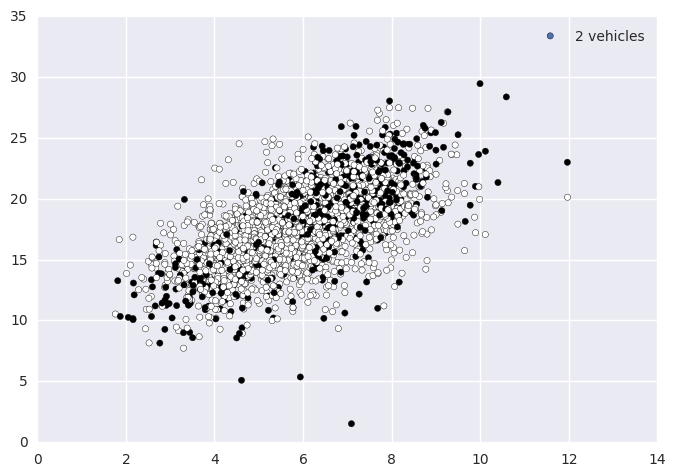

('Median Income', 'Median Income Born In State')


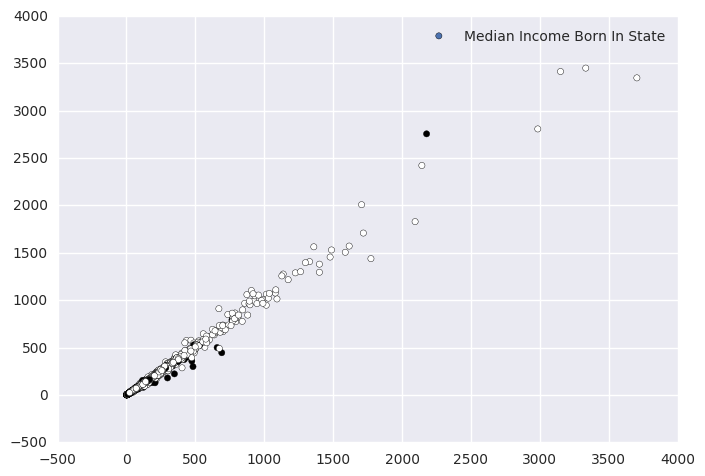

('Median Income', 'Median Income Born Other State')


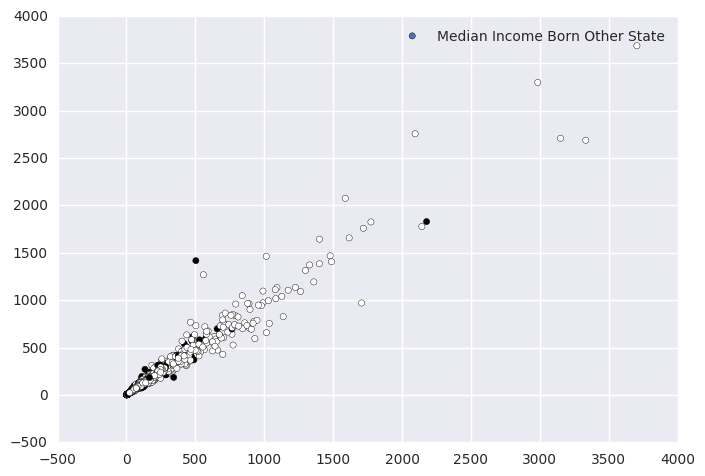

('Median Income', 'Median Income Born Outside US: Native')


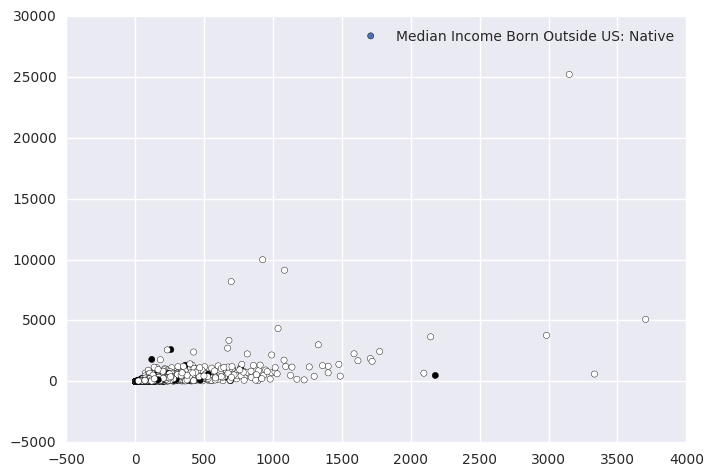

('Median Income', 'Median Income Foreign Born')


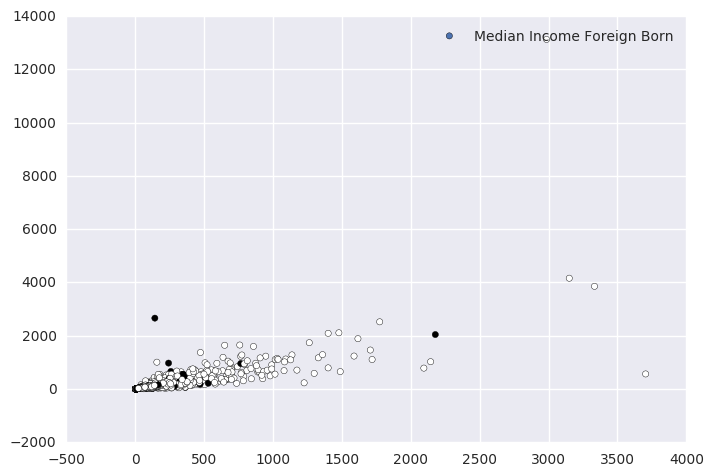

('Median Income', '100% below povery line')


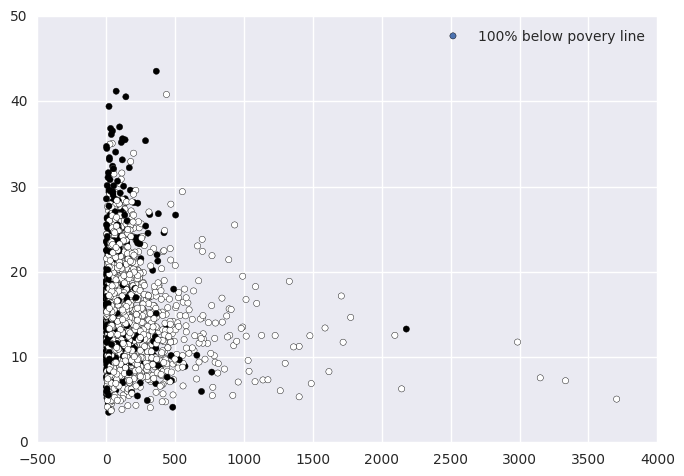

('Median Income', 'Same house 1 year ago')


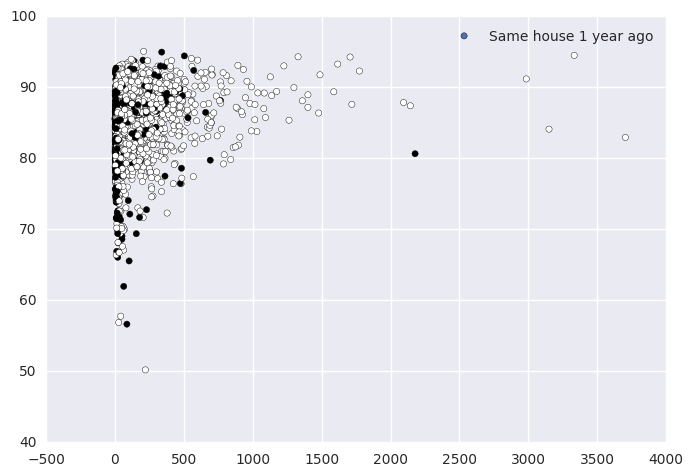

('Median Income', 'Moved Within Same State')


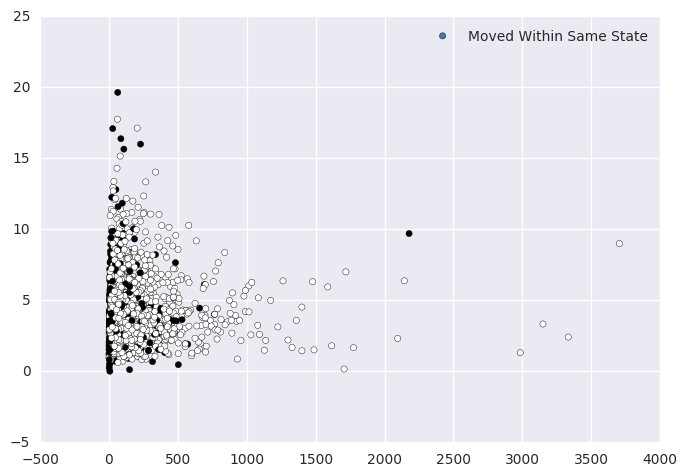

('Median Income', 'Same house 1 year ago White')


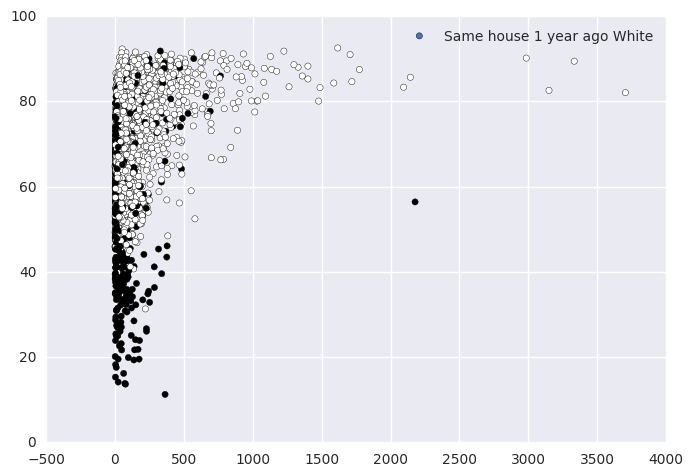

('Median Income', 'Walked')


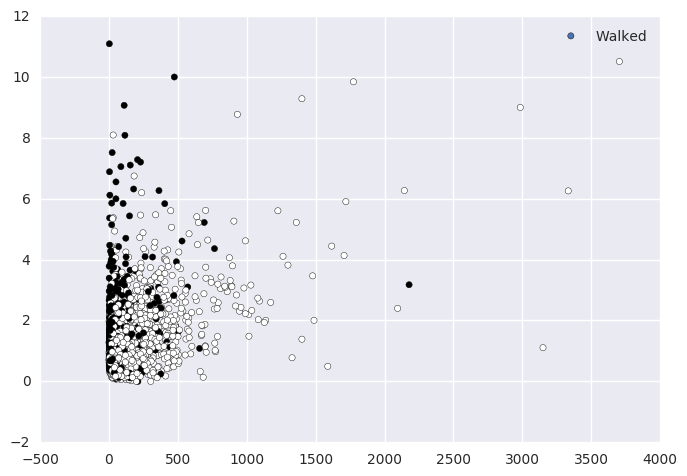

('Median Income', 'Work outside County')


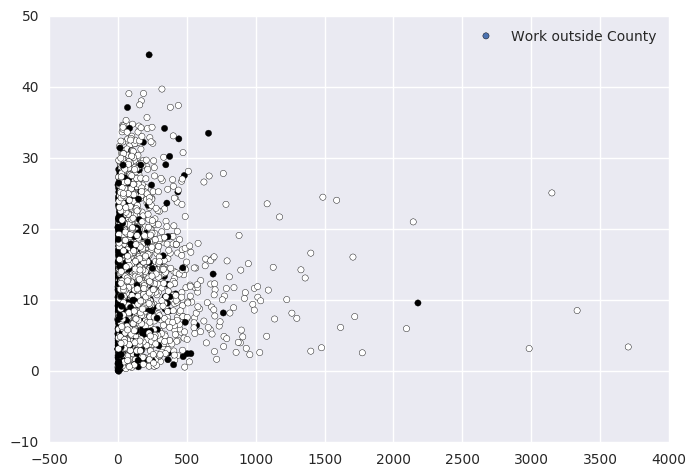

('Median Income', 'Work outside State')


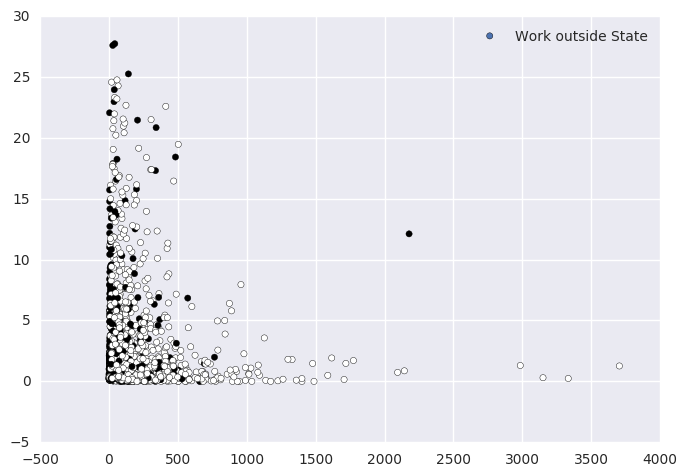

('Median Income', '2 vehicles')


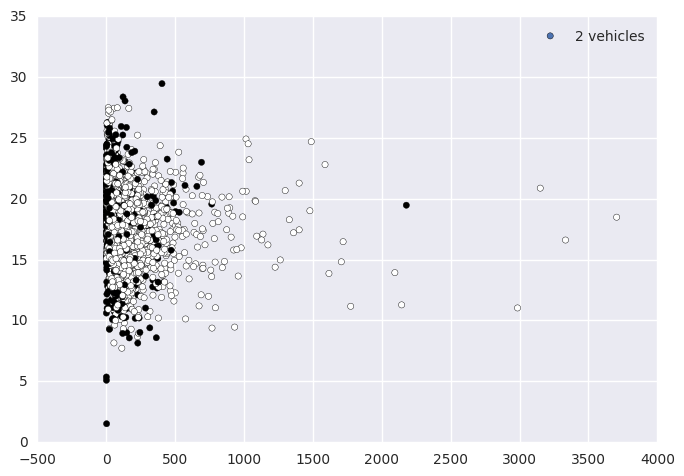

('Median Income Born In State', 'Median Income Born Other State')


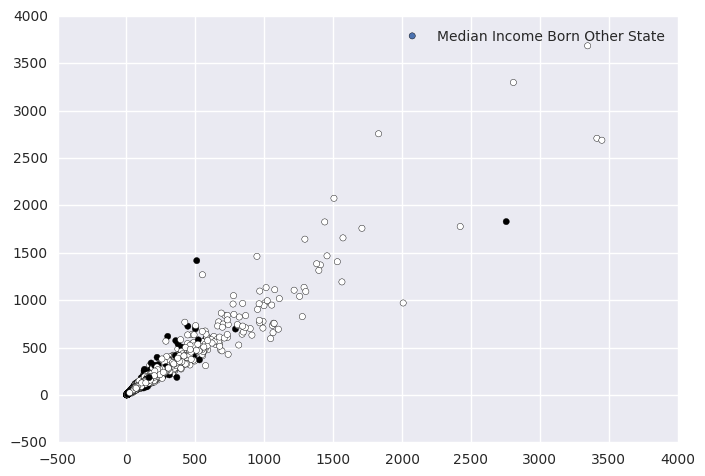

('Median Income Born In State', 'Median Income Born Outside US: Native')


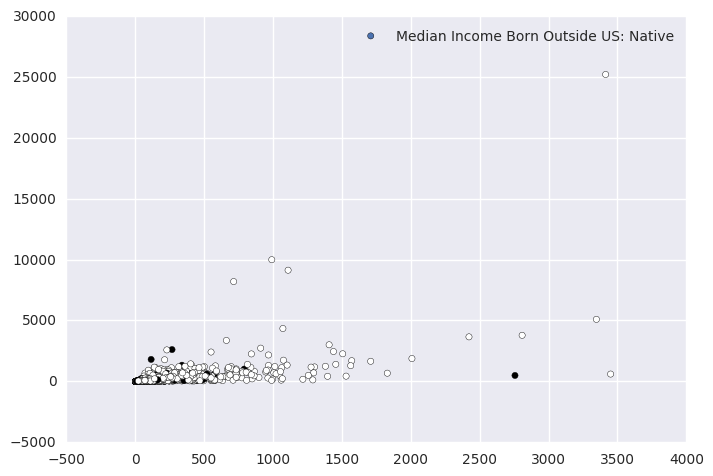

('Median Income Born In State', 'Median Income Foreign Born')


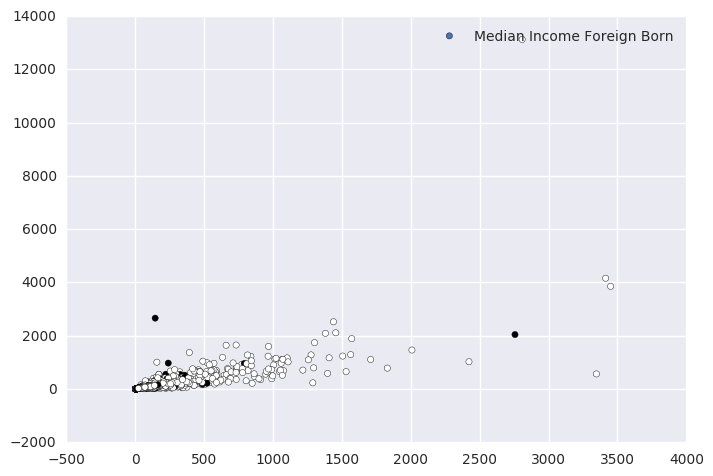

('Median Income Born In State', '100% below povery line')


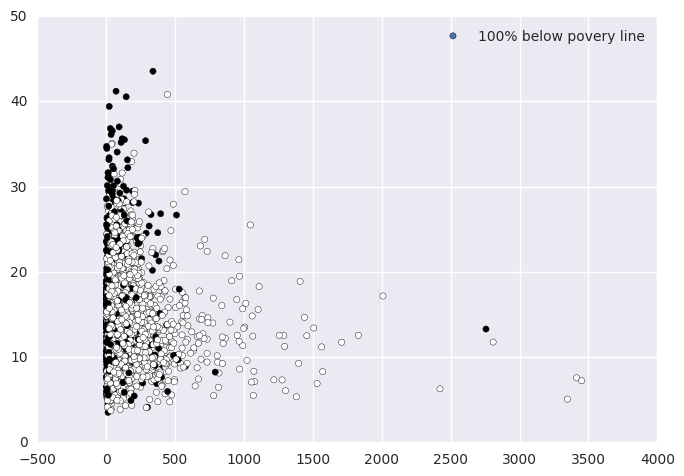

('Median Income Born In State', 'Same house 1 year ago')


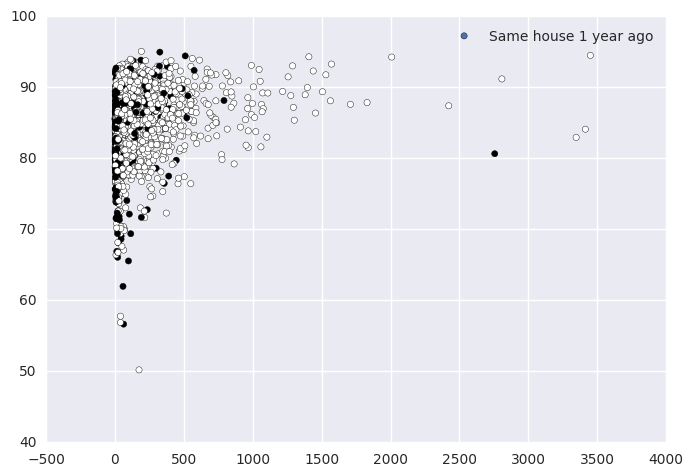

('Median Income Born In State', 'Moved Within Same State')


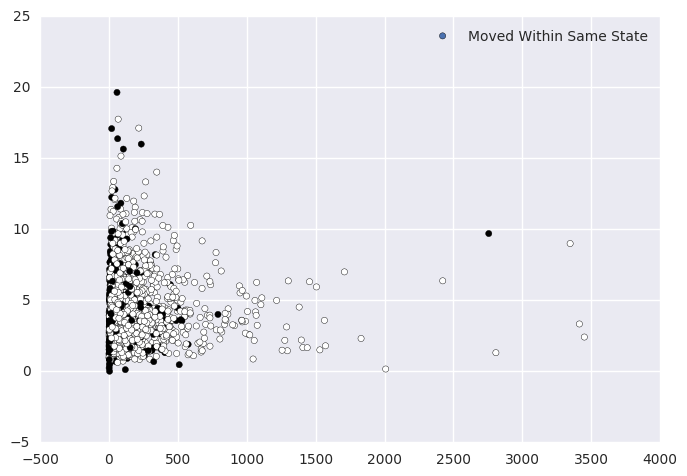

('Median Income Born In State', 'Same house 1 year ago White')


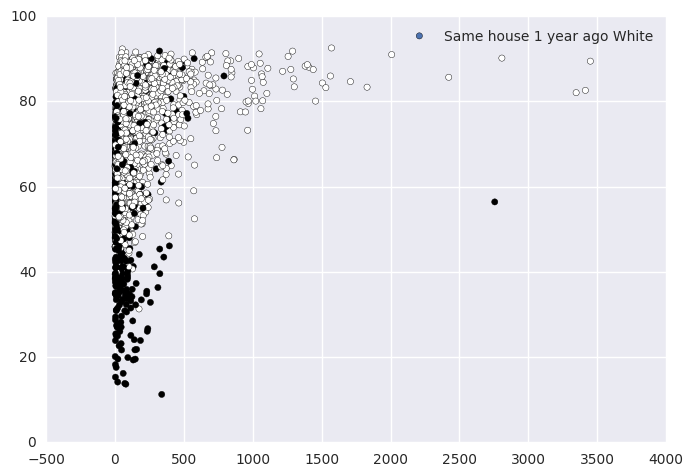

('Median Income Born In State', 'Walked')


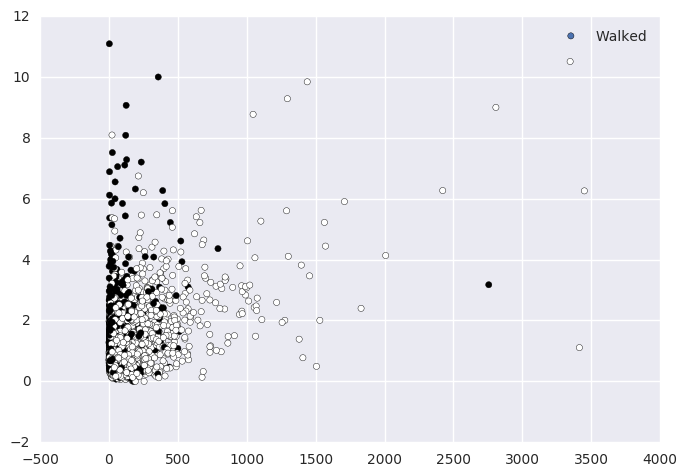

('Median Income Born In State', 'Work outside County')


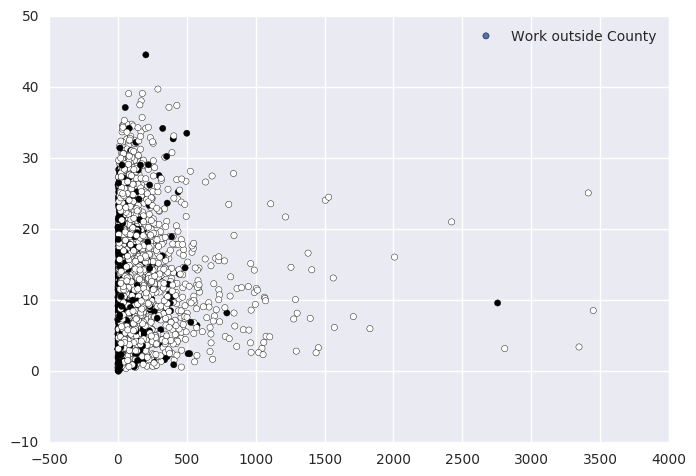

('Median Income Born In State', 'Work outside State')


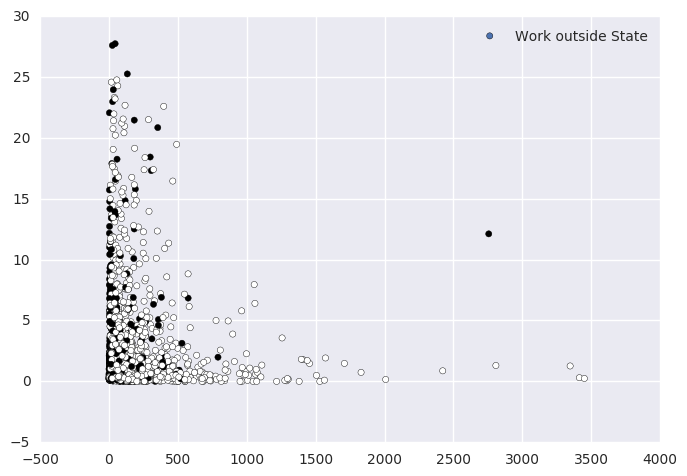

('Median Income Born In State', '2 vehicles')


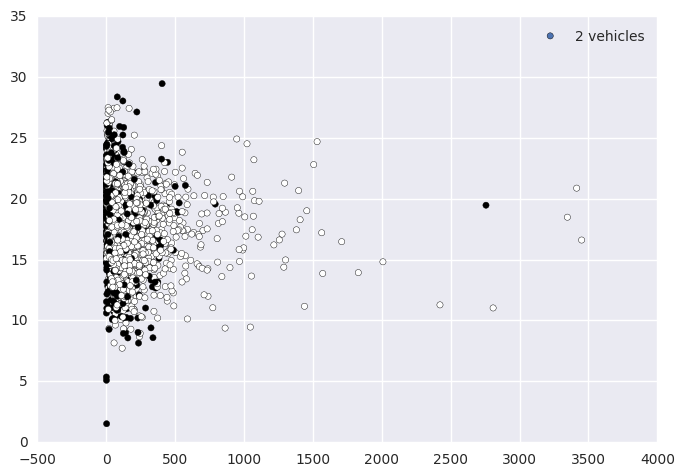

('Median Income Born Other State', 'Median Income Born Outside US: Native')


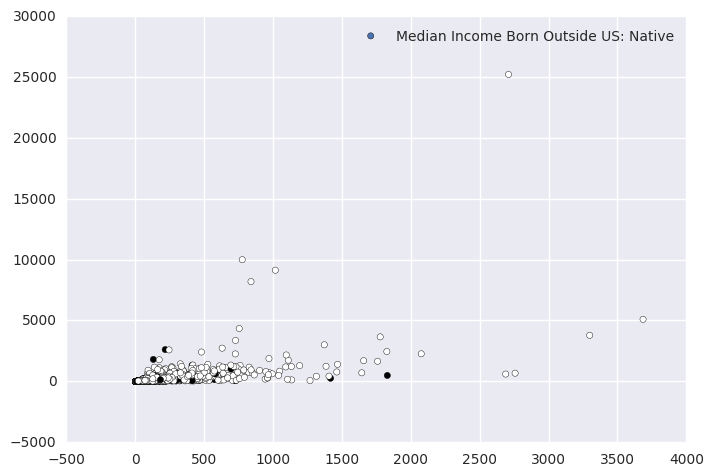

('Median Income Born Other State', 'Median Income Foreign Born')


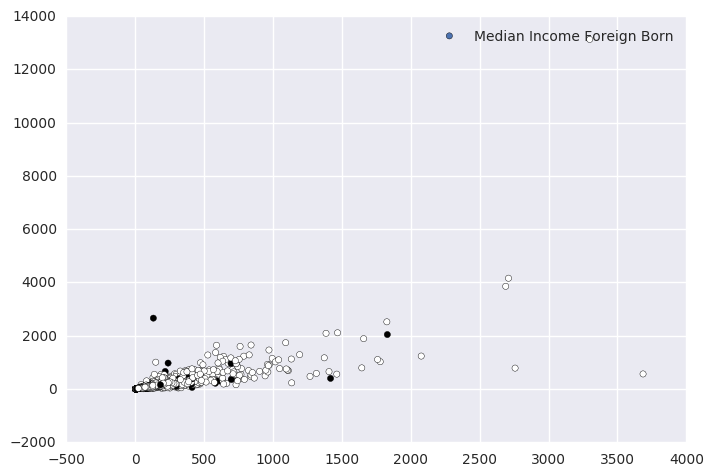

('Median Income Born Other State', '100% below povery line')


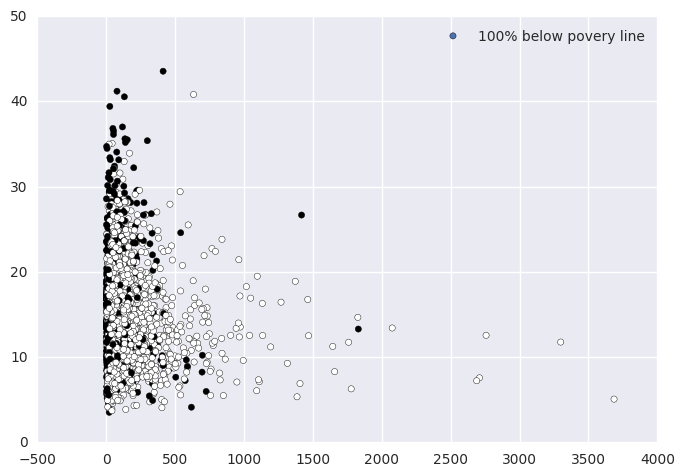

('Median Income Born Other State', 'Same house 1 year ago')


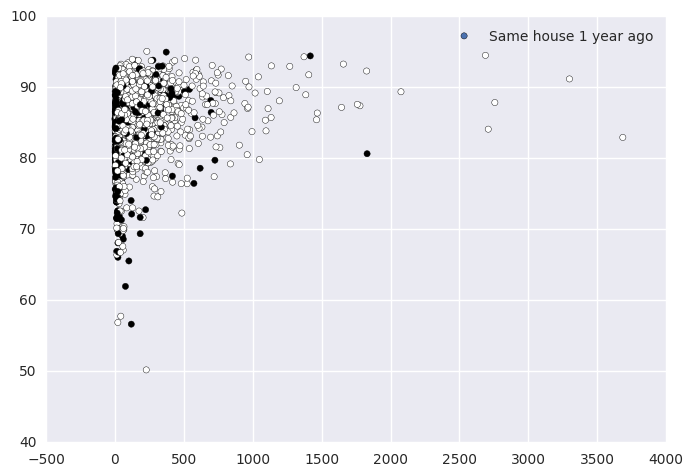

('Median Income Born Other State', 'Moved Within Same State')


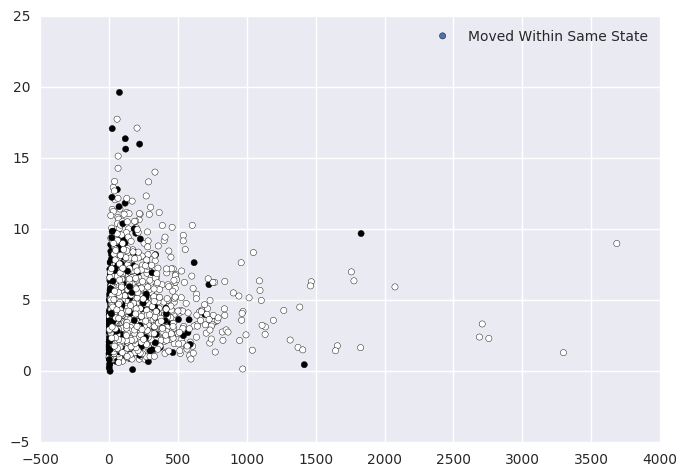

('Median Income Born Other State', 'Same house 1 year ago White')


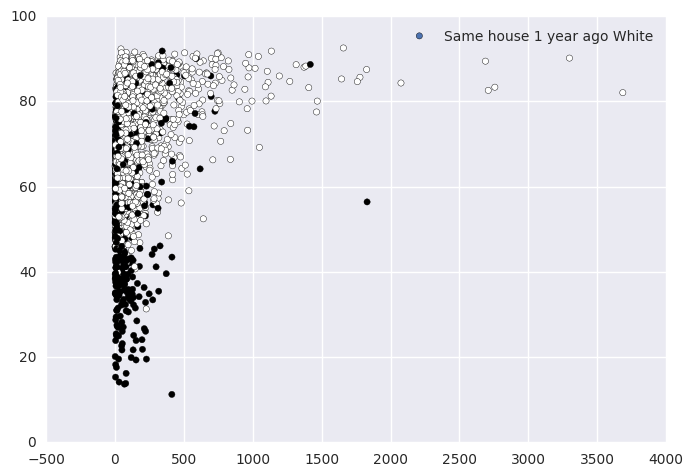

('Median Income Born Other State', 'Walked')


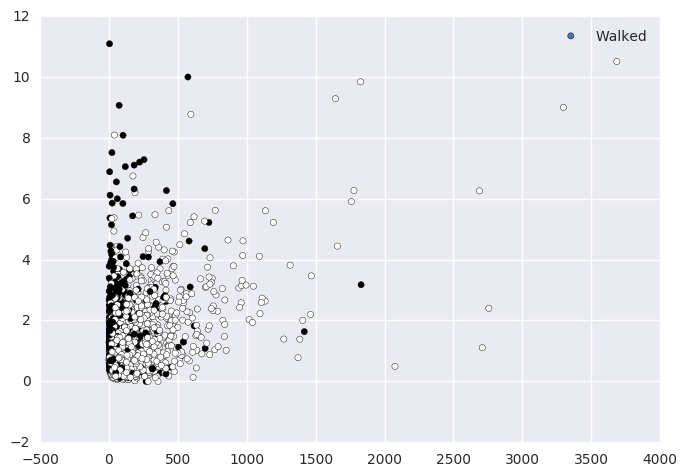

('Median Income Born Other State', 'Work outside County')


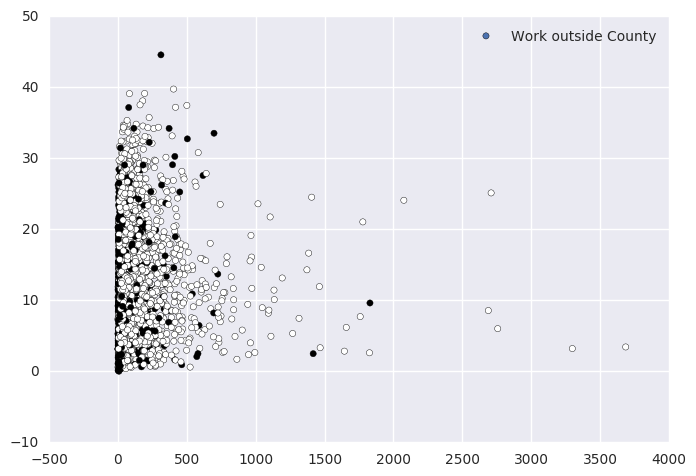

('Median Income Born Other State', 'Work outside State')


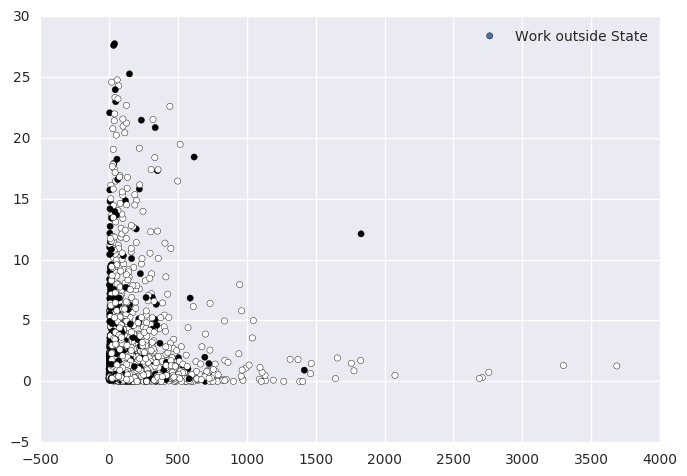

('Median Income Born Other State', '2 vehicles')


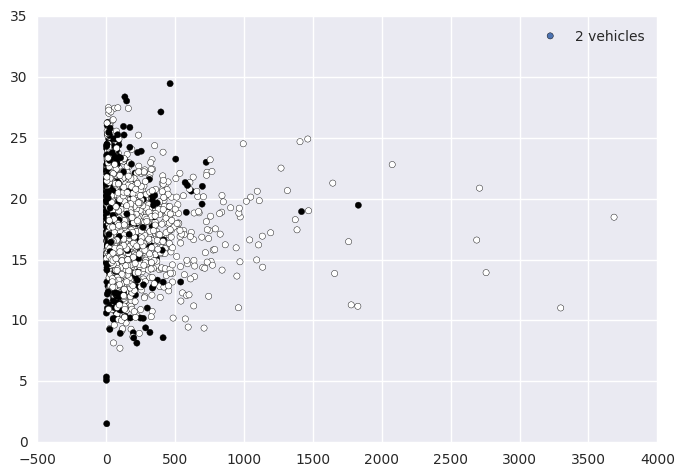

('Median Income Born Outside US: Native', 'Median Income Foreign Born')


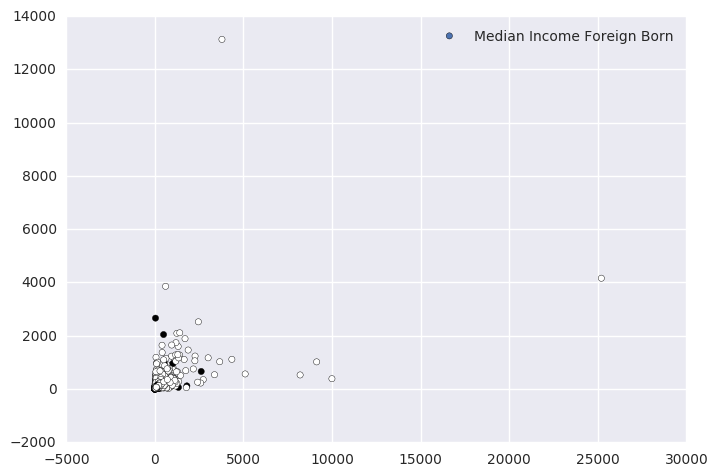

('Median Income Born Outside US: Native', '100% below povery line')


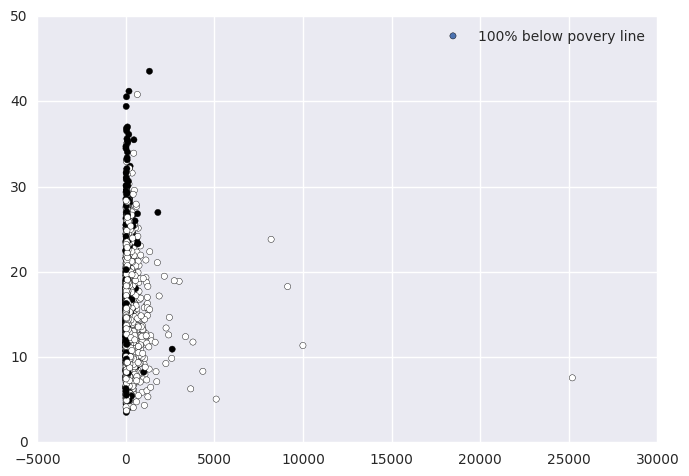

('Median Income Born Outside US: Native', 'Same house 1 year ago')


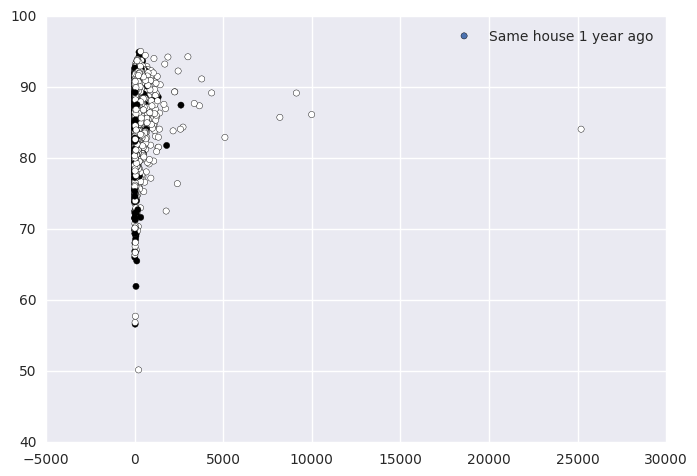

('Median Income Born Outside US: Native', 'Moved Within Same State')


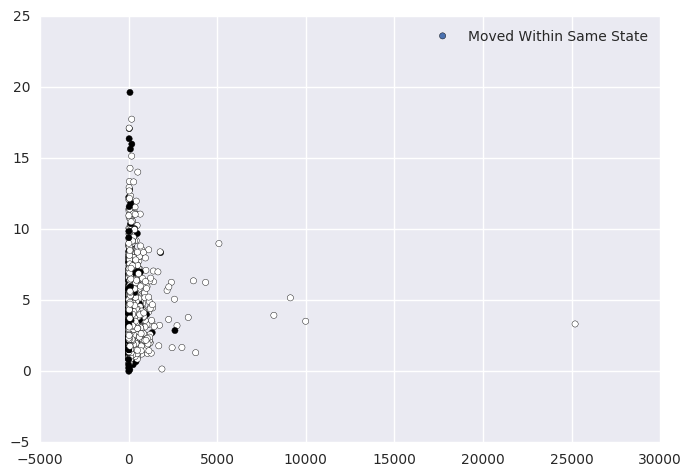

('Median Income Born Outside US: Native', 'Same house 1 year ago White')


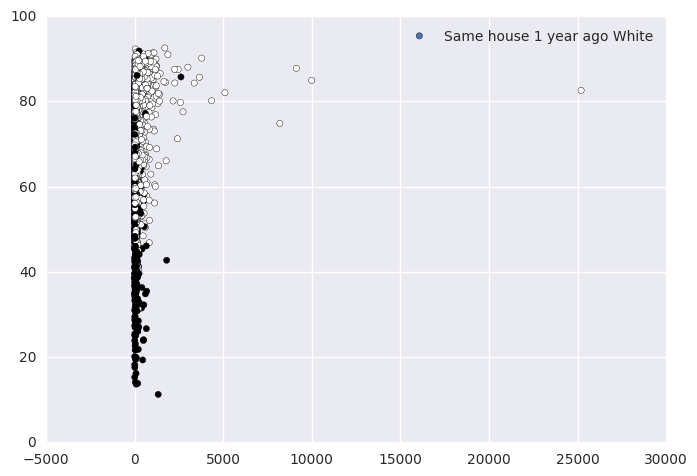

('Median Income Born Outside US: Native', 'Walked')


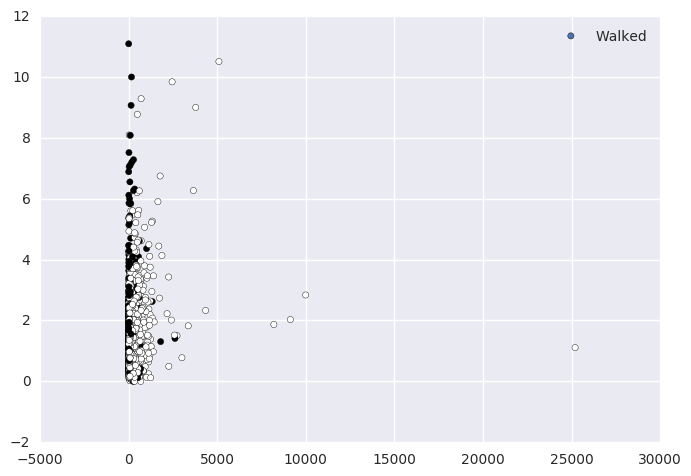

('Median Income Born Outside US: Native', 'Work outside County')


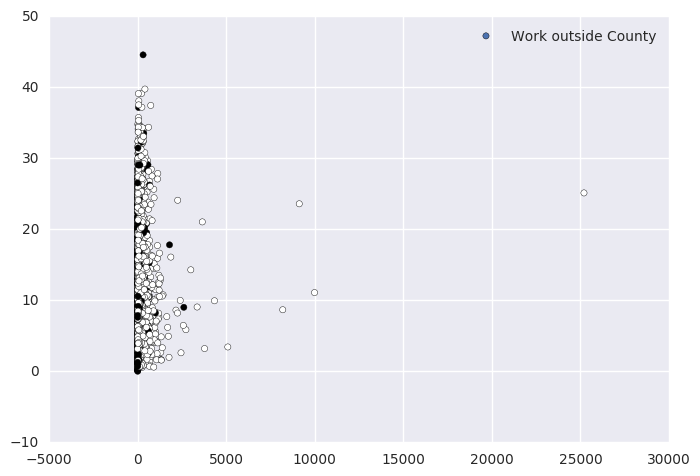

('Median Income Born Outside US: Native', 'Work outside State')


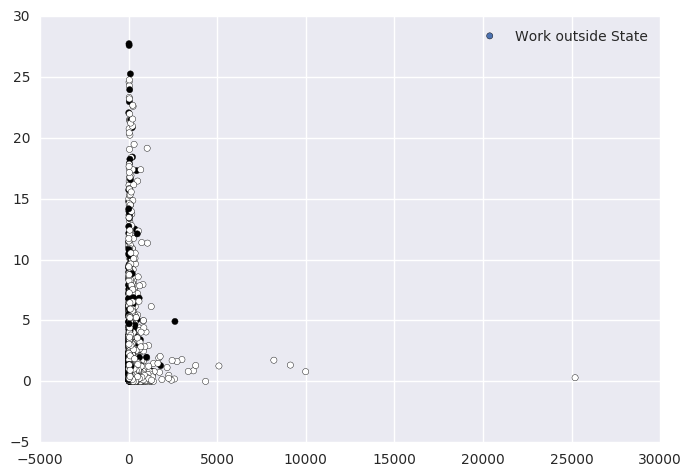

('Median Income Born Outside US: Native', '2 vehicles')


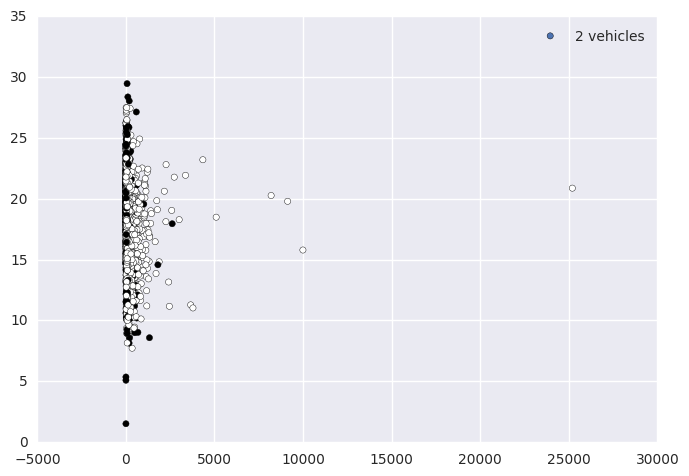

('Median Income Foreign Born', '100% below povery line')


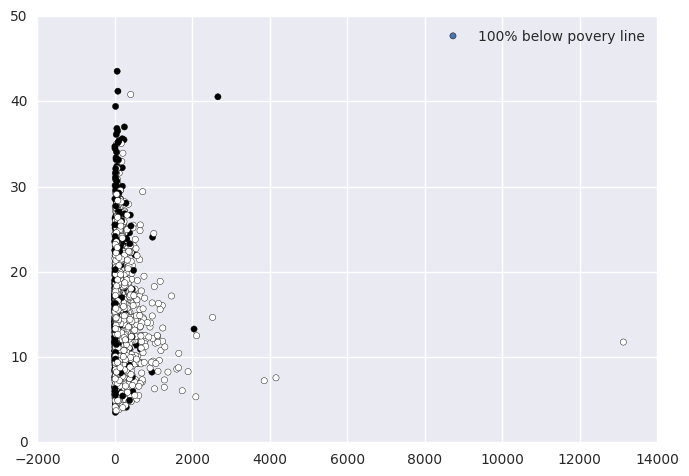

('Median Income Foreign Born', 'Same house 1 year ago')


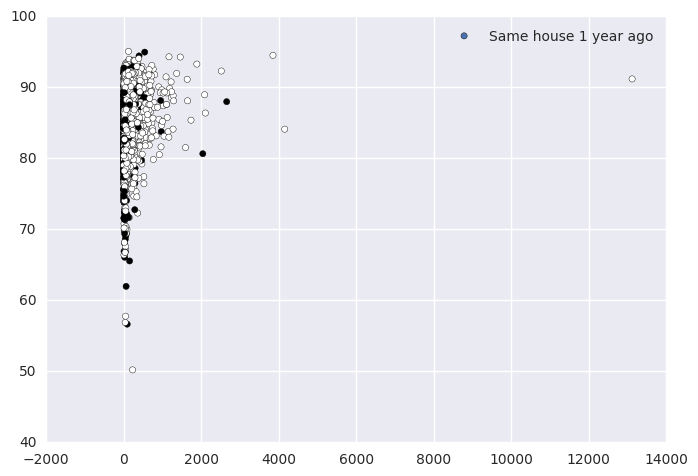

('Median Income Foreign Born', 'Moved Within Same State')


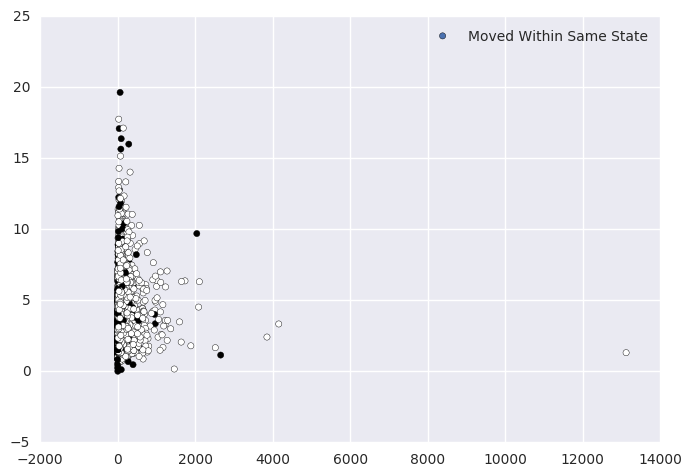

('Median Income Foreign Born', 'Same house 1 year ago White')


KeyboardInterrupt: 

In [398]:
for var in selected:
    print(var)
    plt.scatter(X[var[0]],X[var[1]], c = y)
    plt.legend()
    plt.show()

### Fitting Classification Techniques

In [614]:
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
import warnings
from sklearn.metrics import confusion_matrix
import seaborn as sn
from sklearn import metrics
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import VotingClassifier
warnings.filterwarnings('ignore')

In [675]:
def fitClassifiers(df, x_list, y, classifiers, classifierNames):
    overall_max = [list(x_list)[0], classifierNames[0], 0, []]
    
    if type(y) == pd.DataFrame:
        categories = y.ix[:, 0].unique()
    else:
        categories = y.unique()
   
    categories.sort()

    for x in x_list:
        X = df[list(x)]
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=42)
        #print(list(x))
        local_max = [list(x), classifierNames[0], 0]
        for name, classifier in zip(classifierNames, classifiers):
            classifier.fit(X_train, y_train)
            score = classifier.score(X_test, y_test)
            if score > local_max[2]:
                y_pred = classifier.predict(X_test)
                local_max = [list(x), name, score, confusion_matrix(y_test, y_pred, labels=categories)]
            print(name, score)
        if local_max[2] > overall_max[2]:
            overall_max = local_max
            
    print("Best is: " , overall_max[1:3])
    
    print(overall_max[3])
    df_cm = pd.DataFrame(overall_max[3], index = [i for i in categories],
            columns = [i for i in categories])
    plt.figure(figsize = (10,7))
    sn.heatmap(df_cm, annot=True)
    plt.show()

Classifier with selected variables

KNN 0.807142857143
SVM 0.775
Decision Tree 0.817857142857
Random Forest 0.805357142857
Multi-layer Perception 0.848214285714
Ada Boost 0.855357142857
Gaussian 0.801785714286
Best is:  ['Ada Boost', 0.85535714285714282]
[[409  25]
 [ 56  70]]


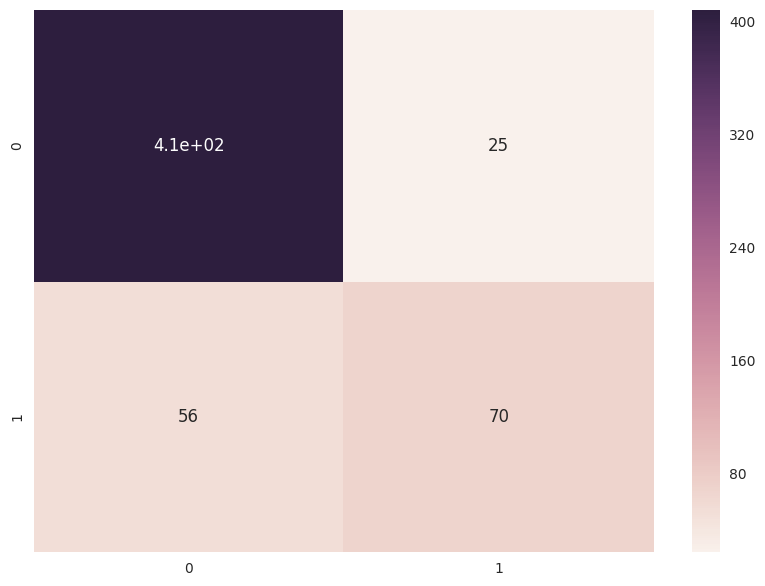

In [676]:
y_given = pd.DataFrame(y)
x_vars = [list(X[selectedVariables].columns)]

cityClassifiers = [
    KNeighborsClassifier(2),
    SVC(gamma=2, C=1),
    DecisionTreeClassifier(max_features='log2', max_depth=2),
    RandomForestClassifier(n_estimators=2, max_depth=10),
    MLPClassifier(alpha=1),
    AdaBoostClassifier(),
    GaussianNB()
]

cityClassifiersName = [
    "KNN",
    "SVM",
    "Decision Tree",
    "Random Forest",
    "Multi-layer Perception",
    "Ada Boost",
    "Gaussian"
]

fitClassifiers(X, x_vars, y_given, cityClassifiers, cityClassifiersName)

Classifier using all variables

In [410]:
y_given = pd.DataFrame(y)
x_vars = [list(X.columns)]

cityClassifiers = [
    KNeighborsClassifier(2),
    SVC(gamma=2, C=1),
    DecisionTreeClassifier(max_features='log2', max_depth=2),
    RandomForestClassifier(n_estimators=2, max_depth=10),
    MLPClassifier(alpha=1, hidden_layer_sizes=100, activation='logistic',
                  solver='lbfgs', learning_rate='adaptive', max_iter=1000),
    AdaBoostClassifier(),
    GaussianNB()
]

cityClassifiersName = [
    "KNN",
    "SVM",
    "Decision Tree",
    "Random Forest",
    "Multi-layer Perception",
    "Ada Boost",
    "Gaussian"
]

fitClassifiers(X, x_vars, y_given, cityClassifiers, cityClassifiersName)

KNN 0.828571428571
SVM 0.775
Decision Tree 0.821428571429
Random Forest 0.823214285714
Multi-layer Perception 0.885714285714
Ada Boost 0.864285714286
Gaussian 0.803571428571
Best is:  ['Multi-layer Perception', 0.88571428571428568]


Fitting 2012 data

In [696]:
mlp = MLPClassifier(alpha=1, hidden_layer_sizes=100, activation='logistic',
                  solver='lbfgs', learning_rate='adaptive', max_iter=1000)

In [697]:
mlp.fit(X_2012, y_2012)

MLPClassifier(activation='logistic', alpha=1, batch_size='auto', beta_1=0.9,
       beta_2=0.999, early_stopping=False, epsilon=1e-08,
       hidden_layer_sizes=100, learning_rate='adaptive',
       learning_rate_init=0.001, max_iter=1000, momentum=0.9,
       nesterovs_momentum=True, power_t=0.5, random_state=None,
       shuffle=True, solver='lbfgs', tol=0.0001, validation_fraction=0.1,
       verbose=False, warm_start=False)

In [698]:
mlp.score(X_2012, y_2012)

0.97464285714285714

In [615]:
scores = cross_val_score(mlp, X_2012, y_2012, cv=5, scoring='f1_macro')

In [617]:
np.mean(scores)

0.81662795064741489

In [612]:
mlp.score(X_2014, y_2014)

0.8904109589041096

In [699]:
f2012_2014 = data[['fips_code']]

In [700]:
f2012_2014['Actual 2012'] = y_2012

In [701]:
f2012_2014['Predicted 2012'] = mlp.predict(X_2012)

In [702]:
f2014 = data2014[['fips_code']]
f2014['Actual 2016'] = y_2014
f2014['Predicted 2016'] = mlp.predict(X_2014)

In [703]:
final2012_2014 = pd.merge(f2012_2014, f2014, on='fips_code')

In [714]:
mis_classified_counties = final2012_2014[final2012_2014['Actual 2016'] != final2012_2014['Predicted 2016']]['fips_code']

In [715]:
mis_classified_counties=data[data['fips_code'].isin(mis_classified_counties)]

In [718]:
states = pd.merge(mis_classified_counties, fips, on='fips_code')

In [726]:
states['ST'] = states['ST'].astype('int')

In [789]:
states['NAME'].value_counts()

Minnesota         31
Wisconsin         29
New York          22
Iowa              20
Michigan          13
Illinois          12
North Carolina    12
California        10
Virginia           8
Florida            8
South Carolina     8
Pennsylvania       8
Ohio               8
Maine              7
Nebraska           6
Montana            6
Texas              6
Colorado           6
Indiana            5
Louisiana          4
Georgia            4
Alabama            4
New Hampshire      4
New Mexico         4
Washington         4
South Dakota       4
Mississippi        3
New Jersey         3
Utah               3
Maryland           2
West Virginia      2
Kentucky           2
Kansas             2
Connecticut        2
Vermont            1
Delaware           1
Oregon             1
Rhode Island       1
Missouri           1
Oklahoma           1
North Dakota       1
Wyoming            1
Name: NAME, dtype: int64

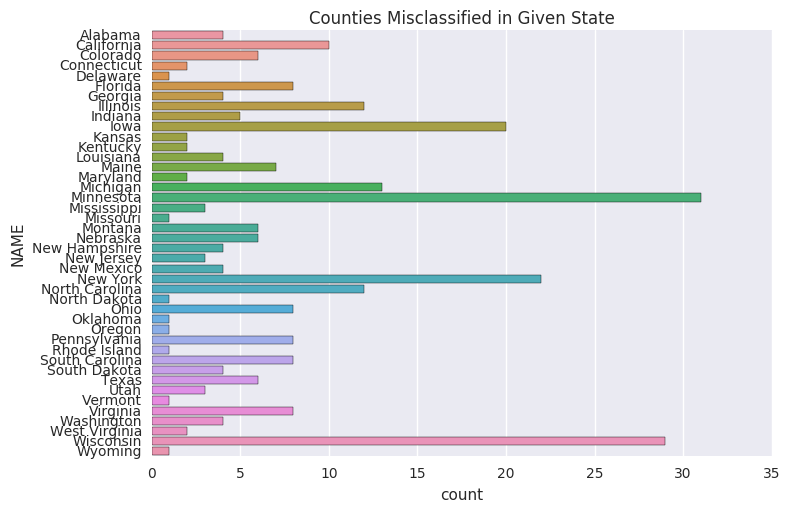

In [787]:
sns.countplot(y=states['NAME'])
plt.title("Counties Misclassified in Given State")
plt.show()

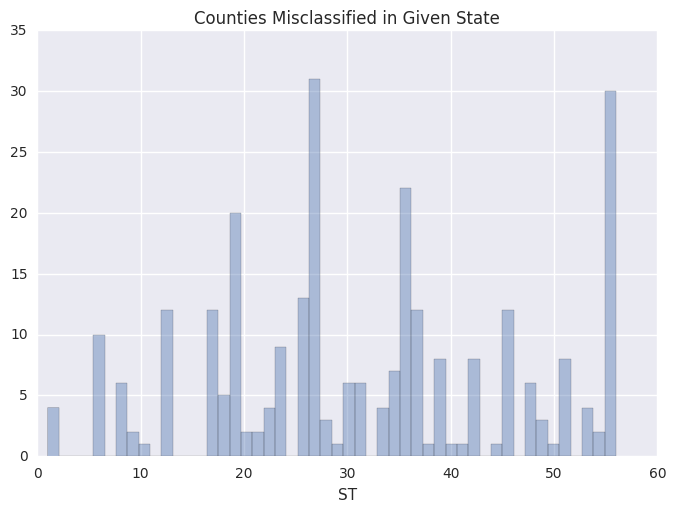

In [759]:
sns.distplot(states['ST'],bins=50, kde=False)
plt.title("Counties Misclassified in Given State")
plt.show()

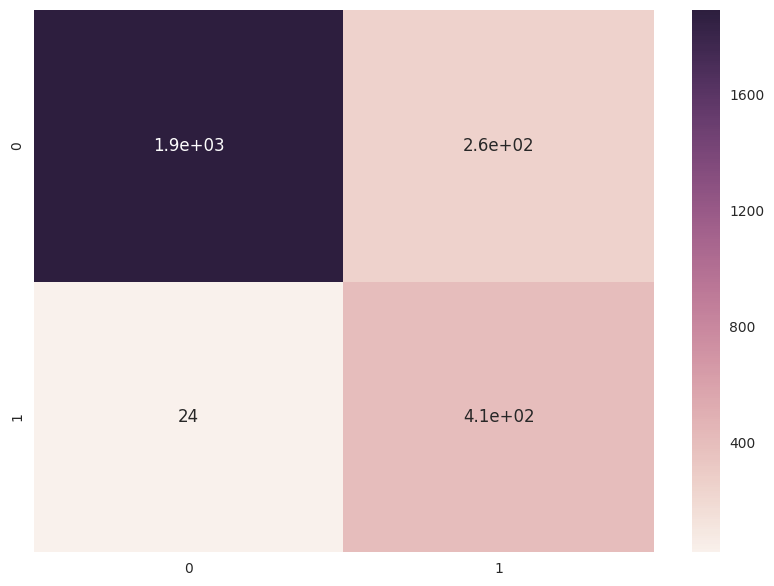

In [712]:
cm = confusion_matrix(final2012_2014['Actual 2016'], final2012_2014['Predicted 2016'], labels=[0,1])
df_cm = pd.DataFrame(cm, index = [0,1],
            columns = [0,1])
plt.figure(figsize = (10,7))
sn.heatmap(df_cm, annot=True)
plt.show()

In [829]:
f = open("state-fips.p", "rb")
fips = pickle.load(f)

FileNotFoundError: [Errno 2] No such file or directory: 'state-fips.p'

In [459]:
import pickle

In [440]:
f = open("./graph12-16.p", "wb")
pickle.dump(final2012_2014, f)

Fitting 2014 data points

In [618]:
mlp = MLPClassifier(alpha=1, hidden_layer_sizes=100, activation='logistic',
                  solver='lbfgs', learning_rate='adaptive', max_iter=1000)

In [619]:
mlp.fit(X_2014, y_2014)

MLPClassifier(activation='logistic', alpha=1, batch_size='auto', beta_1=0.9,
       beta_2=0.999, early_stopping=False, epsilon=1e-08,
       hidden_layer_sizes=100, learning_rate='adaptive',
       learning_rate_init=0.001, max_iter=1000, momentum=0.9,
       nesterovs_momentum=True, power_t=0.5, random_state=None,
       shuffle=True, solver='lbfgs', tol=0.0001, validation_fraction=0.1,
       verbose=False, warm_start=False)

In [452]:
mlp.score(X_2014, y_2014)

0.99315068493150682

In [453]:
mlp.score(X_2012, y_2012)

0.89571428571428569

In [620]:
scores = cross_val_score(mlp, X_2014, y_2014, cv=5, scoring='f1_macro')
print(np.average(scores))

0.887432596865


In [460]:
f = open("./graph16-12.p", "wb")
pickle.dump(final2012_2014, f)